In [14]:
### Load relevant libraries

import pandas as pd
import numpy as np
import json 
from collections import defaultdict
from IPython.display import Image, display, HTML
import fitz
import os
import sys
import krippendorff
from itertools import combinations
import random

## 1) Quantitative Analysis

### 1) Load all experimental results


In [15]:
### Set the file paths for the relevant files (results.json, confusion.png, predictions.csv) for all runs within all DEFAME Variants

### 1) DEFAME Variant: summary_dynamic_default

defame_default_path_run1_json = "../../model_results/ukraine_russia/summary_dynamic_default/run1/DEFAME_output/2025-08-23_11-29 default/results.json"
defame_default_path_run1_cm = "../../model_results/ukraine_russia/summary_dynamic_default/run1/DEFAME_output/2025-08-23_11-29 default/confusion.png"
defame_default_path_run1_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_default/run1/DEFAME_output/2025-08-23_11-29 default/predictions.csv"

defame_default_path_run2_json = "../../model_results/ukraine_russia/summary_dynamic_default/run2/DEFAME_output/2025-08-23_12-46 default/results.json"
defame_default_path_run2_cm = "../../model_results/ukraine_russia/summary_dynamic_default/run2/DEFAME_output/2025-08-23_12-46 default/confusion.png"
defame_default_path_run2_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_default/run2/DEFAME_output/2025-08-23_12-46 default/predictions.csv"

defame_default_path_run3_json = "../../model_results/ukraine_russia/summary_dynamic_default/run3/DEFAME_output/2025-08-29_20-28 default/results.json"
defame_default_path_run3_cm = "../../model_results/ukraine_russia/summary_dynamic_default/run3/DEFAME_output/2025-08-29_20-28 default/confusion.png"
defame_default_path_run3_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_default/run3/DEFAME_output/2025-08-29_20-28 default/predictions.csv"


### 2) DEFAME Variant: summary_dynamic_no_geolocate

defame_no_geolocate_path_run1_json = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run1/DEFAME_output/2025-08-31_17-37 no_geolocate/results.json"
defame_no_geolocate_path_run1_cm = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run1/DEFAME_output/2025-08-31_17-37 no_geolocate/confusion.png"
defame_no_geolocate_path_run1_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run1/DEFAME_output/2025-08-31_17-37 no_geolocate/predictions.csv"


defame_no_geolocate_path_run2_json = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run2/DEFAME_output/2025-08-31_18-27 no_geolocate/results.json"
defame_no_geolocate_path_run2_cm = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run2/DEFAME_output/2025-08-31_18-27 no_geolocate/confusion.png"
defame_no_geolocate_path_run2_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run2/DEFAME_output/2025-08-31_18-27 no_geolocate/predictions.csv"

defame_no_geolocate_path_run3_json = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run3/DEFAME_output/2025-08-31_19-34 no_geolocate/results.json"
defame_no_geolocate_path_run3_cm = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run3/DEFAME_output/2025-08-31_19-34 no_geolocate/confusion.png"
defame_no_geolocate_path_run3_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run3/DEFAME_output/2025-08-31_19-34 no_geolocate/predictions.csv"


### 3) DEFAME Variant: summary_dynamic_no_image_search

defame_no_image_search_path_run1_json = "../../model_results/ukraine_russia/summary_dynamic_no_image_search/run1/DEFAME_output/2025-08-30_21-34 no_image_search/results.json"
defame_no_image_search_path_run1_cm = "../../model_results/ukraine_russia/summary_dynamic_no_image_search/run1/DEFAME_output/2025-08-30_21-34 no_image_search/confusion.png"
defame_no_image_search_path_run1_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_no_image_search/run1/DEFAME_output/2025-08-30_21-34 no_image_search/predictions.csv"

defame_no_image_search_path_run2_json = "../../model_results/ukraine_russia/summary_dynamic_no_image_search/run2/DEFAME_output/2025-08-30_22-06 no_image_search/results.json"
defame_no_image_search_path_run2_cm = "../../model_results/ukraine_russia/summary_dynamic_no_image_search/run2/DEFAME_output/2025-08-30_22-06 no_image_search/confusion.png"
defame_no_image_search_path_run2_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_no_image_search/run2/DEFAME_output/2025-08-30_22-06 no_image_search/predictions.csv"

defame_no_image_search_path_run3_json = "../../model_results/ukraine_russia/summary_dynamic_no_image_search/run3/DEFAME_output/2025-08-30_22-40 no_image_search/results.json"
defame_no_image_search_path_run3_cm = "../../model_results/ukraine_russia/summary_dynamic_no_image_search/run3/DEFAME_output/2025-08-30_22-40 no_image_search/confusion.png"
defame_no_image_search_path_run3_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_no_image_search/run3/DEFAME_output/2025-08-30_22-40 no_image_search/predictions.csv"


### 4) DEFAME Variant: summary_dynamic_no_ris

defame_no_ris_path_run1_json = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run1/DEFAME_output/2025-08-30_07-40 no_ris/results.json"
defame_no_ris_path_run1_cm = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run1/DEFAME_output/2025-08-30_07-40 no_ris/confusion.png"
defame_no_ris_path_run1_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run1/DEFAME_output/2025-08-30_07-40 no_ris/predictions.csv"

defame_no_ris_path_run2_json = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run2/DEFAME_output/2025-08-30_08-08 no_ris/results.json"
defame_no_ris_path_run2_cm = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run2/DEFAME_output/2025-08-30_08-08 no_ris/confusion.png"
defame_no_ris_path_run2_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run2/DEFAME_output/2025-08-30_08-08 no_ris/predictions.csv"

defame_no_ris_path_run3_json = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run3/DEFAME_output/2025-08-30_08-46 no_ris/results.json"
defame_no_ris_path_run3_cm = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run3/DEFAME_output/2025-08-30_08-46 no_ris/confusion.png"
defame_no_ris_path_run3_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run3/DEFAME_output/2025-08-30_08-46 no_ris/predictions.csv"

### 5) DEFAME Variant: summary_dynamic_no_web_search

defame_no_web_search_path_run1_json = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run1/DEFAME_output/2025-08-29_22-35 no_web_search/results.json"
defame_no_web_search_path_run1_cm = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run1/DEFAME_output/2025-08-29_22-35 no_web_search/confusion.png"
defame_no_web_search_path_run1_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run1/DEFAME_output/2025-08-29_22-35 no_web_search/predictions.csv"

defame_no_web_search_path_run2_json = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run2/DEFAME_output/2025-08-29_22-57 no_web_search/results.json"
defame_no_web_search_path_run2_cm = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run2/DEFAME_output/2025-08-29_22-57 no_web_search/confusion.png"
defame_no_web_search_path_run2_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run2/DEFAME_output/2025-08-29_22-57 no_web_search/predictions.csv"

defame_no_web_search_path_run3_json = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run3/DEFAME_output/2025-08-29_23-19 no_web_search/results.json"
defame_no_web_search_path_run3_cm = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run3/DEFAME_output/2025-08-29_23-19 no_web_search/confusion.png"
defame_no_web_search_path_run3_predictions_csv = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run3/DEFAME_output/2025-08-29_23-19 no_web_search/predictions.csv"

In [16]:
### Write a function to read all results.json files for each DEFAME variant 

def load_all_results_json_per_defame_variant(defame_variant: str) -> dict:

    """ 
    This function loads all results.json files for all runs for each DEFAME variant.

    Input: The used DEFAME variant (e.g., 'defame_default', 'defame_no_geolocate', etc.)

    Output: A dictionary with the results.json content for all runs
    
    """

    json_var_names = [
        f"{defame_variant}_path_run1_json",
        f"{defame_variant}_path_run2_json",
        f"{defame_variant}_path_run3_json",
    ]

    list_json_paths = []
    for var_name in json_var_names:
        if var_name in globals():
            list_json_paths.append(globals()[var_name])
        else:
            print(f"Warning: Path {var_name} not found in global scope")

    if not list_json_paths:
        raise ValueError(f"No valid file paths found for variant: {defame_variant}")
    
    # Create empty dict to load all json files
    all_json_data = {}

    for i, path in enumerate(list_json_paths, 1):
        try:
            with(open(path, "r")) as file:
                run_key = f"{defame_variant}_run{i}"
                all_json_data[run_key] = json.load(file)
        except FileNotFoundError:
            print(f"Warning: File not found - {path}")
        except json.JSONDecodeError:
            print(f"Warning: Invalid JSON in file - {path}")
        except Exception as e:
            print(f"Error loading {path}: {str(e)}")

    
    return all_json_data


In [17]:
## Write a function to read/load all confusion.png files for each DEFAME variant

def load_all_cm_images_per_defame_variant(defame_variant: str):

    """
    This function loads and displays all confusion matrix images for all runs for each DEFAME variant.

    Input: The used DEFAME variant (e.g., 'defame_default', 'defame_no_geolocate', etc.)
    Output: Displays all confusion matrix images for the specified variant
    """

    png_var_names = [
        f"{defame_variant}_path_run1_cm",
        f"{defame_variant}_path_run2_cm",
        f"{defame_variant}_path_run3_cm",
    ]

    list_png_paths = []
    for var_name in png_var_names:
        if var_name in globals():
            list_png_paths.append(globals()[var_name])
        else:
            print(f"Warning: Path {var_name} not found in global scope")

    if not list_png_paths:
        raise ValueError(f"No valid file paths found for variant: {defame_variant}")
    

    # Load and display all confusion matrix images
    for i, path in enumerate(list_png_paths, 1):
        try:
           # print(f"Confusion Matrix - {defame_variant} Run {i}:")
            fig = Image(filename=path)
            display(fig)
            #print(f"Successfully displayed: {defame_variant}_run{i}")
            #print("-" * 50)  # Separator between images
        except FileNotFoundError:
            print(f"Warning: File not found - {path}")
        except Exception as e:
            print(f"Error loading image {path}: {str(e)}")

In [18]:
## Write a function to read/load all predictions.csv files for each DEFAME variant

def load_all_predictions_csv_per_defame_variant(defame_variant: str) -> dict:

    """
    This function loads all predictions CSV files for all runs for each DEFAME variant.

    Input: The used DEFAME variant (e.g., 'defame_default', 'defame_no_geolocate', etc.)
    Output: A dictionary with pandas DataFrames for all predictions CSV files
    """

    csv_var_names = [
        f"{defame_variant}_path_run1_predictions_csv",
        f"{defame_variant}_path_run2_predictions_csv",
        f"{defame_variant}_path_run3_predictions_csv",
    ]

    list_csv_paths = []
    for var_name in csv_var_names:
        if var_name in globals():
            list_csv_paths.append(globals()[var_name])
        else:
            print(f"Warning: Path {var_name} not found in global scope")

    if not list_csv_paths:
        raise ValueError(f"No valid file paths found for variant: {defame_variant}")
    

    # Load all CSV files into DataFrames
    all_predictions = {}
    
    for i, path in enumerate(list_csv_paths, 1):
        try:
            run_key = f"{defame_variant}_predictions_run{i}"
            all_predictions[run_key] = pd.read_csv(path)
            print(f"Successfully loaded: {run_key} with shape {all_predictions[run_key].shape}")
        except FileNotFoundError:
            print(f"Warning: File not found - {path}")
        except pd.errors.EmptyDataError:
            print(f"Warning: Empty CSV file - {path}")
        except Exception as e:
            print(f"Error loading CSV {path}: {str(e)}")
    
    return all_predictions

In [19]:
defame_variants = ["defame_default", "defame_no_geolocate", "defame_no_image_search", "defame_no_ris", "defame_no_web_search"]

# Store all results in a dictionary
all_defame_variants_json_results = {}

for defame_variant in defame_variants:
    all_defame_variants_json_results[f"{defame_variant}_results_json"] = load_all_results_json_per_defame_variant(defame_variant=defame_variant)

# Access the results
print("Available keys:", list(all_defame_variants_json_results.keys()))

Available keys: ['defame_default_results_json', 'defame_no_geolocate_results_json', 'defame_no_image_search_results_json', 'defame_no_ris_results_json', 'defame_no_web_search_results_json']


### 2) Dataset-Level Metrics (Descriptive Statistics)


#### 2.1) Metrics from results.json files

In [20]:
### Write a function to extract all data-level metrics for each run per defame variant

def extract_convert_describe_all_dataset_level_metrics_per_defame_variant(json_results_dict : dict):

    """
    Extract, convert, and describe all dataset-level metrics for each run per DEFAME variant.
    
    Input: 
       -  json_results_dict: Dictionary containing JSON results from load_all_results_json_per_defame_variant()
       -  Keys are like 'defame_default_run1', 'defame_default_run2', etc.
    
    Output: 
        - df_descriptives: Descriptive statistics of the metrics
    """

    if not json_results_dict:
        raise ValueError("Input dictionary is empty")
    
    #  1) Extract dataset-level metrics for each run
    dataset_metrics = {}

    for run_key, run_data in json_results_dict.items():
        try:
            # Extract the run number from the key (e.g., 'defame_default_run1' -> 'run_1')
            run_number = run_key.split('_')[-1]  # Gets 'run1', 'run2', etc.
            clean_run_key = f"run_{run_number[-1]}"  # Converts to 'run_1', 'run_2', etc.
            
            # Extract dataset metrics
            dataset_metrics[clean_run_key] = run_data["Predictions"]["Dataset_Metrics"]
            print(f"Successfully extracted metrics for {clean_run_key}")
            
        except KeyError as e:
            print(f"Warning: Missing key {e} in {run_key}")
        except Exception as e:
            print(f"Error processing {run_key}: {str(e)}")
    
    if not dataset_metrics:
        raise ValueError("No dataset metrics could be extracted")
    
    # 2) Convert dictionary to pandas DataFrame
    df_metrics = pd.DataFrame.from_dict(dataset_metrics, orient="index")

    # 3) Generate descriptive statistics
    df_descriptives = df_metrics.describe()


    return df_descriptives



In [21]:
all_defame_variants_dataset_metrics = defaultdict()

# The final loop, corrected
for variant_key in all_defame_variants_json_results:
    # Get the dictionary of loaded JSONs for this variant
    variant_json_data = all_defame_variants_json_results[variant_key]
    
    # Pass that dictionary as the positional argument
    all_defame_variants_dataset_metrics[f"{variant_key}_dataset_metrics"] = \
        extract_convert_describe_all_dataset_level_metrics_per_defame_variant(variant_json_data)
    
print("Available keys:", list(all_defame_variants_dataset_metrics.keys()))

Successfully extracted metrics for run_1
Successfully extracted metrics for run_2
Successfully extracted metrics for run_3
Successfully extracted metrics for run_1
Successfully extracted metrics for run_2
Successfully extracted metrics for run_3
Successfully extracted metrics for run_1
Successfully extracted metrics for run_2
Successfully extracted metrics for run_3
Successfully extracted metrics for run_1
Successfully extracted metrics for run_2
Successfully extracted metrics for run_3
Successfully extracted metrics for run_1
Successfully extracted metrics for run_2
Successfully extracted metrics for run_3
Available keys: ['defame_default_results_json_dataset_metrics', 'defame_no_geolocate_results_json_dataset_metrics', 'defame_no_image_search_results_json_dataset_metrics', 'defame_no_ris_results_json_dataset_metrics', 'defame_no_web_search_results_json_dataset_metrics']


In [22]:
all_defame_variants_dataset_metrics

defaultdict(None,
            {'defame_default_results_json_dataset_metrics':            Total  Refused  Balanced_Accuracy  Matthew_Correlation_Coefficient  \
             count   3.000000      3.0           3.000000                         3.000000   
             mean   78.666667      0.0           0.860000                         0.600000   
             std     0.577350      0.0           0.036056                         0.065574   
             min    78.000000      0.0           0.830000                         0.540000   
             25%    78.500000      0.0           0.840000                         0.565000   
             50%    79.000000      0.0           0.850000                         0.590000   
             75%    79.000000      0.0           0.875000                         0.630000   
             max    79.000000      0.0           0.900000                         0.670000   
             
                    True_Negative_Rate_Specificity  Macro_Averaged_F1_Score

In [23]:
all_defame_variants_dataset_metrics['defame_default_results_json_dataset_metrics']

,Total,Refused,Balanced_Accuracy,Matthew_Correlation_Coefficient,True_Negative_Rate_Specificity,Macro_Averaged_F1_Score,Macro_Averaged_F0.5_Score,Correct_Predictions,Wrong_Predictions
count,3.000000,3.0,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
mean,78.666667,0.0,0.860000,0.600000,0.903333,0.786667,0.763333,70.333333,8.333333
std,0.577350,0.0,0.036056,0.065574,0.011547,0.035119,0.030551,1.154701,1.527525
min,78.000000,0.0,0.830000,0.540000,0.890000,0.750000,0.730000,69.000000,7.000000
25%,78.500000,0.0,0.840000,0.565000,0.900000,0.770000,0.750000,70.000000,7.500000
50%,79.000000,0.0,0.850000,0.590000,0.910000,0.790000,0.770000,71.000000,8.000000
75%,79.000000,0.0,0.875000,0.630000,0.910000,0.805000,0.780000,71.000000,9.000000
max,79.000000,0.0,0.900000,0.670000,0.910000,0.820000,0.790000,71.000000,10.000000


In [24]:
all_defame_variants_dataset_metrics['defame_no_geolocate_results_json_dataset_metrics']

,Total,Refused,Balanced_Accuracy,Matthew_Correlation_Coefficient,True_Negative_Rate_Specificity,Macro_Averaged_F1_Score,Macro_Averaged_F0.5_Score,Correct_Predictions,Wrong_Predictions
count,3.0,3.0,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
mean,79.0,0.0,0.913333,0.673333,0.903333,0.816667,0.786667,71.666667,7.333333
std,0.0,0.0,0.032146,0.035119,0.005774,0.015275,0.015275,0.577350,0.577350
min,79.0,0.0,0.890000,0.640000,0.900000,0.800000,0.770000,71.000000,7.000000
25%,79.0,0.0,0.895000,0.655000,0.900000,0.810000,0.780000,71.500000,7.000000
50%,79.0,0.0,0.900000,0.670000,0.900000,0.820000,0.790000,72.000000,7.000000
75%,79.0,0.0,0.925000,0.690000,0.905000,0.825000,0.795000,72.000000,7.500000
max,79.0,0.0,0.950000,0.710000,0.910000,0.830000,0.800000,72.000000,8.000000


In [25]:
all_defame_variants_dataset_metrics['defame_no_image_search_results_json_dataset_metrics']

,Total,Refused,Balanced_Accuracy,Matthew_Correlation_Coefficient,True_Negative_Rate_Specificity,Macro_Averaged_F1_Score,Macro_Averaged_F0.5_Score,Correct_Predictions,Wrong_Predictions
count,3.0,3.0,3.000000,3.000,3.000000,3.000000,3.000000,3.000000,3.000000
mean,78.0,0.0,0.850000,0.560,0.883333,0.766667,0.736667,68.333333,9.666667
std,1.0,0.0,0.036056,0.050,0.015275,0.025166,0.023094,1.527525,1.154701
min,77.0,0.0,0.820000,0.510,0.870000,0.740000,0.710000,67.000000,9.000000
25%,77.5,0.0,0.830000,0.535,0.875000,0.755000,0.730000,67.500000,9.000000
50%,78.0,0.0,0.840000,0.560,0.880000,0.770000,0.750000,68.000000,9.000000
75%,78.5,0.0,0.865000,0.585,0.890000,0.780000,0.750000,69.000000,10.000000
max,79.0,0.0,0.890000,0.610,0.900000,0.790000,0.750000,70.000000,11.000000


In [26]:
all_defame_variants_dataset_metrics['defame_no_ris_results_json_dataset_metrics']

,Total,Refused,Balanced_Accuracy,Matthew_Correlation_Coefficient,True_Negative_Rate_Specificity,Macro_Averaged_F1_Score,Macro_Averaged_F0.5_Score,Correct_Predictions,Wrong_Predictions
count,3.000000,3.0,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.0
mean,78.666667,0.0,0.870000,0.593333,0.890000,0.780000,0.750000,69.666667,9.0
std,0.577350,0.0,0.081854,0.098658,0.017321,0.034641,0.026458,1.527525,1.0
min,78.000000,0.0,0.780000,0.480000,0.870000,0.740000,0.720000,68.000000,8.0
25%,78.500000,0.0,0.835000,0.560000,0.885000,0.770000,0.740000,69.000000,8.5
50%,79.000000,0.0,0.890000,0.640000,0.900000,0.800000,0.760000,70.000000,9.0
75%,79.000000,0.0,0.915000,0.650000,0.900000,0.800000,0.765000,70.500000,9.5
max,79.000000,0.0,0.940000,0.660000,0.900000,0.800000,0.770000,71.000000,10.0


In [27]:
all_defame_variants_dataset_metrics['defame_no_web_search_results_json_dataset_metrics']

,Total,Refused,Balanced_Accuracy,Matthew_Correlation_Coefficient,True_Negative_Rate_Specificity,Macro_Averaged_F1_Score,Macro_Averaged_F0.5_Score,Correct_Predictions,Wrong_Predictions
count,3.000000,3.0,3.000,3.000,3.000000,3.000000,3.00,3.000000,3.0
mean,78.666667,0.0,0.630,0.280,0.926667,0.636667,0.64,67.666667,11.0
std,0.577350,0.0,0.010,0.030,0.015275,0.015275,0.02,0.577350,1.0
min,78.000000,0.0,0.620,0.250,0.910000,0.620000,0.62,67.000000,10.0
25%,78.500000,0.0,0.625,0.265,0.920000,0.630000,0.63,67.500000,10.5
50%,79.000000,0.0,0.630,0.280,0.930000,0.640000,0.64,68.000000,11.0
75%,79.000000,0.0,0.635,0.295,0.935000,0.645000,0.65,68.000000,11.5
max,79.000000,0.0,0.640,0.310,0.940000,0.650000,0.66,68.000000,12.0


Observations:


- Why is balanced accuracy and MCC so much lower on no_web_search variant?
    - looking at equations again
    - is it about distribution of false positives/negatives?
- Seems like no_geolocate variant performs very good, if not the best 
- No_web_search:
    - lowest number of correct predictions, but
    - highest TNR 
        - same pattern for gaza-israel dataset?
    - indicates that number of false positives is lower for this variant


#### 2.2) Metrics from confusion matrix (False Positives & Negatives)

##### 2.2.1) Load and store data

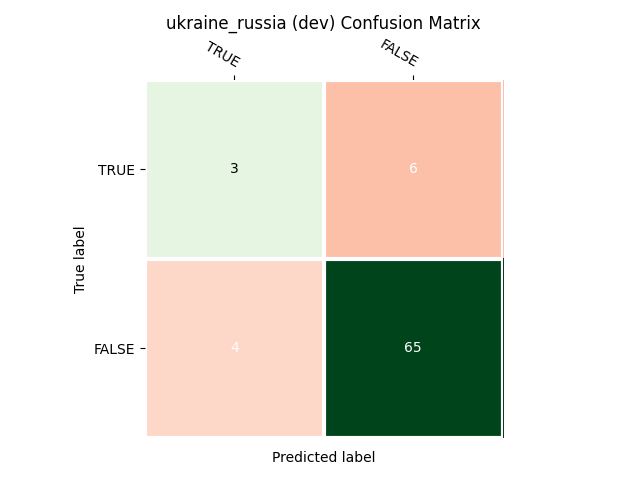

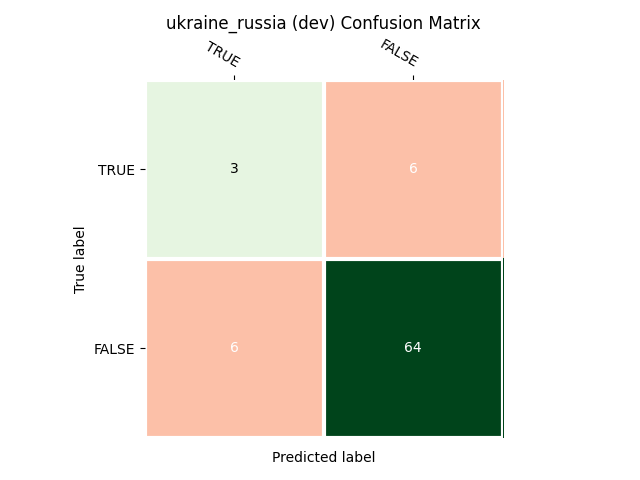

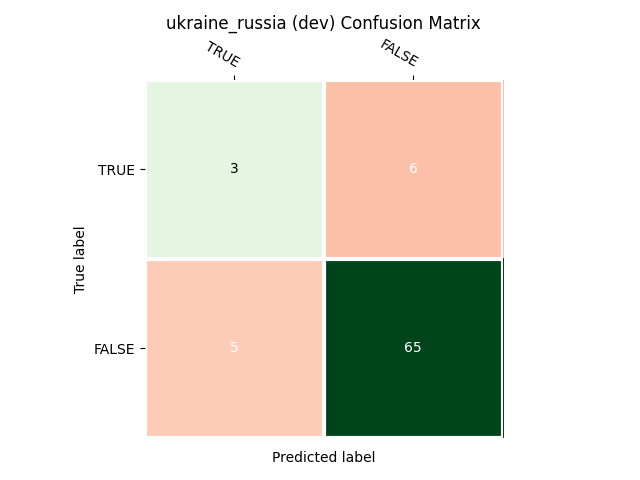

In [28]:
defame_variants = ["defame_default", "defame_no_geolocate", "defame_no_image_search", "defame_no_ris", "defame_no_web_search"]


#load_all_cm_images_per_defame_variant(defame_variant="defame_default")
#load_all_cm_images_per_defame_variant(defame_variant="defame_no_geolocate")
#load_all_cm_images_per_defame_variant(defame_variant="defame_no_image_search")
#load_all_cm_images_per_defame_variant(defame_variant="defame_no_ris")
load_all_cm_images_per_defame_variant(defame_variant="defame_no_web_search")




## Read and store number of false positives & negatives for each run for all DEFAME variant

### 1) DEFAME default

defame_default_cm_data = defaultdict(dict)

defame_default_cm_data["run_1"]["False_Positives"] = 8
defame_default_cm_data["run_1"]["False_Negatives"] = 2
defame_default_cm_data["run_2"]["False_Positives"] = 6
defame_default_cm_data["run_2"]["False_Negatives"] = 2
defame_default_cm_data["run_3"]["False_Positives"] = 6
defame_default_cm_data["run_3"]["False_Negatives"] = 1


### 2) DEFAME no_geolocate

defame_no_geolocate_cm_data = defaultdict(dict)

defame_no_geolocate_cm_data["run_1"]["False_Positives"] = 7
defame_no_geolocate_cm_data["run_1"]["False_Negatives"] = 1
defame_no_geolocate_cm_data["run_2"]["False_Positives"] = 6
defame_no_geolocate_cm_data["run_2"]["False_Negatives"] = 1
defame_no_geolocate_cm_data["run_3"]["False_Positives"] = 7
defame_no_geolocate_cm_data["run_3"]["False_Negatives"] = 0


### 3) DEFAME no_image_search

defame_no_image_search_cm_data = defaultdict(dict)

defame_no_image_search_cm_data["run_1"]["False_Positives"] = 8
defame_no_image_search_cm_data["run_1"]["False_Negatives"] = 1
defame_no_image_search_cm_data["run_2"]["False_Positives"] = 7
defame_no_image_search_cm_data["run_2"]["False_Negatives"] = 2
defame_no_image_search_cm_data["run_3"]["False_Positives"] = 9
defame_no_image_search_cm_data["run_3"]["False_Negatives"] = 2

### 4) DEFAME no_ris

defame_no_ris_cm_data = defaultdict(dict)

defame_no_ris_cm_data["run_1"]["False_Positives"] = 7
defame_no_ris_cm_data["run_1"]["False_Negatives"] = 1
defame_no_ris_cm_data["run_2"]["False_Positives"] = 9
defame_no_ris_cm_data["run_2"]["False_Negatives"] = 0
defame_no_ris_cm_data["run_3"]["False_Positives"] = 7
defame_no_ris_cm_data["run_3"]["False_Negatives"] = 3


### 5) DEFAME no_web_search

defame_no_web_search_cm_data = defaultdict(dict)

defame_no_web_search_cm_data["run_1"]["False_Positives"] = 4 #very interesting
defame_no_web_search_cm_data["run_1"]["False_Negatives"] = 6 #very interesting
defame_no_web_search_cm_data["run_2"]["False_Positives"] = 6 #very interesting
defame_no_web_search_cm_data["run_2"]["False_Negatives"] = 6 #very interesting
defame_no_web_search_cm_data["run_3"]["False_Positives"] = 5 #very interesting
defame_no_web_search_cm_data["run_3"]["False_Negatives"] = 6 #very interesting 

##### 2.2.2) Convert to pandas df and run descriptives

In [29]:
## Convert all dictionaires to pandas df's
list_defame_variants = [
    "defame_default",
    "defame_no_geolocate",
    "defame_no_image_search",
    "defame_no_ris",
    "defame_no_web_search",
]

list_defame_variants_cm_data = [defame_default_cm_data, defame_no_geolocate_cm_data,
                     defame_no_image_search_cm_data, defame_no_ris_cm_data, defame_no_web_search_cm_data]

# Create empty df's to store descriptive statistics for each defame variant
dfs_cm_data = {}


# Loop through each variant and store descriptives of False Positives/Negatives for each variant
for name, data in zip(list_defame_variants, list_defame_variants_cm_data):
    ## Convert to pandas df
    df = pd.DataFrame.from_dict(data, orient = 'index')
    # Run descriptives
    dfs_cm_data[name] = df.describe()


dfs_cm_data


{'defame_default':        False_Positives  False_Negatives
 count         3.000000         3.000000
 mean          6.666667         1.666667
 std           1.154701         0.577350
 min           6.000000         1.000000
 25%           6.000000         1.500000
 50%           6.000000         2.000000
 75%           7.000000         2.000000
 max           8.000000         2.000000,
 'defame_no_geolocate':        False_Positives  False_Negatives
 count         3.000000         3.000000
 mean          6.666667         0.666667
 std           0.577350         0.577350
 min           6.000000         0.000000
 25%           6.500000         0.500000
 50%           7.000000         1.000000
 75%           7.000000         1.000000
 max           7.000000         1.000000,
 'defame_no_image_search':        False_Positives  False_Negatives
 count              3.0         3.000000
 mean               8.0         1.666667
 std                1.0         0.577350
 min                7.0      

#### 2.2.3) Combine both dataset-level metrics from results.json and confusion matrix into one data frame for each DEFAME variant

In [30]:
print(all_defame_variants_dataset_metrics.keys())
print(dfs_cm_data.keys())

dict_keys(['defame_default_results_json_dataset_metrics', 'defame_no_geolocate_results_json_dataset_metrics', 'defame_no_image_search_results_json_dataset_metrics', 'defame_no_ris_results_json_dataset_metrics', 'defame_no_web_search_results_json_dataset_metrics'])
dict_keys(['defame_default', 'defame_no_geolocate', 'defame_no_image_search', 'defame_no_ris', 'defame_no_web_search'])


In [31]:
## 1) DEFAME default

df_defame_default_dataset_level_metrics = pd.concat([all_defame_variants_dataset_metrics["defame_default_results_json_dataset_metrics"], dfs_cm_data['defame_default']], axis = 1)
df_defame_default_dataset_level_metrics

## 2) DEFAME no_geolocate

df_defame_no_geolocate_dataset_level_metrics = pd.concat([all_defame_variants_dataset_metrics['defame_no_geolocate_results_json_dataset_metrics'], dfs_cm_data['defame_no_geolocate']], axis = 1)
df_defame_no_geolocate_dataset_level_metrics

## 3) DEFAME no_image_search

df_defame_no_image_search_dataset_level_metrics = pd.concat([all_defame_variants_dataset_metrics['defame_no_image_search_results_json_dataset_metrics'], dfs_cm_data['defame_no_image_search']], axis = 1)
df_defame_no_image_search_dataset_level_metrics

## 4) DEFAME no_ris

df_defame_no_ris_dataset_level_metrics = pd.concat([all_defame_variants_dataset_metrics['defame_no_ris_results_json_dataset_metrics'], dfs_cm_data['defame_no_ris']], axis = 1)
df_defame_no_ris_dataset_level_metrics

## 5) DEFAME no_web_search

df_defame_no_web_search_dataset_level_metrics = pd.concat([all_defame_variants_dataset_metrics['defame_no_web_search_results_json_dataset_metrics'], dfs_cm_data['defame_no_web_search']], axis = 1)
df_defame_no_web_search_dataset_level_metrics


,Total,Refused,Balanced_Accuracy,Matthew_Correlation_Coefficient,True_Negative_Rate_Specificity,Macro_Averaged_F1_Score,Macro_Averaged_F0.5_Score,Correct_Predictions,Wrong_Predictions,False_Positives,False_Negatives
count,3.000000,3.0,3.000,3.000,3.000000,3.000000,3.00,3.000000,3.0,3.0,3.0
mean,78.666667,0.0,0.630,0.280,0.926667,0.636667,0.64,67.666667,11.0,5.0,6.0
std,0.577350,0.0,0.010,0.030,0.015275,0.015275,0.02,0.577350,1.0,1.0,0.0
min,78.000000,0.0,0.620,0.250,0.910000,0.620000,0.62,67.000000,10.0,4.0,6.0
25%,78.500000,0.0,0.625,0.265,0.920000,0.630000,0.63,67.500000,10.5,4.5,6.0
50%,79.000000,0.0,0.630,0.280,0.930000,0.640000,0.64,68.000000,11.0,5.0,6.0
75%,79.000000,0.0,0.635,0.295,0.935000,0.645000,0.65,68.000000,11.5,5.5,6.0
max,79.000000,0.0,0.640,0.310,0.940000,0.650000,0.66,68.000000,12.0,6.0,6.0


#### 2.3) How variable are the wrong predictions across the three runs for all DEFAME variants?

##### 2.3.1) Compute the intersection of all wrong predictions across all three runs for each DEFAME variant

Key question: Are all wrong predictions across all three runs always the same claims or not?

In [32]:
dict_defame_default_predictions_csv = load_all_predictions_csv_per_defame_variant(defame_variant="defame_default")
dict_defame_no_geolocate_predictions_csv = load_all_predictions_csv_per_defame_variant(defame_variant="defame_no_geolocate")
dict_defame_no_image_search_predictions_csv = load_all_predictions_csv_per_defame_variant(defame_variant="defame_no_image_search")
dict_defame_no_ris_predictions_csv = load_all_predictions_csv_per_defame_variant(defame_variant="defame_no_ris")
dict_defame_no_web_search_predictions_csv = load_all_predictions_csv_per_defame_variant(defame_variant="defame_no_web_search")

Successfully loaded: defame_default_predictions_run1 with shape (79, 7)
Successfully loaded: defame_default_predictions_run2 with shape (79, 7)
Successfully loaded: defame_default_predictions_run3 with shape (78, 7)
Successfully loaded: defame_no_geolocate_predictions_run1 with shape (79, 7)
Successfully loaded: defame_no_geolocate_predictions_run2 with shape (79, 7)
Successfully loaded: defame_no_geolocate_predictions_run3 with shape (79, 7)
Successfully loaded: defame_no_image_search_predictions_run1 with shape (77, 7)
Successfully loaded: defame_no_image_search_predictions_run2 with shape (79, 7)
Successfully loaded: defame_no_image_search_predictions_run3 with shape (78, 7)
Successfully loaded: defame_no_ris_predictions_run1 with shape (79, 7)
Successfully loaded: defame_no_ris_predictions_run2 with shape (79, 7)
Successfully loaded: defame_no_ris_predictions_run3 with shape (78, 7)
Successfully loaded: defame_no_web_search_predictions_run1 with shape (78, 7)
Successfully loaded: d

In [33]:
dict_defame_default_predictions_csv

{'defame_default_predictions_run1':     sample_index  \
 0              0   
 1              1   
 2              2   
 3              3   
 4              4   
 ..           ...   
 74            74   
 75            75   
 76            76   
 77            77   
 78            78   
 
                                                                                                                                                                                                                                                           claim  \
 0   <image:1> This image shows a screenshot of an authentic Hull Daily Mail's frontpage from March 13, 2025 saying '70,000 Ukrainian soldiers in the Kursk region died in vain. The UK poured hundreds of millions of pounds into Zelensky's crushing failure'.   
 1                                                                                       Ukrainian President Volodymyr Zelenskyy purchased the Eagle's Nest, or Kehlsteinhaus, in Berchtesgaden

In [34]:
dict_defame_default_predictions_csv["defame_default_predictions_run1"]

,sample_index,claim,target,predicted,justification,correct,gt_justification
0,0,"<image:1> This image shows a screenshot of an authentic Hull Daily Mail's frontpage from March 13, 2025 saying '70,000 Ukrainian soldiers in the Kursk region died in vain. The UK poured hundreds of millions of pounds into Zelensky's crushing failure'.",False,False,"The claim is false. Multiple sources, including mythdetector.com, and The Journal.ie, confirm that the image of the Hull Daily Mail front page is fabricated, and the actual front page from March 13, 2025, had a different headline ([Source](https://www.thejournal.ie/ukraine-hull-daily-mail-debunk-6657051-Mar2025/)).\n",True,"But the supposed Hull Daily Mail headline blasting Zelensky over the Kursk incursion is a fabrication.\n""That story re Ukraine was a fake,"" said Lija Kresowaty, a spokesperson for Reach PLC, the Hull Daily Mail's parent company, in a March 18 email."
1,1,"Ukrainian President Volodymyr Zelenskyy purchased the Eagle's Nest, or Kehlsteinhaus, in Berchtesgaden in the southern German state of Bavaria, for 14.2 million euros.",False,False,"The claim that Volodymyr Zelenskyy purchased the Eagle's Nest is false. An article from AOL states that the Eagle's Nest is still owned by the Free State of Bavaria, while another source makes the opposite claim. A third article debunks a similar claim, stating that the evidence is fake and that the claim was spread by Russian media.\n",True,"The Eagle's Nest is in the property of the state of Bavaria. The administration of state-owned real estate is the responsibility of IMBY, which is listed in the alleged purchase agreement. On February 7, 2025, the company posted a press release on its website in which it called the claim ""deliberate misinformation"". The Eagle's Nest ""continues to be owned by the Free State of Bavaria"", the state-owned company stated. It said that a sale had neither taken place nor was planned. IMBY also addressed details from the video: ""The alleged purchase agreement shown in the video is a forgery, and the same applies to the alleged quote from IMBY's management"". It will also take legal action against the misinformation."
2,2,In February 2025 Ukrainian President Volodymyr Zelenskyy blocked access to US President Donald Trump's social media platform Truth Social across Ukraine.,False,False,"The claim is false. Multiple sources, including Euronews ([https://www.euronews.com/my-europe/2025/02/26/zelenskyy-hasnt-banned-trumps-truth-social-platform](https://www.euronews.com/my-europe/2025/02/26/zelenskyy-hasnt-banned-trumps-truth-social-platform)) and Anadolu Agency ([https://www.aa.com.tr/en/russia-ukraine-war/trump-s-truth-social-not-blocked-in-ukraine-says-kyiv/3488237](https://www.aa.com.tr/en/russia-ukraine-war/trump-s-truth-social-not-blocked-in-ukraine-says-kyiv/3488237)), confirm that Truth Social was not available in Ukraine, and reports of a ban are false. The Ukrainian Foreign Ministry also stated that the claim was a result of Russian disinformation.\n",True,"A spokesperson for Trump Media and Technology Group, which owns Truth Social, said the company has not launched the micro-blogging site in Ukraine.\n""Reports that Truth Social was blocked in Ukraine are false -- Truth Social has never been available in Ukraine,"" the spokesperson said in a February 20 email.\nAfter the claims about Zelensky banning Truth Social began circulating on social media, a spokesperson for Ukraine's foreign ministry posted on X, saying state officials had not banned the platform because it is ""unfortunately"" not available in the country (archived here).\n""We would appreciate it if the Truth Social would add Ukraine to their authorized region of operations,"" foreign ministry spokesperson Heorhii Tykhyi said on February 20."
3,3,<image:2> This image shows a screenshot of an authentic cover of the magazine The Economist from the end of 2024 illustrating Donald Trump and Vladimir Putin and warning of an apocalypse.,Fa

In [35]:
## Write a function to compute the number of intersection of wrong predictions across all three runs for each DEFAME variant

def compute_intersection_wrong_predictions(predictions_dict: dict, defame_variant: str):
    """ 
    To test how variable/robust the wrong predictions across all three runs for each DEFAME variant is, 
    this function computes the intersection of all wrong predictions across all three runs for each variant.

    Input: dict for each defame variant with three pandas df for each run
    Output: number of intersections of wrong predictions across all three runs for each DEFAME variant
    """

    # 1) Define run keys to make code more readable
    run1_key = f"{defame_variant}_predictions_run1"
    run2_key = f"{defame_variant}_predictions_run2"
    run3_key = f"{defame_variant}_predictions_run3"

    # 2) Extract the claim indices of all wrong predictions for each run 
    run1 = predictions_dict[run1_key][predictions_dict[run1_key]["correct"] == False].index
    run2 = predictions_dict[run2_key][predictions_dict[run2_key]["correct"] == False].index
    run3 = predictions_dict[run3_key][predictions_dict[run3_key]["correct"] == False].index

    # 3) Print out the wrong predictions for each run
    print(f"--- {defame_variant} ---")
    print(f"\n")
    print(f"Index of claims that were wrongly predicted in each run:")
    print(run1)
    print(run2)
    print(f"{run3}\n")

    # 4) Find intersections of wrong predictions across all three runs by chaining the method
    common_wrong_predictions = run1.intersection(run2).intersection(run3)

    print("Sample indices that were wrong in ALL three runs:")
    print(common_wrong_predictions)

    # 5) Get the number of the same claims wrongly predicted across all three runs
    common_wrong_predictions_n = len(common_wrong_predictions)
    print(f"Number of claims which were consistently predicted wrongly: {common_wrong_predictions_n}\n")

    return common_wrong_predictions_n

In [36]:
defame_default_n_intersections =  compute_intersection_wrong_predictions(predictions_dict=dict_defame_default_predictions_csv, defame_variant="defame_default")
defame_no_geolocate_n_intersections =  compute_intersection_wrong_predictions(predictions_dict=dict_defame_no_geolocate_predictions_csv, defame_variant="defame_no_geolocate")
defame_no_image_search_n_intersections =  compute_intersection_wrong_predictions(predictions_dict=dict_defame_no_image_search_predictions_csv, defame_variant="defame_no_image_search")
defame_no_ris_n_intersections =  compute_intersection_wrong_predictions(predictions_dict=dict_defame_no_ris_predictions_csv, defame_variant="defame_no_ris")
defame_no_web_search_n_intersections =  compute_intersection_wrong_predictions(predictions_dict=dict_defame_no_web_search_predictions_csv, defame_variant="defame_no_web_search")


--- defame_default ---


Index of claims that were wrongly predicted in each run:
Index([13, 18, 28, 31, 32, 37, 48, 63, 75, 78], dtype='int64')
Index([16, 28, 31, 32, 37, 48, 63, 71], dtype='int64')
Index([15, 27, 30, 47, 62, 71, 74], dtype='int64')

Sample indices that were wrong in ALL three runs:
Index([], dtype='int64')
Number of claims which were consistently predicted wrongly: 0

--- defame_no_geolocate ---


Index of claims that were wrongly predicted in each run:
Index([16, 28, 31, 48, 63, 71, 72, 78], dtype='int64')
Index([16, 24, 28, 31, 48, 63, 72], dtype='int64')
Index([18, 31, 37, 48, 63, 71, 78], dtype='int64')

Sample indices that were wrong in ALL three runs:
Index([31, 48, 63], dtype='int64')
Number of claims which were consistently predicted wrongly: 3

--- defame_no_image_search ---


Index of claims that were wrongly predicted in each run:
Index([0, 16, 18, 31, 32, 37, 48, 63, 71], dtype='int64')
Index([16, 18, 28, 31, 32, 37, 48, 63, 71], dtype='int64')
Index([15,

Observations:

- defame_no_web_search has the highest number of consistently wrongly predicted claims (*n=5*)
- the claim with index "31" occurs most often
- qualitative analysis of all claims that were consistently predicted wrongly for at least one DEFAME variant (*n=10*):
    - [18, 25, 28, 31, 32, 48, 63]   

#### 2.3.2) Computing reliability metrics for imbalanced datasets: Gwet's AC1 & Krippendorff's Alpha

- Gwet's AC1:
    - https://www.agreestat.com/papers/kappa_statistic_is_not_satisfactory.pdf
    - especially useful for imbalanced datasets
    - it assumes partial randomness in rater behavior and limits expected chance
    agreement to 50% per category

In [37]:
# # Dictionary with claim indices of wrong predictions per defame variant
# variants = {
#     "defame_default": [[13, 18, 28, 31, 32, 37, 48, 63, 75, 78],
#                        [16, 28, 31, 32, 37, 48, 63, 71],
#                        [15, 27, 30, 47, 62, 71, 74]],
#     "defame_no_geolocate": [[16, 28, 31, 48, 63, 71, 72, 78],
#                             [16, 24, 28, 31, 48, 63, 72],
#                             [18, 31, 37, 48, 63, 71, 78]],
#     "defame_no_image_search": [[0, 16, 18, 31, 32, 37, 48, 63, 71],
#                                [16, 18, 28, 31, 32, 37, 48, 63, 71],
#                                [15, 23, 27, 30, 31, 36, 46, 47, 62, 70, 76]],
#     "defame_no_ris": [[16, 28, 31, 37, 48, 63, 72, 78],
#                       [16, 18, 31, 37, 48, 52, 63, 71, 75],
#                       [13, 18, 28, 31, 32, 48, 63, 65, 71, 75]],
#     "defame_no_web_search": [[7, 18, 25, 28, 31, 32, 34, 62, 64, 75],
#                              [18, 25, 28, 29, 30, 31, 32, 36, 47, 48, 63, 76],
#                              [7, 18, 25, 28, 31, 32, 34, 36, 47, 63, 76]]
# }

# TOTAL_CLAIMS = 79

# def create_binary_array(wrong_indices, total_claims=TOTAL_CLAIMS):
#     arr = np.zeros(total_claims, dtype=int)
#     valid = [i for i in wrong_indices if 0 <= i < total_claims]
#     arr[valid] = 1
#     return arr

# # Preferred path: use the Python irrCAC package (CAC().gwet())
# def compute_ac1_irrcac(wide_df):
#     """
#     wide_df: pandas DataFrame, rows = items, cols = raters, values 0/1
#     returns dict with keys: pa, pe, coefficient_value
#     """
#     try:
#         # Python irrCAC API (docs show CAC + gwet())
#         from irrCAC.raw import CAC
#     except Exception as e:
#         raise ImportError("irrCAC Python import failed") from e

#     cac = CAC(wide_df)         # initialize with raw ratings
#     res = cac.gwet()           # compute gwet (multi-rater)
#     # res is a dict-like; res['est'] contains 'pa','pe','coefficient_value'
#     est = res.get('est', {})
#     return {
#         'pa': est.get('pa'),
#         'pe': est.get('pe'),
#         'coefficient_value': est.get('coefficient_value'),
#         'raw': res
#     }

# # Fallback path: call R's irrCAC::gwet.ac1.raw via rpy2 if irrCAC Python missing
# def compute_ac1_r_gwet(wide_df):
#     try:
#         import rpy2.robjects as ro
#         from rpy2.robjects import pandas2ri
#         pandas2ri.activate()
#     except Exception as e:
#         raise ImportError("rpy2 not available for R fallback") from e

#     # Ensure R irrCAC is installed in your R environment (install.packages("irrCAC"))
#     ro.r('library(irrCAC)')
#     ro.globalenv['ratings'] = pandas2ri.py2rpy(wide_df)
#     # call gwet.ac1.raw on the ratings matrix (the R function expects a matrix/data.frame)
#     res = ro.r('gwet.ac1.raw(as.matrix(ratings))')
#     # res is an R list; we extract pa, pe, coefficient
#     # Convert using rpy2 interface
#     pa = float(res.rx2('est').rx2('pa'))
#     pe = float(res.rx2('est').rx2('pe'))
#     coef = float(res.rx2('est').rx2('coefficient_value'))
#     return {'pa': pa, 'pe': pe, 'coefficient_value': coef, 'raw': res}

# # Compute Krippendorff alpha (your existing approach)
# def compute_krippendorff_alpha(ratings_matrix):
#     # krippendorff.alpha expects shape (n_raters, n_items)
#     return krippendorff.alpha(reliability_data=ratings_matrix.T, level_of_measurement='nominal')

# # Main runner
# def main(use_r_fallback=False):
#     results = []
#     # try Python irrCAC first
#     irrcac_available = True
#     try:
#         from irrCAC.raw import CAC  # just to test import
#     except Exception:
#         irrcac_available = False

#     for variant, runs_data in variants.items():
#         print(f"\n--- {variant} ---")
#         # build binary arrays & matrix: rows = items, cols = raters
#         binary_runs = [create_binary_array(r) for r in runs_data]
#         ratings_matrix = np.column_stack(binary_runs)
#         wide_df = pd.DataFrame(ratings_matrix, columns=[f'rater_{i+1}' for i in range(ratings_matrix.shape[1])])

#         # Krippendorff alpha:
#         alpha_val = compute_krippendorff_alpha(ratings_matrix)

#         # Gwet AC1 (preferred: irrCAC Python)
#         try:
#             if irrcac_available:
#                 ac1_res = compute_ac1_irrcac(wide_df)
#                 source = 'irrCAC (python)'
#             elif use_r_fallback:
#                 ac1_res = compute_ac1_r_gwet(wide_df)
#                 source = 'irrCAC (R via rpy2)'
#             else:
#                 raise ImportError("irrCAC python not available and r_fallback not enabled.")
#         except Exception as e:
#             # If irrCAC fails, show diagnostics and raise
#             print("⚠ Unable to compute multi-rater AC1 via irrCAC:", e)
#             print("  You can:")
#             print("    - pip install irrCAC")
#             print("    - or enable R fallback and ensure R has irrCAC installed")
#             ac1_res = {'pa': None, 'pe': None, 'coefficient_value': None}
#             source = 'unavailable'

#         # Print intermediate diagnostics (very important for debugging)
#         print(f"Krippendorff's alpha: {alpha_val:.6f}")
#         if ac1_res['pa'] is not None:
#             print(f"Gwet AC1 (source={source}):")
#             print(f"  Pa (observed agreement) = {ac1_res['pa']:.6f}")
#             print(f"  Pe (chance term used by AC1)  = {ac1_res['pe']:.6f}")
#             print(f"  AC1 = {ac1_res['coefficient_value']:.6f}")
#         else:
#             print("Gwet AC1 not computed.")

#         results.append({
#             'Variant': variant,
#             'Gwet_AC1': ac1_res['coefficient_value'],
#             'Gwet_Pa': ac1_res['pa'],
#             'Gwet_Pe': ac1_res['pe'],
#             'Krippendorff_Alpha': alpha_val
#         })

#     df = pd.DataFrame(results).set_index('Variant')
#     print("\n\n=== Summary ===")
#     print(df.round(6))
#     return df

In [38]:
# final_df = main(use_r_fallback=False)

In [39]:
# # Dictionary with claim indices of wrong predictions per defame variant
# variants = {
#     "defame_default": [[13, 18, 28, 31, 32, 37, 48, 63, 75, 78],
#                        [16, 28, 31, 32, 37, 48, 63, 71],
#                        [15, 27, 30, 47, 62, 71, 74]],
#     "defame_no_geolocate": [[16, 28, 31, 48, 63, 71, 72, 78],
#                             [16, 24, 28, 31, 48, 63, 72],
#                             [18, 31, 37, 48, 63, 71, 78]],
#     "defame_no_image_search": [[0, 16, 18, 31, 32, 37, 48, 63, 71],
#                                [16, 18, 28, 31, 32, 37, 48, 63, 71],
#                                [15, 23, 27, 30, 31, 36, 46, 47, 62, 70, 76]],
#     "defame_no_ris": [[16, 28, 31, 37, 48, 63, 72, 78],
#                       [16, 18, 31, 37, 48, 52, 63, 71, 75],
#                       [13, 18, 28, 31, 32, 48, 63, 65, 71, 75]],
#     "defame_no_web_search": [[7, 18, 25, 28, 31, 32, 34, 62, 64, 75],
#                              [18, 25, 28, 29, 30, 31, 32, 36, 47, 48, 63, 76],
#                              [7, 18, 25, 28, 31, 32, 34, 36, 47, 63, 76]]
# }

# def create_binary_array(wrong_indices, total_claims=99):
#     """Creates a binary numpy array (0=correct, 1=wrong)."""
#     binary_array = np.zeros(total_claims, dtype=int)
#     valid_indices = [idx for idx in wrong_indices if idx < total_claims]
#     binary_array[valid_indices] = 1
#     return binary_array

# def calculate_gwet_ac1_corrected(ratings_matrix):
#     """Correctly calculates Gwet's AC1 for a (n_subjects, n_raters) matrix."""
#     n_subjects, n_raters = ratings_matrix.shape
#     if n_raters < 2: return np.nan
#     total_pairs_per_subject = n_raters * (n_raters - 1) / 2
#     sum_of_proportions = 0
#     for i in range(n_subjects):
#         n1 = np.sum(ratings_matrix[i, :] == 1)
#         n0 = np.sum(ratings_matrix[i, :] == 0)
#         agreeing_pairs = (n1 * (n1 - 1) / 2) + (n0 * (n0 - 1) / 2)
#         if total_pairs_per_subject > 0:
#             sum_of_proportions += agreeing_pairs / total_pairs_per_subject
#     Pa = sum_of_proportions / n_subjects
#     total_ratings = n_subjects * n_raters
#     pi_1 = np.sum(ratings_matrix) / total_ratings
#     pi_0 = 1 - pi_1
#     Pe = 2 * pi_0 * pi_1
#     return (Pa - Pe) / (1 - Pe) if (1 - Pe) != 0 else 1.0

# # --- Main Analysis Loop for Pairwise Scores ---
# results_list = []

# for variant_name, runs_data in variants.items():
#     # Lists to store the 3 pairwise scores for this variant
#     ac1_scores = []
#     alpha_scores = []
    
#     # Generate all unique pairs of runs
#     for run1_indices, run2_indices in combinations(runs_data, 2):
#         # Create binary arrays for the pair
#         run1_binary = create_binary_array(run1_indices)
#         run2_binary = create_binary_array(run2_indices)
        
#         # --- Calculate Krippendorff's Alpha for the pair ---
#         krippendorff_data = np.array([run1_binary, run2_binary])
#         alpha_val = krippendorff.alpha(reliability_data=krippendorff_data, level_of_measurement='nominal')
#         alpha_scores.append(alpha_val)
        
#         # --- Calculate Gwet's AC1 for the pair ---
#         ratings_matrix = np.column_stack([run1_binary, run2_binary])
#         ac1_val = calculate_gwet_ac1_corrected(ratings_matrix)
#         ac1_scores.append(ac1_val)
        
#     # Calculate mean and std for the collected scores
#     results_list.append({
#         'Variant': variant_name,
#         'Gwet_AC1_Mean': np.mean(ac1_scores),
#         'Gwet_AC1_Std': np.std(ac1_scores, ddof=1), # ddof=1 for sample std dev
#         'Krippendorff_Alpha_Mean': np.mean(alpha_scores),
#         'Krippendorff_Alpha_Std': np.std(alpha_scores, ddof=1)
#     })

# # Create the final DataFrame
# results_df = pd.DataFrame(results_list).set_index('Variant')

# # Sort by Gwet's AC1 mean for the final report
# results_df_sorted = results_df.sort_values(by='Gwet_AC1_Mean', ascending=False)

# print("--- Reliability Analysis Summary (Mean ± Std of Pairwise Scores) ---")
# print(results_df_sorted.round(4))

# # Save the df for latex-table use in overleaf
# results_df_sorted.to_csv("ukraine_russia_dataset_level_error_analysis_reliability_measures.csv")

In [40]:
## Frequency analysis

# Dictionary with claim indices of wrong predictions per defame variant
variants = {
    "defame_default": [[13, 18, 28, 31, 32, 37, 48, 63, 75, 78],
                       [16, 28, 31, 32, 37, 48, 63, 71],
                       [15, 27, 30, 47, 62, 71, 74]],
    "defame_no_geolocate": [[16, 28, 31, 48, 63, 71, 72, 78],
                            [16, 24, 28, 31, 48, 63, 72],
                            [18, 31, 37, 48, 63, 71, 78]],
    "defame_no_image_search": [[0, 16, 18, 31, 32, 37, 48, 63, 71],
                               [16, 18, 28, 31, 32, 37, 48, 63, 71],
                               [15, 23, 27, 30, 31, 36, 46, 47, 62, 70, 76]],
    "defame_no_ris": [[16, 28, 31, 37, 48, 63, 72, 78],
                      [16, 18, 31, 37, 48, 52, 63, 71, 75],
                      [13, 18, 28, 31, 32, 48, 63, 65, 71, 75]],
    "defame_no_web_search": [[7, 18, 25, 28, 31, 32, 34, 62, 64, 75],
                             [18, 25, 28, 29, 30, 31, 32, 36, 47, 48, 63, 76],
                             [7, 18, 25, 28, 31, 32, 34, 36, 47, 63, 76]]
}


# 1. Flatten the entire dictionary of lists into a single list of all errors
all_errors = [
    index for variant_runs in variants.values() 
    for run in variant_runs 
    for index in run
]

# 2. Create a pandas Series from the flat list
error_series = pd.Series(all_errors, name="Claim_Index")

# 3. Use value_counts() to get the frequency of each index
frequency_counts = error_series.value_counts()


# --- NEW AND IMPROVED STEPS START HERE ---

# 4. Convert the Series to a DataFrame and name the columns
# .reset_index() turns the Series index (the claim indices) into a column
# The 'name' parameter names the column that contains the counts
frequency_df = frequency_counts.reset_index(name='Frequency')

# Rename the 'index' column to the desired 'Claim_Index'
frequency_df = frequency_df.rename(columns={'index': 'Claim_Index'})


# 5. Get the top 10 most frequent errors
top_10_most_frequent_errors_df = frequency_df.head(10)

# --- Display the Results in the desired DataFrame format ---
print("--- Top 10 Most Frequent Errors Across All Variants and Runs ---")
print(top_10_most_frequent_errors_df)

--- Top 10 Most Frequent Errors Across All Variants and Runs ---
   Claim_Index  Frequency
0           31         14
1           63         12
2           48         11
3           28         10
4           18          9
5           32          8
6           71          8
7           16          7
8           37          7
9           75          4


In [41]:
# import pandas as pd
# import numpy as np
# from itertools import combinations
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Your dictionary of wrong prediction indices for each variant
# variants = {
#     "defame_default": [[9,18,26,27,30,65,70,77,80,87,88,90,95], [26,35,44,58,59,60,69,76,88,89,90,95], [2,8,9,17,26,49,56,67,69,76,89,90]],
#     "defame_no_geolocate": [[9,14,17,21,26,58,60,70,75,77,89,90,91,96,98], [1,9,10,19,21,26,30,35,45,58,76,88,89,90,95,97], [2,9,17,18,26,60,69,70,72,75,77,83,91]],
#     "defame_no_image_search": [[1,17,25,29,33,44,57,60,76,80,89,98], [8,9,17,26,44,60,68,70,77,89,91,92,97], [1,8,9,17,19,26,27,45,69,70,77,81,90,91,96]],
#     "defame_no_ris": [[4,8,26,34,35,44,70,77,88,89,90], [8,26,34,58,61,68,70,77,89,91,92,98], [8,17,26,27,34,35,58,60,65,67,69,70,75,77,89,91,96]],
#     "defame_no_web_search": [[26,28,34,40,41,43,49,51,55,58,62,90,91], [8,26,34,58,61,68,70,77,89,91,92,98], [9,26,40,41,42,44,51,55,88,91]]
# }

# def create_binary_array(wrong_indices, total_claims=99):
#     """Creates a binary numpy array from a list of wrong indices."""
#     binary_array = np.zeros(total_claims, dtype=int)
#     valid_indices = [idx for idx in wrong_indices if idx < total_claims]
#     binary_array[valid_indices] = 1
#     return binary_array

# def pairwise_gwet_ac1(binary_array1, binary_array2):
#     """
#     Calculate Gwet's AC1 coefficient between two binary arrays.
    
#     Args:
#         binary_array1, binary_array2: Binary arrays (0=correct, 1=wrong)
    
#     Returns:
#         float: Gwet's AC1 coefficient
#     """
#     if len(binary_array1) != len(binary_array2):
#         raise ValueError("Arrays must have the same length")
    
#     n_items = len(binary_array1)
    
#     # Calculate observed agreement
#     agreements = (binary_array1 == binary_array2).sum()
#     P_a = agreements / n_items
    
#     # Expected agreement under AC1 assumptions
#     # For binary classification, AC1 assumes 50% chance agreement per category
#     P_e = 0.5
    
#     # AC1 coefficient
#     if P_e == 1.0:
#         return 1.0 if P_a == 1.0 else 0.0
    
#     ac1 = (P_a - P_e) / (1 - P_e)
#     return ac1

# def interpret_gwet_ac1(ac1_value):
#     """Provide interpretation for Gwet's AC1 values."""
#     if np.isnan(ac1_value):
#         return "Unable to calculate"
#     elif ac1_value < 0:
#         return "Poor"
#     elif ac1_value < 0.20:
#         return "Slight"
#     elif ac1_value < 0.40:
#         return "Fair"
#     elif ac1_value < 0.60:
#         return "Moderate"
#     elif ac1_value < 0.80:
#         return "Substantial"
#     else:
#         return "Almost Perfect"

# # Set up the plotting style for scientific reports
# plt.style.use('default')
# plt.rcParams.update({
#     'font.size': 11,
#     'font.family': 'sans-serif',
#     'axes.linewidth': 0.8,
#     'axes.spines.top': False,
#     'axes.spines.right': False
# })

# # Create subplots for all variants with better spacing
# fig, axes = plt.subplots(2, 3, figsize=(20, 14))
# axes = axes.flatten()

# # --- Loop through each variant to create heatmaps ---
# for idx, (variant_name, runs_data) in enumerate(variants.items()):
    
#     # 1. Create the dense binary arrays for the runs in this variant
#     binary_run_arrays = [create_binary_array(run) for run in runs_data]
    
#     # 2. Initialize a 3x3 matrix for this variant's Gwet's AC1 scores
#     run_labels = [f"Run {i+1}" for i in range(len(runs_data))]
#     similarity_matrix = pd.DataFrame(np.eye(len(runs_data)), index=run_labels, columns=run_labels)
    
#     # 3. Generate all unique pairs of runs and calculate Gwet's AC1
#     for i, j in combinations(range(len(runs_data)), 2):
#         run1_binary = binary_run_arrays[i]
#         run2_binary = binary_run_arrays[j]
        
#         # Calculate Gwet's AC1 score
#         ac1_score = pairwise_gwet_ac1(run1_binary, run2_binary)
        
#         # Populate the matrix (it's symmetric)
#         similarity_matrix.iloc[i, j] = ac1_score
#         similarity_matrix.iloc[j, i] = ac1_score
    
#     # 4. Generate the heatmap for this variant
#     ax = axes[idx]
    
#     # Create heatmap with custom colormap for better scientific presentation
#     sns.heatmap(
#         similarity_matrix,
#         annot=True,           # Display the scores in the cells
#         cmap='RdYlBu_r',      # Red-Yellow-Blue colormap (reversed for better interpretation)
#         fmt=".3f",            # Format the numbers to 3 decimal places
#         linewidths=0.5,
#         vmin=0,               # Set the minimum of the color scale to 0
#         vmax=1,               # Set the maximum of the color scale to 1
#         cbar_kws={'shrink': 0.7, 'aspect': 20},
#         square=True,          # Make cells square
#         ax=ax,
#         annot_kws={'fontsize': 11, 'weight': 'bold'}  # Better annotation formatting
#     )
    
#     # Clean up variant name for title (shorter version)
#     clean_variant_name = variant_name.replace("defame_", "").replace("_", " ").title()
#     if clean_variant_name == "Default":
#         clean_variant_name = "Default"
#     elif clean_variant_name == "No Geolocate":
#         clean_variant_name = "No Geolocate"
#     elif clean_variant_name == "No Image Search":
#         clean_variant_name = "No Image Search"
#     elif clean_variant_name == "No Ris":
#         clean_variant_name = "No RIS"
#     elif clean_variant_name == "No Web Search":
#         clean_variant_name = "No Web Search"
        
#     ax.set_title(f"{clean_variant_name}", 
#                  fontsize=14, fontweight='bold', pad=25)
    
#     # Calculate mean AC1 for subtitle
#     off_diagonal_values = []
#     for i, j in combinations(range(len(runs_data)), 2):
#         off_diagonal_values.append(similarity_matrix.iloc[i, j])
#     mean_ac1 = np.mean(off_diagonal_values)
#     interpretation = interpret_gwet_ac1(mean_ac1)
    
#     # Add interpretation as subtitle with better positioning
#     ax.text(0.5, -0.25, f"Mean AC1: {mean_ac1:.3f} ({interpretation})", 
#             transform=ax.transAxes, ha='center', fontsize=11, 
#             style='italic', color='darkblue', weight='bold')

# # Remove the empty subplot (we only have 5 variants)
# fig.delaxes(axes[5])

# # Overall figure title and layout with better spacing
# fig.suptitle('DEFAME Error Consistency Analysis: Inter-Run Reliability\n' + 
#              'Gwet\'s AC1 Coefficients (Robust to Class Imbalance)', 
#              fontsize=18, fontweight='bold', y=0.97)

# # Add explanatory text with better positioning
# fig.text(0.5, 0.08, 
#          'Gwet\'s AC1 ranges from 0 (no agreement) to 1 (perfect agreement). '
#          'Values >0.8 indicate substantial reliability.\n'
#          'This metric is robust to the 94/6 class imbalance in the DEFAME dataset.',
#          ha='center', fontsize=12, style='italic', wrap=True, color='darkslategray')

# plt.tight_layout()
# plt.subplots_adjust(top=0.90, bottom=0.18, hspace=0.4, wspace=0.3)
# plt.show()

# # --- Summary Statistics Table ---
# print("\n" + "="*70)
# print("GWET'S AC1 SUMMARY STATISTICS FOR SCIENTIFIC REPORTING")
# print("="*70)

# summary_stats = []
# for variant_name, runs_data in variants.items():
#     binary_run_arrays = [create_binary_array(run) for run in runs_data]
    
#     # Calculate all pairwise AC1 scores
#     ac1_scores = []
#     for i, j in combinations(range(len(runs_data)), 2):
#         ac1_score = pairwise_gwet_ac1(binary_run_arrays[i], binary_run_arrays[j])
#         ac1_scores.append(ac1_score)
    
#     clean_name = variant_name.replace("defame_", "").replace("_", " ").title()
#     summary_stats.append({
#         'DEFAME Variant': clean_name,
#         'Mean AC1': np.mean(ac1_scores),
#         'Std AC1': np.std(ac1_scores),
#         'Min AC1': np.min(ac1_scores),
#         'Max AC1': np.max(ac1_scores),
#         'Interpretation': interpret_gwet_ac1(np.mean(ac1_scores))
#     })

# summary_df = pd.DataFrame(summary_stats)
# summary_df = summary_df.sort_values('Mean AC1', ascending=False)
# print(summary_df.round(3).to_string(index=False))

# print("\n" + "="*70)
# print("KEY FINDINGS FOR SCIENTIFIC REPORT:")
# print("="*70)
# best_variant = summary_df.iloc[0]['DEFAME Variant']
# best_ac1 = summary_df.iloc[0]['Mean AC1']
# worst_variant = summary_df.iloc[-1]['DEFAME Variant']
# worst_ac1 = summary_df.iloc[-1]['Mean AC1']

# print(f"• Most reliable variant: {best_variant} (AC1 = {best_ac1:.3f})")
# print(f"• Least reliable variant: {worst_variant} (AC1 = {worst_ac1:.3f})")
# print(f"• Overall mean reliability: {summary_df['Mean AC1'].mean():.3f}")
# print(f"• Range of reliability: {summary_df['Min AC1'].min():.3f} - {summary_df['Max AC1'].max():.3f}")
# print("\nNote: Gwet's AC1 provides robust reliability assessment despite")
# print("the extreme class imbalance (94% False, 6% True) in the dataset.")

#### 2.4) Transforming all dataframes with dataset-level metrics into one aggregated dataframe that will be used for latex table in Overleaf

In [42]:
consistently_wrong_counts = {
    'defame_default': 0,
    'defame_no_geolocate': 3, 
    'defame_no_image_search': 1,
    'defame_no_ris': 3,
    'defame_no_web_search': 5
}

def format_mean_std(mean_val, std_val, decimal_places=2):
    """
    Format mean and standard deviation as 'mean ± std' for LaTeX.
    """
    if decimal_places == 0:
        return f"{mean_val:.0f} ± {std_val:.0f}"
    else:
        return f"{mean_val:.{decimal_places}f} ± {std_val:.{decimal_places}f}"

def aggregate_defame_metrics_for_latex():
    """
    Aggregate all DEFAME variant metrics into a single DataFrame 
    formatted for LaTeX table export.
    """
    
    # Dictionary to store all variant DataFrames
    variant_dfs = {
        'DEFAME': df_defame_default_dataset_level_metrics,
        'w/o Web Search': df_defame_no_web_search_dataset_level_metrics,
        'w/o RIS': df_defame_no_ris_dataset_level_metrics,
        'w/o Image Search': df_defame_no_image_search_dataset_level_metrics,
        'w/o Geolocate': df_defame_no_geolocate_dataset_level_metrics
    }
    
    # Define the metrics to extract and their display names
    metrics_mapping = {
        'Balanced_Accuracy': 'BA',
        'Matthew_Correlation_Coefficient': 'MCC', 
        'True_Negative_Rate_Specificity': 'TNR',
        'Macro_Averaged_F1_Score': 'Macro F1',
        'Correct_Predictions': 'Correct',
        'Wrong_Predictions': 'Wrong'
    }
    
    # Additional metrics from confusion matrix data
    cm_metrics = {
        'False_Positives': 'FP',
        'False_Negatives': 'FN'
    }
    
    # Combine all metrics
    all_metrics = {**metrics_mapping, **cm_metrics}
    
    # Initialize results dictionary
    results = {}
    
    # Process each variant
    for variant_name, df in variant_dfs.items():
        variant_results = {}
        
        # Extract mean and std for each metric
        for metric_col, display_name in all_metrics.items():
            if metric_col in df.columns:
                mean_val = df.loc['mean', metric_col]
                std_val = df.loc['std', metric_col]
                
                # Determine decimal places based on metric type
                if metric_col in ['Correct_Predictions', 'Wrong_Predictions', 'False_Positives', 'False_Negatives']:
                    # Integer metrics (counts)
                    variant_results[display_name] = format_mean_std(mean_val, std_val, 0)
                else:
                    # Float metrics (proportions/scores)
                    variant_results[display_name] = format_mean_std(mean_val, std_val, 2)
        
        # Add consistently wrong predictions count
        variant_key = variant_name.lower().replace('defame', 'defame_default').replace('w/o ', 'defame_no_').replace(' ', '_').replace('ris', 'ris')
        if variant_key == 'defame':
            variant_key = 'defame_default'
        elif variant_key == 'defame_no_web_search':
            variant_key = 'defame_no_web_search'
        elif variant_key == 'defame_no_ris':
            variant_key = 'defame_no_ris'
        elif variant_key == 'defame_no_image_search':
            variant_key = 'defame_no_image_search'
        elif variant_key == 'defame_no_geolocate':
            variant_key = 'defame_no_geolocate'
            
        consistent_wrong = consistently_wrong_counts.get(variant_key, 0)
        variant_results['Consistently Wrong'] = f"{consistent_wrong}"
        
        results[variant_name] = variant_results
    
    # Create DataFrame
    latex_df = pd.DataFrame(results)
    
    # Reorder rows according to your specification
    row_order = ['BA', 'MCC', 'TNR', 'Macro F1', 'Correct', 'Wrong', 'Consistently Wrong', 'FP', 'FN']
    latex_df = latex_df.reindex(row_order)
    
    return latex_df

# Create the aggregated table
latex_table_df = aggregate_defame_metrics_for_latex()

print("=== DEFAME Dataset-Level Metrics for LaTeX Table ===")
print("Shape:", latex_table_df.shape)
print("\n")
print(latex_table_df)


## Save the latex_table df as csv
latex_table_df.to_csv("ukraine_russia_dataset_level_metrics_latex_table.csv")

=== DEFAME Dataset-Level Metrics for LaTeX Table ===
Shape: (9, 5)


                         DEFAME w/o Web Search      w/o RIS w/o Image Search  \
BA                  0.86 ± 0.04    0.63 ± 0.01  0.87 ± 0.08      0.85 ± 0.04   
MCC                 0.60 ± 0.07    0.28 ± 0.03  0.59 ± 0.10      0.56 ± 0.05   
TNR                 0.90 ± 0.01    0.93 ± 0.02  0.89 ± 0.02      0.88 ± 0.02   
Macro F1            0.79 ± 0.04    0.64 ± 0.02  0.78 ± 0.03      0.77 ± 0.03   
Correct                  70 ± 1         68 ± 1       70 ± 2           68 ± 2   
Wrong                     8 ± 2         11 ± 1        9 ± 1           10 ± 1   
Consistently Wrong            0              5            3                1   
FP                        7 ± 1          5 ± 1        8 ± 1            8 ± 1   
FN                        2 ± 1          6 ± 0        1 ± 2            2 ± 1   

                   w/o Geolocate  
BA                   0.91 ± 0.03  
MCC                  0.67 ± 0.04  
TNR                  0.90

### 3) Claimtype-Level Metrics (Descriptive Statistics)


#### 3.1) Metrics from results.json files

In [43]:
### Write a function to extract, convert, run descriptive statistics for all claim-type-level metrics for each run per defame variant

def extract_all_claim_type_level_metrics_per_defame_variant(json_results_dict : dict):

    """
    Extracts and groups all CLAIM-TYPE-LEVEL metrics by claim type for a single 
    DEFAME variant.

    This function processes the results for ONE variant (containing multiple runs)
    and returns a dictionary of DataFrames, where each DataFrame contains the
    raw metrics for each run of a specific claim type.
    
    Input: 
       -  json_results_dict: Dictionary containing JSON results from load_all_results_json_per_defame_variant()
       -  Keys are like 'defame_default_run1', 'defame_default_run2', etc.
    
    Output: 
        - A dictionary where keys are claim types (e.g., 'Claims_Text_Only') 
          and values of the eval metrics.
    """

    if not json_results_dict:
        raise ValueError("Input dictionary is empty")
    
    #  1) Extract claimtype-level metrics for each run per DEFAME variant
    ## Use defaultdict to create nested dictionaries
    ## Structure: {'Claims_Text_Only': {'run_1': {...}, 'run_2': {...}}, ...}
    claim_type_runs = defaultdict(dict)

    for run_key, run_data in json_results_dict.items():
        try:
            # 1) Get the dictionary of all claim types for this run
            claim_type_metrics_dict = run_data["Predictions"]["Claim_Type_Metrics"]

            # 2) Clean up the run key (e.g., 'defame_default_run1' -> 'run_1')
            run_number = run_key.split('_')[-1].replace('run', '')
            clean_run_key = f"run_{run_number}"
            
            # Loop through each claim type and its metrics within the run
            for claim_type, metrics in claim_type_metrics_dict.items():
                # Store the metrics under the correct claim type and run
                claim_type_runs[claim_type][clean_run_key] = metrics
            
        except KeyError as e:
            print(f"Warning: Missing key {e} in {run_key}")
        except Exception as e:
            print(f"Error processing {run_key}: {str(e)}")
    
    if not claim_type_runs:
        raise ValueError("No claim type metrics could be extracted")
    
   
    
    return claim_type_runs


In [44]:
# Create the main dictionary to hold all the metrics
all_defame_variants_all_claim_type_metrics = {}

# Loop through each variant's JSON data
for variant_key, variant_json_data in all_defame_variants_json_results.items():
    base_variant_name = variant_key.replace('_results_json', '')
    print(f"--- Processing Claim-Type Metrics for: {base_variant_name} ---")
    
    # Call the function to get the dictionary with claim type level metrics
    descriptive_dfs_for_variant = extract_all_claim_type_level_metrics_per_defame_variant(variant_json_data)
    
    # Store the result
    all_defame_variants_all_claim_type_metrics[base_variant_name] = descriptive_dfs_for_variant


all_defame_variants_all_claim_type_metrics

--- Processing Claim-Type Metrics for: defame_default ---
--- Processing Claim-Type Metrics for: defame_no_geolocate ---
--- Processing Claim-Type Metrics for: defame_no_image_search ---
--- Processing Claim-Type Metrics for: defame_no_ris ---
--- Processing Claim-Type Metrics for: defame_no_web_search ---


{'defame_default': defaultdict(dict,
             {'Claim_Type_Metrics': {'run_1': {'Claims_Text_Only': {'Balanced_Accuracy': 0.83,
                 'Matthews_Correlation_Coefficient': 0.6,
                 'True_Negative_Rate/Specificity': 0.91,
                 'False_Precision': 0.95,
                 'False_Recall': 0.91,
                 'False_F1_Score': 0.93,
                 'False_F0.5_Score': 0.94,
                 'True_Precision': 0.6,
                 'True_Recall': 0.75,
                 'True_F1_Score': 0.67,
                 'True_F0.5_Score': 0.62,
                 'Correct_Predictions': 47,
                 'Wrong_Predictions': 6},
                'Claims_Normal_Images': {'Balanced_Accuracy': 0.91,
                 'Matthews_Correlation_Coefficient': 0.45,
                 'True_Negative_Rate/Specificity': 0.81,
                 'False_Precision': 1.0,
                 'False_Recall': 0.81,
                 'False_F1_Score': 0.9,
                 'False_F0.5_Score': 0

In [45]:
print(list(all_defame_variants_all_claim_type_metrics.keys()))


['defame_default', 'defame_no_geolocate', 'defame_no_image_search', 'defame_no_ris', 'defame_no_web_search']


In [46]:
def calculate_descriptives_for_all_variants(all_variants_data: dict) -> dict:
    """
    Processes the entire nested dictionary of claim type metrics for all variants.
    
    For each variant, it calculates the descriptive statistics (mean, std, etc.)
    for each claim type across the three runs.
    
    Args:
        all_variants_data: The top-level dictionary where keys are variant names
                           and values are the nested metric data.
                           
    Returns:
        A dictionary where keys are variant names, and values are another
        dictionary mapping claim types to their descriptive statistics DataFrame.
        Example structure: 
        {'defame_default': {'Claims_Text_Only': DataFrame, 'Claims_Normal_Images': DataFrame}, ...}
    """
    
    # This will be the final, master dictionary to hold all results.
    final_results = {}
    
    # --- 1. Outer loop to process each DEFAME variant ---
    for variant_name, variant_data in all_variants_data.items():
        print(f"--- Processing Variant: {variant_name} ---")
        
        # This dictionary will hold the reorganized data for the current variant
        runs_by_claim_type = defaultdict(list)
        
        # The actual metrics are one level deeper, under 'Claim_Type_Metrics'
        data_to_process = variant_data.get('Claim_Type_Metrics', {})
        
        # --- 2. Inner logic to reorganize data from run-first to claim-type-first ---
        for run_name, run_metrics in data_to_process.items():
            for claim_type, metrics_dict in run_metrics.items():
                runs_by_claim_type[claim_type].append(metrics_dict)
                
        # --- 3. Calculate descriptive statistics for the current variant ---
        descriptives_for_variant = {}
        for claim_type, runs_list in runs_by_claim_type.items():
            
            # Create a DataFrame where each ROW is a run
            df_claim_type = pd.DataFrame(runs_list)
            
            # Calculate descriptive stats and store the resulting DataFrame
            descriptives_for_variant[claim_type] = df_claim_type.describe()
            
        # Store the dictionary of descriptive DFs for this variant in the final results
        final_results[variant_name] = descriptives_for_variant
        
    return final_results

In [47]:
## Apply an verify the function to get all claim type descriptives

all_claim_type_descriptives = calculate_descriptives_for_all_variants(all_defame_variants_all_claim_type_metrics)


# --- Verify the Final Output Structure ---

print("\nVerifying the structure for 'defame_default':")
print(list(all_claim_type_descriptives['defame_default'].keys()))

print("\nVerifying the structure for 'defame_no_geolocate':")
print(list(all_claim_type_descriptives['defame_no_geolocate'].keys()))


print("\n--- Example: Descriptive Statistics for defame_no_geolocate: Claims_Normal_Images ---")
# Access a specific descriptive DataFrame to confirm the format
example_df = all_claim_type_descriptives['defame_no_geolocate']['Claims_Normal_Images']
display(example_df)

--- Processing Variant: defame_default ---
--- Processing Variant: defame_no_geolocate ---
--- Processing Variant: defame_no_image_search ---
--- Processing Variant: defame_no_ris ---
--- Processing Variant: defame_no_web_search ---

Verifying the structure for 'defame_default':
['Claims_Text_Only', 'Claims_Normal_Images', 'Claims_Altered_Images']

Verifying the structure for 'defame_no_geolocate':
['Claims_Text_Only', 'Claims_Normal_Images', 'Claims_Altered_Images']

--- Example: Descriptive Statistics for defame_no_geolocate: Claims_Normal_Images ---


,Balanced_Accuracy,Matthews_Correlation_Coefficient,True_Negative_Rate/Specificity,False_Precision,False_Recall,False_F1_Score,False_F0.5_Score,True_Precision,True_Recall,True_F1_Score,True_F0.5_Score,Correct_Predictions,Wrong_Predictions
count,3.000000,3.000000,3.000000,3.0,3.000000,3.000000,3.000000,3.000000,3.0,3.000000,3.000000,3.000000,3.000000
mean,0.980000,0.786667,0.960000,1.0,0.960000,0.980000,0.993333,0.666667,1.0,0.780000,0.706667,16.333333,0.666667
std,0.017321,0.184752,0.034641,0.0,0.034641,0.017321,0.005774,0.288675,0.0,0.190526,0.254034,0.577350,0.577350
min,0.970000,0.680000,0.940000,1.0,0.940000,0.970000,0.990000,0.500000,1.0,0.670000,0.560000,16.000000,0.000000
25%,0.970000,0.680000,0.940000,1.0,0.940000,0.970000,0.990000,0.500000,1.0,0.670000,0.560000,16.000000,0.500000
50%,0.970000,0.680000,0.940000,1.0,0.940000,0.970000,0.990000,0.500000,1.0,0.670000,0.560000,16.000000,1.000000
75%,0.985000,0.840000,0.970000,1.0,0.970000,0.985000,0.995000,0.750000,1.0,0.835000,0.780000,16.500000,1.000000
max,1.000000,1.000000,1.000000,1.0,1.000000,1.000000,1.000000,1.000000,1.0,1.000000,1.000000,17.000000,1.000000


In [48]:
## Verify if data structure is correct
all_claim_type_descriptives

{'defame_default': {'Claims_Text_Only':        Balanced_Accuracy  Matthews_Correlation_Coefficient  \
  count           3.000000                          3.000000   
  mean            0.846667                          0.616667   
  std             0.037859                          0.066583   
  min             0.820000                          0.560000   
  25%             0.825000                          0.580000   
  50%             0.830000                          0.600000   
  75%             0.860000                          0.645000   
  max             0.890000                          0.690000   
  
         True_Negative_Rate/Specificity  False_Precision  False_Recall  \
  count                        3.000000         3.000000      3.000000   
  mean                         0.903333         0.960000      0.903333   
  std                          0.011547         0.017321      0.011547   
  min                          0.890000         0.950000      0.890000   
  25%        

#### 3.2) Metrics from confusion matrix or predictions.csv for claim-type metrics 

- Getting the Number of False Positives/Negatives for each claim type 
- Confusion Matrices are only available on a dataset-level and not on a claim-type level 
- Since the predictions.csv files do not contain columns on the claim types, the number of FP/FP cannot directly be computed. The predictions.csv must be merged on the bases of the sample/claim indices to get the number of FP & FN for each claim type for each DEFAME variant across all three runs
- Write a function to calculate the FP & FN by claim type for each defame variant to make the code efficient 
- Loop through each defame variant and apply the function
- Compute the mean and std-dev for the number of FP & FN across the three replication runs for each claim type per defame variant 

##### 3.2.1) Write function to calculate the number of False Positives/Negatives for each claim type per DEFAME variant across all three replication runs

In [49]:
def calculate_fp_fn_by_claim_type(predictions_dict: dict, main_dataset_df: pd.DataFrame) -> dict:
    """
    Calculates the number of False Positives and False Negatives for each claim type,
    for every run within a single DEFAME variant.

    Args:
        predictions_dict (dict): A dictionary where keys are run names (e.g., 
                                 'defame_default_predictions_run1') and values are the 
                                 corresponding prediction DataFrames.
        main_dataset_df (pd.DataFrame): The main dataset containing claim type columns
                                        and an 'id' column for merging.

    Returns:
        dict: A nested dictionary with the FP/FN counts.
              Structure: { 'run_1': {'Text_Only_Claim': {'FP': count, 'FN': count}, ...}, ... }
    """
    
    # Define the claim type columns (Ukrain-Russia dataset does not have any claims wiht AI Images)
    claim_type_columns = [
        "Text_Only_Claim", 
        "Normal_Image",  
        "Altered_Image"
    ]
    
    # This will hold the final results for this specific variant
    variant_results = defaultdict(lambda: defaultdict(lambda: defaultdict(int)))

    # 1) Loop through each run in the provided dictionary 
    for run_key, prediction_df in predictions_dict.items():
        
        # Prepare the DataFrame for merging
        prediction_df_renamed = prediction_df.rename(columns={"sample_index": "id"})
        
        # 2) Merge with the main dataset to get claim types 
        merged_df = pd.merge(prediction_df_renamed, main_dataset_df, on="id")
        
        # Extract the clean run number (e.g., 'run_1')
        run_number = run_key.split('_')[-1] # Gets 'run1', 'run2', etc.

        # 3) Loop through each claim type to calculate FP/FN 
        for claim_type in claim_type_columns:
            if claim_type not in merged_df.columns:
                continue # Skip if the claim type column doesn't exist

            # Filter the DataFrame for the current claim type
            subset_df = merged_df[merged_df[claim_type] == True]
            
            if subset_df.empty:
                continue # No claims of this type, so nothing to count

            # --- 4. Apply the FP/FN logic and count the results ---
            # FP: Predicted=True,  Ground Truth=False
            fp_mask = (subset_df['predicted'] == True) & (subset_df['target'] == False)
            num_fp = fp_mask.sum() # .sum() on a boolean Series counts the Trues

            # FN: Predicted=False, Ground Truth=True
            fn_mask = (subset_df['predicted'] == False) & (subset_df['target'] == True)
            num_fn = fn_mask.sum()
            
            # --- 5. Store the results in the nested dictionary ---
            variant_results[run_number][claim_type]['FP'] = num_fp
            variant_results[run_number][claim_type]['FN'] = num_fn
            
    return variant_results

##### 3.2.2) Load ukraine-russia df and all predictions csv files for all DEFAME variants and apply the function

In [50]:
# 1) Load the gaza-israel df
df_ukraine_russia = pd.read_csv("../../../gaza_ukraine_datasets/ukraine_russia/Combined_dataset/ukraine_russia_dataset_combined_010724_300425_final_binary.csv", index_col=0)

# 2) Load all prediction CSVs into a master dictionary
all_variants_predictions = {
    "defame_default": load_all_predictions_csv_per_defame_variant(defame_variant="defame_default"),
    "defame_no_geolocate": load_all_predictions_csv_per_defame_variant(defame_variant="defame_no_geolocate"),
    "defame_no_image_search": load_all_predictions_csv_per_defame_variant(defame_variant="defame_no_image_search"),
    "defame_no_ris": load_all_predictions_csv_per_defame_variant(defame_variant="defame_no_ris"),
    "defame_no_web_search": load_all_predictions_csv_per_defame_variant(defame_variant="defame_no_web_search")
}

# 3) Create empty final dictionary to store the FP/FN counts for all defame variants, all runs and all claim types
all_variants_fp_fn_counts = {}

for variant_name, predictions_dict in all_variants_predictions.items():
    print(f"--- Calculating FP/FN for variant: {variant_name} ---")
    
    # Call our new function for each variant
    fp_fn_results = calculate_fp_fn_by_claim_type(predictions_dict, df_ukraine_russia)
    
    # Store the results in our final dictionary
    all_variants_fp_fn_counts[variant_name] = fp_fn_results


# Manually inspect the result/verify
all_variants_fp_fn_counts

Successfully loaded: defame_default_predictions_run1 with shape (79, 7)
Successfully loaded: defame_default_predictions_run2 with shape (79, 7)
Successfully loaded: defame_default_predictions_run3 with shape (78, 7)
Successfully loaded: defame_no_geolocate_predictions_run1 with shape (79, 7)
Successfully loaded: defame_no_geolocate_predictions_run2 with shape (79, 7)
Successfully loaded: defame_no_geolocate_predictions_run3 with shape (79, 7)
Successfully loaded: defame_no_image_search_predictions_run1 with shape (77, 7)
Successfully loaded: defame_no_image_search_predictions_run2 with shape (79, 7)
Successfully loaded: defame_no_image_search_predictions_run3 with shape (78, 7)
Successfully loaded: defame_no_ris_predictions_run1 with shape (79, 7)
Successfully loaded: defame_no_ris_predictions_run2 with shape (79, 7)
Successfully loaded: defame_no_ris_predictions_run3 with shape (78, 7)
Successfully loaded: defame_no_web_search_predictions_run1 with shape (78, 7)
Successfully loaded: d

{'defame_default': defaultdict(<function __main__.calculate_fp_fn_by_claim_type.<locals>.<lambda>()>,
             {'run1': defaultdict(<function __main__.calculate_fp_fn_by_claim_type.<locals>.<lambda>.<locals>.<lambda>()>,
                          {'Text_Only_Claim': defaultdict(int,
                                       {'FP': 4, 'FN': 2}),
                           'Normal_Image': defaultdict(int,
                                       {'FP': 3, 'FN': 0}),
                           'Altered_Image': defaultdict(int,
                                       {'FP': 1, 'FN': 0})}),
              'run2': defaultdict(<function __main__.calculate_fp_fn_by_claim_type.<locals>.<lambda>.<locals>.<lambda>()>,
                          {'Text_Only_Claim': defaultdict(int,
                                       {'FP': 5, 'FN': 2}),
                           'Normal_Image': defaultdict(int,
                                       {'FP': 0, 'FN': 0}),
                           'Altered_Image':

##### 3.2.3) Compute the mean and std dev for the number of False Positives/Negatives for each claim type per DEFAME variant and store in a dict

In [51]:
## Calculate the mean and std for the number of False Positives/Negatives across the three runs for each claim type per defame variant 

# This will hold the descriptive stats: {variant: {claim_type: {'FP_mean': X, 'FP_std': Y, ...}}}
fp_fn_stats = defaultdict(lambda: defaultdict(dict))

for variant_name, runs_dict in all_variants_fp_fn_counts.items():
    
    # First, reorganize the data by claim type
    claim_type_data = defaultdict(list)
    for run_data in runs_dict.values():
        for claim_type, fp_fn_vals in run_data.items():
            claim_type_data[claim_type].append(fp_fn_vals)
            
    # Now, calculate stats for each claim type
    for claim_type, runs_list in claim_type_data.items():
        df_fp_fn = pd.DataFrame(runs_list)
        
        # Calculate mean and std for 'FP' and 'FN' columns
        fp_mean = df_fp_fn['FP'].mean()
        fp_std = df_fp_fn['FP'].std()
        fn_mean = df_fp_fn['FN'].mean()
        fn_std = df_fp_fn['FN'].std()
        
        fp_fn_stats[variant_name][claim_type] = {
            'FP_mean': fp_mean, 'FP_std': fp_std,
            'FN_mean': fn_mean, 'FN_std': fn_std
        }


fp_fn_stats

defaultdict(<function __main__.<lambda>()>,
            {'defame_default': defaultdict(dict,
                         {'Text_Only_Claim': {'FP_mean': 4.333333333333333,
                           'FP_std': 0.5773502691896258,
                           'FN_mean': 1.6666666666666667,
                           'FN_std': 0.5773502691896257},
                          'Normal_Image': {'FP_mean': 1.3333333333333333,
                           'FP_std': 1.5275252316519465,
                           'FN_mean': 0.0,
                           'FN_std': 0.0},
                          'Altered_Image': {'FP_mean': 1.0,
                           'FP_std': 0.0,
                           'FN_mean': 0.0,
                           'FN_std': 0.0}}),
             'defame_no_geolocate': defaultdict(dict,
                         {'Text_Only_Claim': {'FP_mean': 5.0,
                           'FP_std': 0.0,
                           'FN_mean': 0.6666666666666666,
                           'FN_std'

#### 3.3) How variable are the wrong predictions across the three runs for all DEFAME variants for each claim type?

##### 3.3.1) Compute the intersection of all wrong predictions across all three runs for each claim type for each DEFAME variant

In [52]:
def compute_intersection_by_claim_type(predictions_dict: dict, main_dataset_df: pd.DataFrame) -> dict:
    """
    Computes the number of consistently wrong predictions for EACH claim type,
    across all runs for a single DEFAME variant.

    Args:
        predictions_dict (dict): The dictionary of prediction DataFrames for one variant.
        main_dataset_df (pd.DataFrame): The main dataset with 'id' and claim type columns.

    Returns:
        dict: A dictionary mapping claim types to the count of consistently wrong predictions.
              Example: {'Claims_Text_Only': 2, 'Claims_Normal_Images': 0, ...}
    """
    
    # 1. First, create a list of merged DataFrames for all runs in the variant.
    #    This is more efficient than merging inside the loop.
    merged_dfs = []
    for run_df in predictions_dict.values():
        df_renamed = run_df.rename(columns={"sample_index": "id"})
        merged_dfs.append(pd.merge(df_renamed, main_dataset_df, on="id"))
        
    # Define the claim types to analyze (Ukraine-Russia dataset does not have AI Images)
    claim_type_columns = [
        "Text_Only_Claim", 
        "Normal_Image", 
        "Altered_Image"
    ]
    
    results = {}

    # 2. Loop through each claim type to perform the intersection analysis
    for claim_type in claim_type_columns:
        
        # This will hold the indices of wrong predictions for this specific claim type
        # across the three runs.
        wrong_indices_for_type = []
        
        # 3. For each run, get the wrong predictions for just this claim type
        for merged_df in merged_dfs:
            # Filter for the current claim type
            subset_df = merged_df[merged_df[claim_type] == True]
            # Get the indices of the wrong predictions within that subset
            wrong_indices = subset_df[subset_df['correct'] == False].index
            wrong_indices_for_type.append(wrong_indices)
            
        # 4. Calculate the intersection of the wrong indices for this claim type
        if not wrong_indices_for_type:
            # If the list is empty, there's nothing to intersect
            common_errors = pd.Index([])
        else:
            # Start with the errors from the first run
            common_errors = wrong_indices_for_type[0]
            # Intersect with the errors from the subsequent runs
            for i in range(1, len(wrong_indices_for_type)):
                common_errors = common_errors.intersection(wrong_indices_for_type[i])
        
        # Store the count of consistently wrong predictions
        results[claim_type] = len(common_errors)
        
    return results

In [53]:
# 1. Load all your data (assuming this is already done)
# df_gaza_israel = pd.read_csv(...)
# all_variants_predictions = { ... } # Your dict of dicts of prediction DFs

# 2. Run the analysis for all variants
all_variants_consistent_wrong_counts = {}
for variant_name, predictions_dict in all_variants_predictions.items():
    print(f"--- Computing consistent errors for: {variant_name} ---")
    
    # Call the new function for each variant
    consistent_counts = compute_intersection_by_claim_type(predictions_dict, df_ukraine_russia)
    all_variants_consistent_wrong_counts[variant_name] = consistent_counts
    
print("\n--- Analysis Complete! ---")

all_variants_consistent_wrong_counts

--- Computing consistent errors for: defame_default ---
--- Computing consistent errors for: defame_no_geolocate ---
--- Computing consistent errors for: defame_no_image_search ---
--- Computing consistent errors for: defame_no_ris ---
--- Computing consistent errors for: defame_no_web_search ---

--- Analysis Complete! ---


{'defame_default': {'Text_Only_Claim': 0,
  'Normal_Image': 0,
  'Altered_Image': 0},
 'defame_no_geolocate': {'Text_Only_Claim': 2,
  'Normal_Image': 0,
  'Altered_Image': 1},
 'defame_no_image_search': {'Text_Only_Claim': 1,
  'Normal_Image': 0,
  'Altered_Image': 0},
 'defame_no_ris': {'Text_Only_Claim': 2,
  'Normal_Image': 0,
  'Altered_Image': 1},
 'defame_no_web_search': {'Text_Only_Claim': 5,
  'Normal_Image': 0,
  'Altered_Image': 0}}

In [54]:
def analyze_consistent_errors_by_claim_type(predictions_dict: dict, main_dataset_df: pd.DataFrame) -> dict:
    """
    Analyzes and prints the consistently wrong predictions for EACH claim type
    across all runs for a single DEFAME variant.

    Args:
        predictions_dict (dict): The dictionary of prediction DataFrames for one variant.
        main_dataset_df (pd.DataFrame): The main dataset with 'id' and claim type columns.

    Returns:
        dict: A dictionary mapping claim types to the count of consistently wrong predictions.
    """
    
    # 1. Prepare merged DataFrames for all runs in the variant.
    merged_dfs = []
    run_names = sorted(predictions_dict.keys()) # Sort to ensure run_1, run_2, run_3 order
    for run_key in run_names:
        run_df = predictions_dict[run_key]
        df_renamed = run_df.rename(columns={"sample_index": "id"})
        merged_dfs.append(pd.merge(df_renamed, main_dataset_df, on="id"))
        
    claim_type_columns = [
        "Text_Only_Claim", "Normal_Image", 
        "Altered_Image"
    ]
    
    results = {}

    # 2. Loop through each claim type to perform the analysis and printing.
    for claim_type in claim_type_columns:
        
        # Check if any claim of this type exists in the dataset
        if claim_type not in main_dataset_df.columns or main_dataset_df[claim_type].sum() == 0:
            continue

        print(f"\n--- Analysis for: {claim_type} ---")
        
        wrong_indices_per_run = []
        
        # 3. For each run, get the wrong predictions for this specific claim type.
        for merged_df in merged_dfs:
            subset_df = merged_df[merged_df[claim_type] == True]
            wrong_indices = subset_df[subset_df['correct'] == False].index
            wrong_indices_per_run.append(wrong_indices)
            
        # 4. Print the detailed report for the current claim type.
        print("Index of claims that were wrongly predicted in each run:")
        for i, indices in enumerate(wrong_indices_per_run):
            # Using .tolist() provides a cleaner printout than the full Index object
            print(f"Run {i+1}: {indices.tolist()}")

        # 5. Calculate the intersection.
        if not wrong_indices_per_run:
            common_errors = pd.Index([])
        else:
            common_errors = wrong_indices_per_run[0]
            for i in range(1, len(wrong_indices_per_run)):
                common_errors = common_errors.intersection(wrong_indices_per_run[i])
        
        count = len(common_errors)
        
        print("\nSample indices that were wrong in ALL three runs:")
        print(common_errors.tolist())
        print(f"Number of claims consistently predicted wrongly: {count}")
        
        # Store the final count for the return value
        results[claim_type] = count
        
    return results

# --- How to use this function for all variants ---

# 1. Load all your data (assuming this is already done)
# df_gaza_israel = pd.read_csv(...)
# all_variants_predictions = { ... } # Your dict of dicts of prediction DFs

# 2. Run the analysis for all variants
all_variants_consistent_wrong_counts = {}
for variant_name, predictions_dict in all_variants_predictions.items():
    print("\n" + "="*50)
    print(f"VARIANT: {variant_name.upper()}")
    print("="*50)
    
    # Call the new analysis function for each variant
    consistent_counts = analyze_consistent_errors_by_claim_type(predictions_dict, df_ukraine_russia)
    all_variants_consistent_wrong_counts[variant_name] = consistent_counts
    
print("\n\n" + "="*50)
print("FINAL STORED DATA (for LaTeX table)")
print("="*50)


all_variants_consistent_wrong_counts


VARIANT: DEFAME_DEFAULT

--- Analysis for: Text_Only_Claim ---
Index of claims that were wrongly predicted in each run:
Run 1: [18, 28, 31, 32, 37, 63]
Run 2: [16, 28, 31, 32, 37, 63, 71]
Run 3: [15, 27, 30, 62, 71]

Sample indices that were wrong in ALL three runs:
[]
Number of claims consistently predicted wrongly: 0

--- Analysis for: Normal_Image ---
Index of claims that were wrongly predicted in each run:
Run 1: [13, 75, 78]
Run 2: []
Run 3: [74]

Sample indices that were wrong in ALL three runs:
[]
Number of claims consistently predicted wrongly: 0

--- Analysis for: Altered_Image ---
Index of claims that were wrongly predicted in each run:
Run 1: [48]
Run 2: [48]
Run 3: [47]

Sample indices that were wrong in ALL three runs:
[]
Number of claims consistently predicted wrongly: 0

VARIANT: DEFAME_NO_GEOLOCATE

--- Analysis for: Text_Only_Claim ---
Index of claims that were wrongly predicted in each run:
Run 1: [16, 28, 31, 63, 71, 72]
Run 2: [16, 24, 28, 31, 63, 72]
Run 3: [18, 3

{'defame_default': {'Text_Only_Claim': 0,
  'Normal_Image': 0,
  'Altered_Image': 0},
 'defame_no_geolocate': {'Text_Only_Claim': 2,
  'Normal_Image': 0,
  'Altered_Image': 1},
 'defame_no_image_search': {'Text_Only_Claim': 1,
  'Normal_Image': 0,
  'Altered_Image': 0},
 'defame_no_ris': {'Text_Only_Claim': 2,
  'Normal_Image': 0,
  'Altered_Image': 1},
 'defame_no_web_search': {'Text_Only_Claim': 5,
  'Normal_Image': 0,
  'Altered_Image': 0}}

#### 3.4) Aggregate all claim-type-level evaluation metrics for all DEFAME variants in one final df as base for LaTex table to report results in Overleaf

In [55]:
def format_mean_std(mean_val, std_val, is_integer=False):
    """Formats mean and standard deviation as 'mean ± std'."""
    if pd.isna(mean_val): return "N/A"
    # If std is NaN (e.g., from a single data point), just show the mean
    if pd.isna(std_val): return f"{mean_val:.0f}" if is_integer else f"{mean_val:.2f}"
    
    if is_integer:
        return f"{mean_val:.0f} ± {std_val:.0f}"
    return f"{mean_val:.2f} ± {std_val:.2f}"

def create_final_summary_table(
    all_descriptives: dict, 
    fp_fn_descriptives: dict, 
    consistent_wrong_counts: dict
) -> pd.DataFrame:
    """
    Takes all data sources and creates a single, formatted DataFrame for the LaTeX table
    using direct and explicit key mappings for each data source.
    """
    
    # 1. Define the structure with explicit keys for EACH data source.
    # This is the key to fixing the lookup errors.
    table_structure = {
        'Text-Only Claims': {
            'descriptives_key': 'Claims_Text_Only',
            'fp_fn_key': 'Text_Only_Claim',
            'metrics': ['BA', 'MCC', 'TNR', 'True Precision', 'Correct (n)', 'Wrong (n)', 'Consistently Wrong (n)', 'FP (n)', 'FN (n)']
        },
        'Claims w/ Normal Images': {
            'descriptives_key': 'Claims_Normal_Images',
            'fp_fn_key': 'Normal_Image',
            'metrics': ['BA', 'MCC', 'TNR', 'True Precision', 'Correct (n)', 'Wrong (n)', 'Consistently Wrong (n)', 'FP (n)', 'FN (n)']
        },
        # 'Claims w/ AI Images': {
        #     'descriptives_key': 'Claims_AI_Images',
        #     'fp_fn_key': 'AI_Generated_Image',
        #     'metrics': ['BA', 'TNR', 'Correct (n)', 'Wrong (n)', 'Consistently Wrong (n)', 'FP (n)', 'FN (n)']
        # },
        'Claims w/ Altered Images': {
            'descriptives_key': 'Claims_Altered_Images',
            'fp_fn_key': 'Altered_Image',
            'metrics': ['BA', 'TNR', 'Correct (n)', 'Wrong (n)', 'Consistently Wrong (n)', 'FP (n)', 'FN (n)']
        }
    }
    
    metric_internal_names = {
        'BA': 'Balanced_Accuracy', 'MCC': 'Matthews_Correlation_Coefficient', 'TNR': 'True_Negative_Rate/Specificity',
        'True Precision': 'True_Precision', 'Correct (n)': 'Correct_Predictions', 'Wrong (n)': 'Wrong_Predictions'
    }
    
    final_table_data = defaultdict(dict)

    # --- 2. Build the table using the explicit keys ---
    for variant_name in all_descriptives.keys():
        for display_claim_type, config in table_structure.items():
            
            # Get the correct keys for lookup from our config
            descriptives_key = config['descriptives_key']
            fp_fn_key = config['fp_fn_key']
            
            for display_metric_name in config['metrics']:
                formatted_string = "N/A" # Default
                
                # Logic for Consistently Wrong
                if display_metric_name == 'Consistently Wrong (n)':
                    count = consistent_wrong_counts.get(variant_name, {}).get(fp_fn_key, 0)
                    formatted_string = str(count)
                
                # Logic for FP
                elif display_metric_name == 'FP (n)':
                    fp_fn_data = fp_fn_descriptives.get(variant_name, {}).get(fp_fn_key, {})
                    mean_val, std_val = fp_fn_data.get('FP_mean'), fp_fn_data.get('FP_std')
                    formatted_string = format_mean_std(mean_val, std_val, is_integer=True)
                
                # Logic for FN
                elif display_metric_name == 'FN (n)':
                    fp_fn_data = fp_fn_descriptives.get(variant_name, {}).get(fp_fn_key, {})
                    mean_val, std_val = fp_fn_data.get('FN_mean'), fp_fn_data.get('FN_std')
                    formatted_string = format_mean_std(mean_val, std_val, is_integer=True)
                
                # Logic for all other metrics
                else:
                    descriptives_df = all_descriptives.get(variant_name, {}).get(descriptives_key)
                    metric_col = metric_internal_names.get(display_metric_name)
                    if descriptives_df is not None and metric_col and metric_col in descriptives_df.columns:
                        mean_val = descriptives_df.loc['mean', metric_col]
                        std_val = descriptives_df.loc['std', metric_col]
                        is_integer = "Predictions" in metric_col
                        formatted_string = format_mean_std(mean_val, std_val, is_integer=is_integer)
                
                final_table_data[(display_claim_type, display_metric_name)][variant_name] = formatted_string
    
    # 3. Convert to DataFrame and format
    final_df = pd.DataFrame.from_dict(final_table_data, orient='index')
    
    final_df = final_df.rename(columns={
        'defame_default': 'DEFAME (default)', 'defame_no_web_search': 'w/o Web Search',
        'defame_no_ris': 'w/o RIS', 'defame_no_image_search': 'w/o Image Search',
        'defame_no_geolocate': 'w/o Geolocate'
    })
    
    column_order = ['DEFAME (default)', 'w/o Web Search', 'w/o RIS', 'w/o Image Search', 'w/o Geolocate']
    final_df = final_df.reindex(columns=column_order)
    
    return final_df

# --- Run the Analysis ---
final_summary_df_claim_types_metrics_table = create_final_summary_table(
    all_claim_type_descriptives, 
    fp_fn_stats,
    all_variants_consistent_wrong_counts
)

print("--- Final Aggregated Summary DataFrame (Corrected Logic) ---")
display(final_summary_df_claim_types_metrics_table)


--- Final Aggregated Summary DataFrame (Corrected Logic) ---


DEFAME (default)  \
Text-Only Claims         BA                          0.85 ± 0.04   
                         MCC                         0.62 ± 0.07   
                         TNR                         0.90 ± 0.01   
                         True Precision              0.60 ± 0.05   
                         Correct (n)                      47 ± 1   
                         Wrong (n)                         6 ± 1   
                         Consistently Wrong (n)                0   
                         FP (n)                            4 ± 1   
                         FN (n)                            2 ± 1   
Claims w/ Normal Images  BA                          0.96 ± 0.05   
                         MCC                         0.71 ± 0.28   
                         TNR                         0.91 ± 0.10   
                         True Precision              0.58 ± 0.38   
                         Correct (n)                      15 ± 2   
                         Wrong (n)                         1 ± 2   
                         Consistently Wrong (n)                0   
                         FP (n)                            1 ± 2   
                         FN (n)                            0 ± 0   
Claims w/ Altered Images BA                          0.89 ± 0.00   
                         TNR                         0.89 ± 0.00   
                         Correct (n)                       8 ± 0   
                         Wrong (n)                         1 ± 0   
                         Consistently Wrong (n)                0   
                         FP (n)                            1 ± 0   
                         FN (n)                            0 ± 0   

                                                w/o Web Search      w/o RIS  \
Text-Only Claims         BA                        0.58 ± 0.00  0.86 ± 0.08   
                         MCC                       0.18 ± 0.00  0.61 ± 0.09   
                         TNR                       0.91 ± 0.00  0.88 ± 0.04   
                         True Precision            0.33 ± 0.00  0.56 ± 0.03   
                         Correct (n)                    43 ± 1       46 ± 1   
                         Wrong (n)                      10 ± 0        7 ± 1   
                         Consistently Wrong (n)              5            2   
                         FP (n)                          4 ± 0        5 ± 2   
                         FN (n)                          6 ± 0        1 ± 2   
Claims w/ Normal Images  BA                        1.00 ± 0.00  0.96 ± 0.02   
                         MCC                       1.00 ± 0.00  0.63 ± 0.08   
                         TNR                       1.00 ± 0.00  0.92 ± 0.04   
                         True Precision            1.00 ± 0.00  0.44 ± 0.10   
                         Correct (n)                    17 ± 0       15 ± 1   
                         Wrong (n)                       0 ± 0        1 ± 1   
                         Consistently Wrong (n)              0            0   
                         FP (n)                          0 ± 0        1 ± 1   
                         FN (n)                          0 ± 0        0 ± 0   
Claims w/ Altered Images BA                        0.89 ± 0.11  0.89 ± 0.00   
                         TNR                       0.89 ± 0.11  0.89 ± 0.00   
                         Correct (n)                     8 ± 1        8 ± 0   
                         Wrong (n)                       1 ± 1        1 ± 0   
                         Consistently Wrong (n)              0            1   
                         FP (n)                          1 ± 1        1 ± 0   
                         FN (n)                          0 ± 0        0 ± 0   

                                                w/o Image Search w/o Geolocate  
Text-Only Claims         BA                          0.83 ± 0.03   0.90 ± 0.03  
                         MCC                         0.56 ± 0.

In [56]:
## Save the df 
final_summary_df_claim_types_metrics_table.to_csv("ukraine_russia_claimtype_level_metrics_latex_table.csv")

Observations:

- biggest impact: w/o Web Search on Text-Only Claims!
    - Number of Wrong Predictions increases
    - BA & MCC drops substantially
    - Yet, TNR goes up -> the same phenomena as on data-level metrics -> probably also due to new distributin of False Positives/Negatives -> strong increase in number of FN

- rest of claim types:
   
   - claims w/ normal images
        - removing web search (and image search) -> actually increases the performance (more correct predictions)
            - what is the reason? -> less ambiguity/conflicting evidence?
            - but also small sample size -> absolute number of correct predictions only slightly increases 
        - rest of removed tools (RIS, Geolocate) does not really have an impact 


    - claims w/ altered images:
        - no impact of removing a tool
        - very consistent/robust performance 
            - indicates that Manipulation Detection Tool is not necessary or might not be super relevant 

- w/o Geolocate
    - in general no (substantial) impact on performance for any claim type

## 2) Qualititative Analysis

### 2.1) Sanity check: Validating True Negative Predictions 

- Number of TN across all DEFAME variants and runs is around n = 60-65
- Taking a random sample of n = 20 (the same as for gaza-israel dataset) and qualitatively validate the results 
- DEFAME variants that might be affected the most:
    - DEFAME w/o Web Search (text-only claims) -> take a random sample of n = 10 
    - DEFAME w/o RIS (claims with (normal) images) -> take a random sample of n = 5
    - DEFAME (default) -> as baseline -> take a random sample of n = 5
- For each variant, there are three replication runs -> which run to use? -> decide by random sample 

#### 2.1.1) DEFAME w/o Web Search

In [57]:
# Deciding which run to use -> random sampling with random state
runs = [1, 2, 3]

rng = random.Random(33)  # Set random state
decision = rng.sample(runs, k=1)
print(decision)  



[3]


In [58]:
# Deciding which claims (n=10) of the True Negative Predictions to analyze

## Load the predictions.csv

dict_defame_no_web_search_predictions_csv = load_all_predictions_csv_per_defame_variant(defame_variant="defame_no_web_search")
dict_defame_no_web_search_predictions_csv

df_defame_no_web_search_predictions_run3 = dict_defame_no_web_search_predictions_csv["defame_no_web_search_predictions_run3"]
df_defame_no_web_search_predictions_run3

# Filter the df to only keep all True Negatives

df_defame_no_web_search_predictions_run3_true_negatives = df_defame_no_web_search_predictions_run3[(df_defame_no_web_search_predictions_run3["predicted"]==False) & (df_defame_no_web_search_predictions_run3["target"]==False)]
print(len(df_defame_no_web_search_predictions_run3_true_negatives))
df_defame_no_web_search_predictions_run3_true_negatives ## n = 65


# Randomly sample 10 claims 

df_defame_no_web_search_predictions_run3_true_negatives_sample = df_defame_no_web_search_predictions_run3_true_negatives.sample(n=10, random_state=33)
df_defame_no_web_search_predictions_run3_true_negatives_sample

Successfully loaded: defame_no_web_search_predictions_run1 with shape (78, 7)
Successfully loaded: defame_no_web_search_predictions_run2 with shape (79, 7)
Successfully loaded: defame_no_web_search_predictions_run3 with shape (79, 7)
65


,sample_index,claim,predicted,target,correct,justification,gt_justification
74,74,"<image:23> This image shows a Russian ammunition depot in Toropets, Tver Oblast, before and after it was hit by a, possible nuclear, strike from the North Atlantic Treaty Organization (NATO).",False,False,True,"The claim is unsubstantiated. While the images show a location before and after an event, and evidence confirms the existence of a Russian ammunition depot in the area, there is no evidence to support the claim that the damage was caused by a NATO strike or a nuclear weapon. The Newsweek article ([https://www.newsweek.com/russias-haphazard-ammunition-depots-considerable-vulnerability-isw-1959027](https://www.newsweek.com/russias-haphazard-ammunition-depots-considerable-vulnerability-isw-1959027)) provides an image of a Russian ammunition depot before and after an event, but does not confirm the cause of the damage.\n","This claim is false. The attack was not from NATO, but a Ukrainian drone strike, according to The Associated Press. A Kyiv security official told the outlet that the attack was carried out by Ukrainian Special Operation Forces, Security Service and Intelligence. At least 100 Ukrainian drones took part in the attack, the outlet reported. The regional governor of Tver told residents they would be able to go back to their homes."
39,39,"After InfoWars reporter Jamie White was shot dead on March 10, 2025 in Austin, Texas, it was revelaed that he was on a Ukranian enemies hit list.",False,False,True,"The claim that Jamie White was on a Ukrainian enemies hit list after being shot dead in Austin, Texas, cannot be verified. While evidence confirms that White, an InfoWars reporter, was indeed shot dead in Austin, Texas, there is no supporting evidence for the alleged hit list, and further searches yielded no relevant results.\n","After InfoWars reporter Jamie White was fatally shot March 10 in Austin, Texas, police said they believe the suspects were burglarizing White’s car when White interrupted them.\nWhite is not on a Ukrainian enemies list. In June 2024, Texty.org.ua, an independent Ukrainian media outlet, shared online a list of research subjects as part of its analysis of rhetoric opposing Ukrainian aid. White was among the people whose statements were analyzed.\nTexty did not refer to White as an ""enemy"" of Ukraine, nor did the outlet call for him to be harmed or killed."
59,59,<image:18> This image shows an authentic list realeased by Ukraine showing US politicians taking bribes from Ukraine. The highest bribe was 92 Million US-$ for Joe Biden.,False,False,True,"The claim is false. The provided evidence does not support the assertion that the image is an authentic list released by Ukraine detailing bribes taken by US politicians. While the search results include articles about corruption in Ukraine and the US, and images of US politicians, there is no mention of the list or any evidence of the alleged bribes.\n","This claim is false. No media outlets have reported on Ukrainian officials releasing any such list. A wider internet search also did not yield any results for this claim. The Dispatch Fact Check also reported that this claim appears to have originated from an October 2023 Thai-language website and then spread to various social media platforms such as X. An expert told the Dispatch that the claim was “absolutely nonsensical. “There’s no credible sources whatsoever, anywhere, in any contexts that show that Ukraine is making these sorts of payments,” Ian Garner, an assistant professor at the Pilecki Institute, told The Dispatch Fact Check.”"
5,5,<image:4> This image shows Hitler's parade car which was bought by the Ukrainian president Volodymyr Zelenskyy for 15 Million US-$.,False,False,True,"The claim that Volodymyr Zelenskyy bought Hitler's parade car for $15 million is false. Multiple sources, including The Voice of America ([https://www.voanews.com/a/russian-propagandists-push-fake-story-that-zelenskyy-bought-hi

In [59]:
# Convert claim indices to list

claims_indices = df_defame_no_web_search_predictions_run3_true_negatives_sample["sample_index"].to_list()
claims_indices

# Code the file path pattern to loop through
file_path_pattern = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run3/DEFAME_output/2025-08-29_23-19 no_web_search/fact-checks/{sample_index}/report.pdf"



In [60]:

# Create empty dictionary to store results from qualitative analysis
from collections import defaultdict
dict_true_negatives_qualitative_analysis_defame_no_web_search = {}

# Write a function to display the pdf's as Images. Unfortunately, the pdf's are too big to render them directly here. 

import fitz
from IPython.display import Image, display, HTML
import os

def display_pdf_last_page_only(pdf_path):
    """Display only the last page of the PDF"""
    if not os.path.exists(pdf_path):
        print(f"❌ PDF not found: {pdf_path}")
        return
    
    doc = fitz.open(pdf_path)
    last_page_num = len(doc) - 1
    print(f"📄 PDF has {len(doc)} pages, showing LAST PAGE only (Page {last_page_num + 1})")
    
    page = doc[last_page_num]
    pix = page.get_pixmap(matrix=fitz.Matrix(1.5, 1.5))
    img_data = pix.tobytes("png")
    display(HTML(f"<h4>Last Page ({last_page_num + 1})</h4>"))
    display(Image(data=img_data))
    doc.close()

def display_pdf_all_pages(pdf_path, max_pages=10):
    """Display all pages of the PDF"""
    if not os.path.exists(pdf_path):
        print(f"❌ PDF not found: {pdf_path}")
        return
    
    doc = fitz.open(pdf_path)
    print(f"📄 Showing ALL {len(doc)} pages:")
    
    for page_num in range(min(len(doc), max_pages)):
        page = doc[page_num]
        pix = page.get_pixmap(matrix=fitz.Matrix(1.5, 1.5))
        img_data = pix.tobytes("png")
        display(HTML(f"<h4>Page {page_num + 1}</h4>"))
        display(Image(data=img_data))
    doc.close()

def analyze_claim(claim_index, dict, df):
    # Get justification
    justification_row = df[
        df['sample_index'] == claim_index
    ]
    # Get ground truth justification
    gt_justification_row = df[
        df['sample_index'] == claim_index
    ]

    if len(justification_row) or len(gt_justification_row) > 0:
        justification = justification_row['justification'].iloc[0]
        gt_justification = gt_justification_row["gt_justification"].iloc[0]
    else:
        justification = "⚠️ No justification found"
        gt_justification = "⚠️ No ground truth justification found"
    
    # Initialize dictionary entry for this claim, add relevant keys
    dict[claim_index] = {
        'DEFAME_justification': justification,
        "ground_truth_justification": gt_justification,
        'problems_with_no_retrieved_evidence': None,  # Add this manually
        'correct_for_wrong_reason': None  # Add this manually
    }
    
    print(f"🔍 ANALYZING CLAIM INDEX: {claim_index}")
    print("="*80)
    # print("📝 JUSTIFICATION:")
    # print("-"*40)
    # print(justification)
    print("\n" + "="*80)
    print("📄 PDF REPORT (LAST PAGE ONLY):")
    print("-"*40)
    
    # Display only last page first
    pdf_path = file_path_pattern.format(sample_index=claim_index)
    display_pdf_last_page_only(pdf_path)
    
    print(f"\n💡 To see ALL pages, run: show_all_pages({claim_index})")
    print("="*80 + "\n")

def show_all_pages(claim_index):
    """Helper function to show all pages if needed"""
    pdf_path = file_path_pattern.format(sample_index=claim_index)
    print(f"📄 SHOWING ALL PAGES FOR CLAIM {claim_index}:")
    print("="*50)
    display_pdf_all_pages(pdf_path)

def add_manual_analysis(claim_index, problems_with_no_retrieved_evidence, correct_for_wrong_reason, dict):
    """Add my manual analysis results"""
    if claim_index in dict:
        dict[claim_index]['problems_with_no_retrieved_evidence'] = problems_with_no_retrieved_evidence
        dict[claim_index]['correct_for_wrong_reason'] = correct_for_wrong_reason
        print(f"✅ Updated analysis for claim {claim_index}")
    else:
        print(f"❌ Claim {claim_index} not found in dictionary. Run analyze_claim_quick({claim_index}) first.")

[74, 39, 59, 5, 6, 35, 44, 62, 60, 9]
🔍 ANALYZING CLAIM INDEX: 9

📄 PDF REPORT (LAST PAGE ONLY):
----------------------------------------
📄 PDF has 5 pages, showing LAST PAGE only (Page 5)


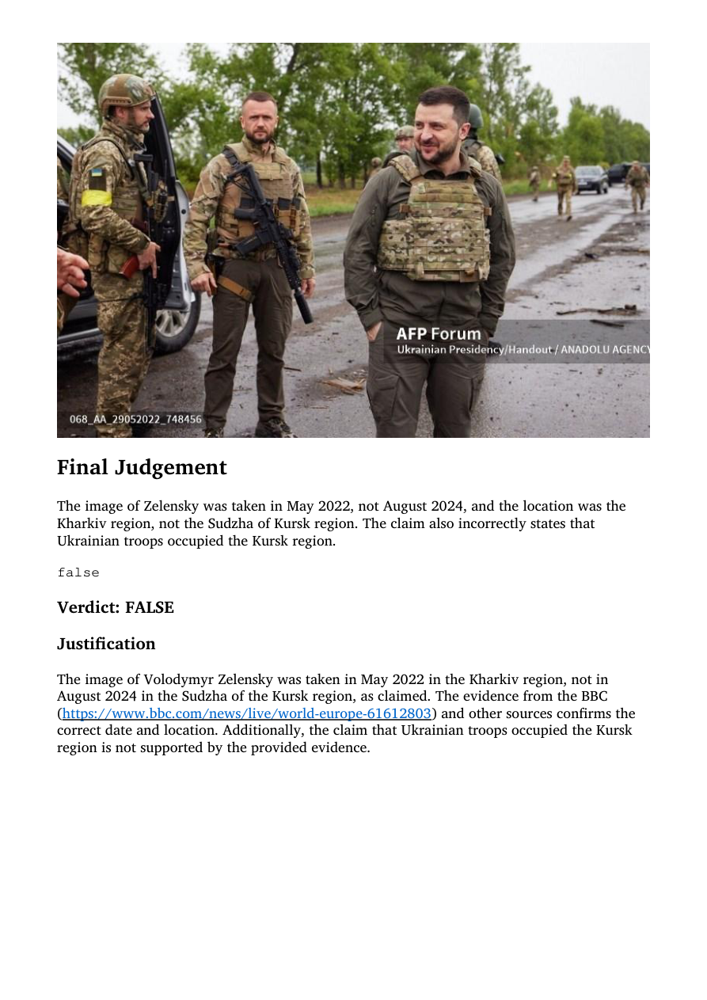


💡 To see ALL pages, run: show_all_pages(9)

✅ Updated analysis for claim 9
{9: {'DEFAME_justification': 'The image of Volodymyr Zelensky was taken in May 2022 in the Kharkiv region, not in August 2024 in the Sudzha of the Kursk region, as claimed. The evidence from the BBC ([https://www.bbc.com/news/live/world-europe-61612803](https://www.bbc.com/news/live/world-europe-61612803)) and other sources confirms the correct date and location. Additionally, the claim that Ukrainian troops occupied the Kursk region is not supported by the provided evidence.\n', 'ground_truth_justification': "A reverse image search and subsequent keyword searches on Google found the same photo -- distributed by the Ukrainian presidential office -- published in AFP's archives on May 29, 2022. \nThe caption of the photo said it was taken in Kharkiv, Ukraine and showed Zelensky visiting the houses and other structures destroyed by the clashes in the city and held a meeting with army officials.", 'problems_with_no

In [61]:
print(claims_indices)

## I'm commenting out the analyzed reports, so the output does not get too long

# 1. Analyze claim (shows justification/last page first, can also display all pages second if necessary)
#analyze_claim(74, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search, df = df_defame_no_web_search_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction
#analyze_claim(39, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search, df = df_defame_no_web_search_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction. the report correctly states that no evidence of an alleged hit list is available, this is actually the correct justification/reasoning for this claim.
#analyze_claim(59, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search, df = df_defame_no_web_search_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction. the reasoning/justification that no evidence/information about an the existence of the alleged bribe list is available is correct.
#analyze_claim(5, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search, df = df_defame_no_web_search_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction
#analyze_claim(6, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search, df = df_defame_no_web_search_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction 
#analyze_claim(35, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search, df = df_defame_no_web_search_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used to prediction. the report correctly states that no evidence/information is available that Putin seeks Fauci`s extradition. thus, the reasoning is correct and there is no problem that the model didn't do any retrieval.
#analyze_claim(44, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search, df = df_defame_no_web_search_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction. the reasoning that there is no informaiton that Biden made such a statement is correct, since he never made that statement.
#analyze_claim(62, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search, df = df_defame_no_web_search_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction
#analyze_claim(60, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search, df = df_defame_no_web_search_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction. the model correctly identified the doctored/photoshopped nature of the image.
analyze_claim(9, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search, df = df_defame_no_web_search_predictions_run3_true_negatives_sample) # relevant evidence is retrieved and used for prediction

# 2. If all pages are needed:#
#show_all_pages(60)

# 3. Add the manual analysis:
#add_manual_analysis(74, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search)
#add_manual_analysis(39, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search)
#add_manual_analysis(59, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search)
#add_manual_analysis(5, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search)
#add_manual_analysis(6, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search)
#add_manual_analysis(35, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search)
#add_manual_analysis(44, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search)
#add_manual_analysis(62, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search)
#add_manual_analysis(60, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search)
add_manual_analysis(9, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_web_search)

# 4. Check current dictionary state:
print(dict_true_negatives_qualitative_analysis_defame_no_web_search)

In [62]:
# Verify that dict has all claims
print(len(dict_true_negatives_qualitative_analysis_defame_no_web_search))
dict_true_negatives_qualitative_analysis_defame_no_web_search

1


{9: {'DEFAME_justification': 'The image of Volodymyr Zelensky was taken in May 2022 in the Kharkiv region, not in August 2024 in the Sudzha of the Kursk region, as claimed. The evidence from the BBC ([https://www.bbc.com/news/live/world-europe-61612803](https://www.bbc.com/news/live/world-europe-61612803)) and other sources confirms the correct date and location. Additionally, the claim that Ukrainian troops occupied the Kursk region is not supported by the provided evidence.\n',
  'ground_truth_justification': "A reverse image search and subsequent keyword searches on Google found the same photo -- distributed by the Ukrainian presidential office -- published in AFP's archives on May 29, 2022. \nThe caption of the photo said it was taken in Kharkiv, Ukraine and showed Zelensky visiting the houses and other structures destroyed by the clashes in the city and held a meeting with army officials.",
  'problems_with_no_retrieved_evidence': False,
  'correct_for_wrong_reason': False}}

#### 2.1.2) DEFAME w/o RIS

In [63]:
# Deciding which run to use -> random sampling with random state
runs = [1, 2, 3]

rng = random.Random(17)  # Set random state
decision = rng.sample(runs, k=1)
print(decision)  



[3]


In [64]:
# Deciding which claims (n=5) of the True Negative Predictions to analyze

## Load the predictions.csv

dict_defame_no_ris_predictions_csv = load_all_predictions_csv_per_defame_variant(defame_variant="defame_no_ris")
dict_defame_no_ris_predictions_csv

df_defame_no_ris_predictions_run3 = dict_defame_no_ris_predictions_csv["defame_no_ris_predictions_run3"]
df_defame_no_ris_predictions_run3

# Filter the df to only keep all True Negatives
df_defame_no_ris_predictions_run3_true_negatives = df_defame_no_ris_predictions_run3[(df_defame_no_ris_predictions_run3["predicted"]==False) & (df_defame_no_ris_predictions_run3["target"]==False)]
print(len(df_defame_no_ris_predictions_run3_true_negatives)) 
 


# Randomly sample 5 claims 

df_defame_no_ris_predictions_run3_true_negatives_sample = df_defame_no_ris_predictions_run3_true_negatives.sample(n=5, random_state=17)
df_defame_no_ris_predictions_run3_true_negatives_sample

Successfully loaded: defame_no_ris_predictions_run1 with shape (79, 7)
Successfully loaded: defame_no_ris_predictions_run2 with shape (79, 7)
Successfully loaded: defame_no_ris_predictions_run3 with shape (78, 7)
62


,sample_index,claim,predicted,target,correct,justification,gt_justification
17,17,Ukrainian President Volodymyr Zelenskyy purchased an 88 million euro hotel in the Courchevel ski resort in France.,False,False,True,"The claim is false. Fact-checkers, including [Myth Detector](https://mythdetector.com/en/that-volodymyr-zelenskyy/), [Ukrinform](https://www.ukrinform.net/rubric-factcheck/3935929-russian-propaganda-falsely-claims-zelensky-bought-french-hotel-kulebas-son-acquired-iron-throne.html), and Inshorts, have debunked the claim, identifying it as disinformation originating from anonymous Russian-language accounts and a questionable French-language media outlet.\n","While the hotel is real, and was in fact bought by SBM, last year, neither Zelenskiy nor Film Heritage was involved in that sale. A spokesperson for the office of the president of Ukraine said the report was ""fake"". The hotel was not resold in October of this year for 88 million euros, the hotel group’s financial filings. Head of Press and Influence Department of SBM Group, Sylvie Cristin, told Reuters that the SBM Group acquired the ""Palace des Neiges"" in October 2023 to integrate its hotel portfolio."
51,51,In February 2025 German Chancellor Olaf Scholz declared a state of emergency in Germany due to US President Donald Trump's peace plan for Ukraine.,False,False,True,"The claim is false. Fact-checks and news articles confirm that Olaf Scholz did not declare a state of emergency in Germany in February 2025. Instead, he referred to an ""emergency situation"" related to the war in Ukraine, and he was reportedly unaware of Donald Trump's peace plan, as indicated by a Politico article ([https://www.politico.eu/article/olaf-scholz-germany-donald-trump-war-in-ukraine-peace-plan/](https://www.politico.eu/article/olaf-scholz-germany-donald-trump-war-in-ukraine-peace-plan/)).\n","Contrary to the viral claim, German Chancellor Olaf Scholz did not call for a state of emergency in Germany after Trump’s recent peace talks. A closer review of Scholz’s speech reveals that he referred to “Notlage,” not “Notstand” as claimed. In the video, Scholz said, “The Bundestag should pass a resolution as soon as possible according to which the war in Ukraine and its serious consequences for the security of Germany and Europe are classified as an emergency (Notlage) within the meaning of Article 115 paragraph two of the Basic Law.” In German, “Notstand” means a state of emergency that would severely restrict citizens’ rights. However, “Notlage” appears in the German Basic Law and signifies an urgent situation, but it does not equate to a government-imposed state of emergency.”"
74,74,"<image:23> This image shows a Russian ammunition depot in Toropets, Tver Oblast, before and after it was hit by a, possible nuclear, strike from the North Atlantic Treaty Organization (NATO).",False,False,True,"The image depicts a Russian ammunition depot in Toropets, Tver Oblast, before and after a Ukrainian drone strike, not a NATO strike. Multiple sources, including CNN ([https://edition.cnn.com/2024/09/18/europe/ukraine-russian-weapons-depot-drone-attack-intl](https://edition.cnn.com/2024/09/18/europe/ukraine-russian-weapons-depot-drone-attack-intl)), Euronews ([https://www.euronews.com/my-europe/2024/09/18/what-was-stored-at-the-russian-arms-depot-in-tver-region-struck-by-ukraines-drones](https://www.euronews.com/my-europe/2024/09/18/what-was-stored-at-the-russian-arms-depot-in-tver-region-struck-by-ukraines-drones)), and the Associated Press, confirm the Ukrainian drone attack.\n","This claim is false. The attack was not from NATO, but a Ukrainian drone strike, according to The Associated Press. A Kyiv security official told the outlet that the attack was carried out by Ukrainian Special Operation Forces, Security Service and Intelligence. At least 100 Ukrainian drones took part in the attack, the outlet reported. The regional governor of Tver told residents they would be able to go back to their ho

In [65]:
# Convert claim indices to list

claims_indices = df_defame_no_ris_predictions_run3_true_negatives_sample["sample_index"].to_list()
claims_indices

# Code the file path pattern to loop through
file_path_pattern = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run3/DEFAME_output/2025-08-30_08-46 no_ris/fact-checks/{sample_index}/report.pdf"

In [66]:
# Create empty dictionary to store results from qualitative analysis
dict_true_negatives_qualitative_analysis_defame_no_ris = {}

[17, 51, 74, 66, 23]
🔍 ANALYZING CLAIM INDEX: 23

📄 PDF REPORT (LAST PAGE ONLY):
----------------------------------------
📄 PDF has 4 pages, showing LAST PAGE only (Page 4)


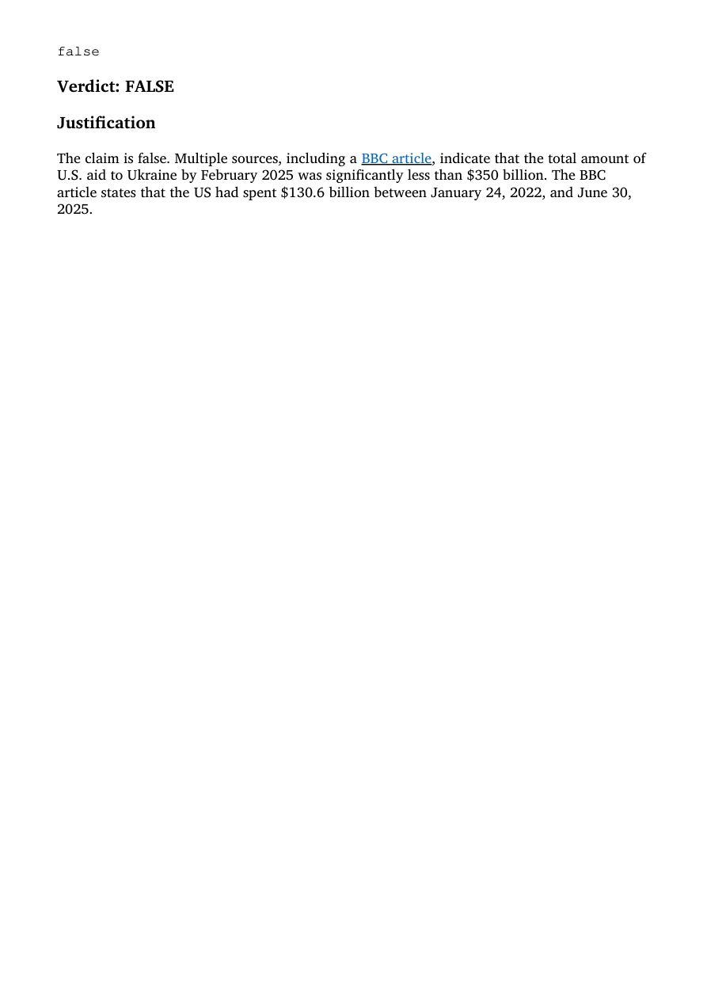


💡 To see ALL pages, run: show_all_pages(23)

✅ Updated analysis for claim 23
{23: {'DEFAME_justification': 'The claim is false. Multiple sources, including a [BBC article](https://www.bbc.com/news/67411857), indicate that the total amount of U.S. aid to Ukraine by February 2025 was significantly less than $350 billion. The BBC article states that the US had spent $130.6 billion between January 24, 2022, and June 30, 2025.\n', 'ground_truth_justification': "It's possible to arrive at varying totals depending on how military aid is defined or by considering how much money was allocated — as opposed to actually paid out — by the U.S. government, but none of these totals amounts to $350 billion.\nTrump's claim is incorrect. While it is possible to arrive at varying totals using different ways to categorize or count the financial figures, none amounts to $350 billion. As of this writing, the United States had allocated nearly $183 billion for the response to Russia's 2022 invasion of Ukrai

In [67]:
print(claims_indices)

## I'm commenting out the analyzed reports, so the output does not get too long

# 1. Analyze claim (shows justification/last page first, can also display all pages second if necessary)
#analyze_claim(17, dict = dict_true_negatives_qualitative_analysis_defame_no_ris, df = df_defame_no_ris_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction. 
#analyze_claim(51, dict = dict_true_negatives_qualitative_analysis_defame_no_ris, df = df_defame_no_ris_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction
#analyze_claim(74, dict = dict_true_negatives_qualitative_analysis_defame_no_ris, df = df_defame_no_ris_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction. 
#analyze_claim(66, dict = dict_true_negatives_qualitative_analysis_defame_no_ris, df = df_defame_no_ris_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction
analyze_claim(23, dict = dict_true_negatives_qualitative_analysis_defame_no_ris, df = df_defame_no_ris_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction. 


# # # 2. If all pages are needed:#
#show_all_pages(66)

# # # 3. Add the manual analysis:
#add_manual_analysis(17, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_ris)
#add_manual_analysis(51, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_ris)
#add_manual_analysis(74, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_ris)
#add_manual_analysis(66, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_ris)
add_manual_analysis(23, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_no_ris)


# # 4. Check current dictionary state:
print(dict_true_negatives_qualitative_analysis_defame_no_ris)

In [68]:
# Verify that dict has all claims
print(len(dict_true_negatives_qualitative_analysis_defame_no_ris))
dict_true_negatives_qualitative_analysis_defame_no_ris

1


{23: {'DEFAME_justification': 'The claim is false. Multiple sources, including a [BBC article](https://www.bbc.com/news/67411857), indicate that the total amount of U.S. aid to Ukraine by February 2025 was significantly less than $350 billion. The BBC article states that the US had spent $130.6 billion between January 24, 2022, and June 30, 2025.\n',
  'ground_truth_justification': "It's possible to arrive at varying totals depending on how military aid is defined or by considering how much money was allocated — as opposed to actually paid out — by the U.S. government, but none of these totals amounts to $350 billion.\nTrump's claim is incorrect. While it is possible to arrive at varying totals using different ways to categorize or count the financial figures, none amounts to $350 billion. As of this writing, the United States had allocated nearly $183 billion for the response to Russia's 2022 invasion of Ukraine, according to the U.S. government's inspector general overseeing the situ

#### 2.1.3) DEFAME (default)

In [69]:
# Deciding which run to use -> random sampling with random state
runs = [1, 2, 3]

rng = random.Random(42)  # Set random state
decision = rng.sample(runs, k=1)
print(decision)  



[3]


In [70]:
# Deciding which claims (n=10) of the True Negative Predictions to analyze

## Load the predictions.csv

dict_defame_default_predictions_csv = load_all_predictions_csv_per_defame_variant(defame_variant="defame_default")
dict_defame_default_predictions_csv

dict_defame_default_predictions_csv_run3 = dict_defame_default_predictions_csv["defame_default_predictions_run3"]
dict_defame_default_predictions_csv_run3

# # Filter the df to only keep all True Negatives

dict_defame_default_predictions_csv_run3_true_negatives = dict_defame_default_predictions_csv_run3[(dict_defame_default_predictions_csv_run3["predicted"]==False) & (dict_defame_default_predictions_csv_run3["target"]==False)]
print(len(dict_defame_default_predictions_csv_run3_true_negatives))
dict_defame_default_predictions_csv_run3_true_negatives


# # Randomly sample 5 claims 

df_defame_default_predictions_run3_true_negatives_sample = dict_defame_default_predictions_csv_run3_true_negatives.sample(n=5, random_state=42)
df_defame_default_predictions_run3_true_negatives_sample

Successfully loaded: defame_default_predictions_run1 with shape (79, 7)
Successfully loaded: defame_default_predictions_run2 with shape (79, 7)
Successfully loaded: defame_default_predictions_run3 with shape (78, 7)
63


,sample_index,claim,predicted,target,correct,justification,gt_justification
76,77,"<image:25> This image shows a military parade of Poland's army on August 14, 2024, preparing for war with Russia.",False,False,True,"The image depicts a military parade in Poland, which took place on August 15, 2023, as part of the Armed Forces Day observances, showcasing military hardware. The parade was not a preparation for war with Russia.\n","Poland Celebrates Historic Red Army Defeat On August 15, the same footage appeared on DW with the comment: “With tensions rising at its eastern borders, Poland put on a big show with a military parade to celebrate Armed Forces Day. Those tensions are also the reason why the country is aiming to build one of Europe's largest military forces.” Contrary to claims on social media, Poland paid tribute to its historic 1920 triumph over the Red Army on Thursday, August 15, by remembering fallen Poles and showcasing new military equipment. On Armed Forces Day, around 2,500 Polish soldiers, along with dozens of U.S. and other allied forces, marched in military vehicles or tanks, or flew in fighter jets and helicopters in Warsaw, Poland's capital."
69,70,Russian President Vladimir Putin has declared war on the United States.,False,False,True,"The claim is false. According to [Fact Crescendo](https://srilanka.factcrescendo.com/english/did-russia-declare-war-against-the-usa/), there has been no official declaration of war by Russia against the USA. Other sources discuss Putin's actions and policies but do not mention a declaration of war against the United States.\n",Russia has not declared war on the US. There are no reports from credible media outlets or government statements confirming the claim. The video merely narrates recent developments in the ongoing conflict between Russia and Ukraine.
0,0,"<image:1> This image shows a screenshot of an authentic Hull Daily Mail's frontpage from March 13, 2025 saying '70,000 Ukrainian soldiers in the Kursk region died in vain. The UK poured hundreds of millions of pounds into Zelensky's crushing failure'.",False,False,True,"The image of the Hull Daily Mail front page is a fabrication, as confirmed by multiple fact-checking sources, including Gwara Media and The Journal.ie, and the Hull Daily Mail's parent company. The actual front page from March 13, 2025, features a different headline.\n","But the supposed Hull Daily Mail headline blasting Zelensky over the Kursk incursion is a fabrication.\n""That story re Ukraine was a fake,"" said Lija Kresowaty, a spokesperson for Reach PLC, the Hull Daily Mail's parent company, in a March 18 email."
53,54,Ukraine is selling half of the armaments it receives from the United States,False,False,True,"The claim is not supported by the evidence. While the US has provided significant military aid to Ukraine, and there have been issues with tracking some equipment, there is no evidence to suggest that Ukraine is selling half of the armaments it receives from the United States. Sources like [CNN](https://www.cnn.com/2025/08/28/politics/trump-missile-sale-ukraine) and [forumarmstrade.org](https://www.forumarmstrade.org/ukrainearms.html) detail aid packages and sales but do not mention Ukraine selling armaments.\n","Claims that NATO weapons and ammunition are being put on sale on the dark web have re-surfaced in recent months, but as other outlets have reported, there is no evidence that any such products have actually made it into the hands of a prospective buyer. A Newsweek analysis of similar claims made in 2022, the year the war began, reveals a coordinated effort by Russian disinformation networks to spread false narratives about Ukraine's handling of Western-supplied weapons. This effort has included fabricated dark web ads, with pro-Russian outlets circulating images of a supposed Javelin anti-tank weapon for sale online. However, the listing was traced back to pro-Russian Telegram channels, and the images themselves dated to 2014— pre

In [71]:
# Convert claim indices to list

claims_indices = df_defame_default_predictions_run3_true_negatives_sample["sample_index"].to_list()
claims_indices

# Code the file path pattern to loop through
file_path_pattern = "../../model_results/ukraine_russia/summary_dynamic_default/run3/DEFAME_output/2025-08-29_20-28 default/fact-checks/{sample_index}/report.pdf"



In [72]:
# Create empty dictionary to store results from qualitative analysis
dict_true_negatives_qualitative_analysis_defame_default = {}

[77, 70, 0, 54, 5]
🔍 ANALYZING CLAIM INDEX: 5

📄 PDF REPORT (LAST PAGE ONLY):
----------------------------------------
📄 PDF has 3 pages, showing LAST PAGE only (Page 3)


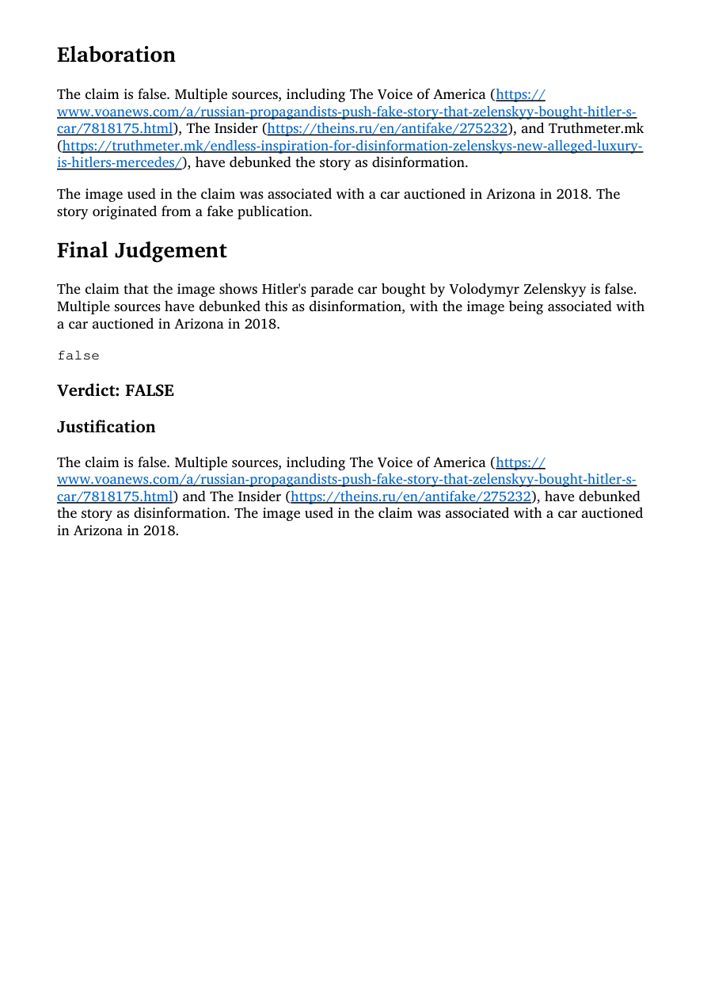


💡 To see ALL pages, run: show_all_pages(5)

✅ Updated analysis for claim 5
{5: {'DEFAME_justification': 'The claim is false. Multiple sources, including The Voice of America ([https://www.voanews.com/a/russian-propagandists-push-fake-story-that-zelenskyy-bought-hitler-s-car/7818175.html](https://www.voanews.com/a/russian-propagandists-push-fake-story-that-zelenskyy-bought-hitler-s-car/7818175.html)) and The Insider ([https://theins.ru/en/antifake/275232](https://theins.ru/en/antifake/275232)), have debunked the story as disinformation. The image used in the claim was associated with a car auctioned in Arizona in 2018.\n', 'ground_truth_justification': "The Ukrainian Center for Combating Disinformation -- part of the country's National Security and Defense Council -- refuted the false claim that the photo showed Hitler's Mercedes at the presidential palace (archived link).", 'problems_with_no_retrieved_evidence': False, 'correct_for_wrong_reason': False}}


In [73]:
print(claims_indices)

## I'm commenting out the analyzed reports, so the output does not get too long

# 1. Analyze claim (shows justification/last page first, can also display all pages second if necessary)
#analyze_claim(77, dict = dict_true_negatives_qualitative_analysis_defame_default, df = df_defame_default_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction. 
#analyze_claim(70, dict = dict_true_negatives_qualitative_analysis_defame_default, df = df_defame_default_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction.
#analyze_claim(0, dict = dict_true_negatives_qualitative_analysis_defame_default, df = df_defame_default_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction. 
#analyze_claim(54, dict = dict_true_negatives_qualitative_analysis_defame_default, df = df_defame_default_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction. reasoning/justification that no evidence is available for selling the armaments is correct. 
analyze_claim(5, dict = dict_true_negatives_qualitative_analysis_defame_default, df = df_defame_default_predictions_run3_true_negatives_sample) #relevant evidence is retrieved and used for prediction.


# # # # 2. If all pages are needed:#
#show_all_pages(77)

# # # # 3. Add the manual analysis:
#add_manual_analysis(77, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_default)
#add_manual_analysis(70, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_default)
#add_manual_analysis(0, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_default)
#add_manual_analysis(54, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_default)
add_manual_analysis(5, problems_with_no_retrieved_evidence=False, correct_for_wrong_reason=False, dict = dict_true_negatives_qualitative_analysis_defame_default)


# # 4. Check current dictionary state:
print(dict_true_negatives_qualitative_analysis_defame_default)

In [74]:
# Verify the length of the dict
print(len(dict_true_negatives_qualitative_analysis_defame_default))
dict_true_negatives_qualitative_analysis_defame_default

1


{5: {'DEFAME_justification': 'The claim is false. Multiple sources, including The Voice of America ([https://www.voanews.com/a/russian-propagandists-push-fake-story-that-zelenskyy-bought-hitler-s-car/7818175.html](https://www.voanews.com/a/russian-propagandists-push-fake-story-that-zelenskyy-bought-hitler-s-car/7818175.html)) and The Insider ([https://theins.ru/en/antifake/275232](https://theins.ru/en/antifake/275232)), have debunked the story as disinformation. The image used in the claim was associated with a car auctioned in Arizona in 2018.\n',
  'ground_truth_justification': "The Ukrainian Center for Combating Disinformation -- part of the country's National Security and Defense Council -- refuted the false claim that the photo showed Hitler's Mercedes at the presidential palace (archived link).",
  'problems_with_no_retrieved_evidence': False,
  'correct_for_wrong_reason': False}}

In [75]:
## Write a function to combine the results from all dictionaries into a final df, which also has the defame variant as a column

def combine_with_duplicate_handling(dict_no_web_search, dict_no_ris, dict_default):
    """Combine dictionaries, keeping all entries even for duplicate claim indices"""
    
    all_records = []
    
    # Process each dictionary
    for variant_name, variant_dict in [
        ('defame_no_web_search', dict_no_web_search),
        ('defame_no_ris', dict_no_ris),
        ('defame_default', dict_default)
    ]:
        for claim_index, analysis_data in variant_dict.items():
            record = {
                'claim_index': claim_index,
                'DEFAME_variant': variant_name,
                'DEFAME_justification': analysis_data.get('DEFAME_justification', analysis_data.get('justification', '')),
                'ground_truth_justification': analysis_data.get('ground_truth_justification', ''),
                'problems_with_no_retrieved_evidence': analysis_data.get('problems_with_no_retrieved_evidence', analysis_data.get('no_evidence_as_reason', None)),
                'correct_for_wrong_reason': analysis_data.get('correct_for_wrong_reason', None)
            }
            all_records.append(record)
    
    # Create dataframe 
    df_combined = pd.DataFrame(all_records)
    
    
    return df_combined

In [76]:
df_qualitative_analysis_combined = combine_with_duplicate_handling(
    dict_true_negatives_qualitative_analysis_defame_no_web_search,
    dict_true_negatives_qualitative_analysis_defame_no_ris, 
    dict_true_negatives_qualitative_analysis_defame_default
)

df_qualitative_analysis_combined


## save df as csv

df_qualitative_analysis_combined.to_csv("ukraine_russia_qualitative_analysis_true_negative_predictions_sanity_check.csv")


### 2.2) Analyze consistently wrong predictions across all three runs 


- Number of consistently wrong predictions per DEFAME variant:

    - w/o Web Search: n = 5
        - Text-only claims: n = 5


    - w/o RIS: n = 3
        - Text-only claims: n = 2
        - Claims w/ Altered images: n = 1

    - w/o Geolocate n = 2
        - Text-only claims: n = 1
        - Claims w/ Altered images: n = 1

    - w/o Image Search: n = 1
        - Text-only claims: n = 1

    - default: n = 0

In [77]:
# Copied the claim indices from code output above, where def compute_intersection_wrong_predictions was applied to each DEFAME variant

defame_default_consistently_wrong_claims_indices = [] # no claims

defame_no_web_search_consistently_wrong_claims_indices = [18, 25, 28, 31, 32]

defame_no_ris_consistently_wrong_claims_indices = [31, 48, 63]


defame_no_geolocate_consistently_wrong_claims_indices = [31, 48, 63]

defame_no_image_search_consistently_wrong_claims_indices = [31]

## Print the number of all claims
print(f"The number of all consistently wrongly predicted claims is:")
print(len(defame_no_ris_consistently_wrong_claims_indices + defame_default_consistently_wrong_claims_indices + defame_no_web_search_consistently_wrong_claims_indices + defame_no_geolocate_consistently_wrong_claims_indices + defame_no_image_search_consistently_wrong_claims_indices))

## Print the number of unique claims
print(f"The number of the unique conistently wrong predicted claims is:")
len(set(defame_no_ris_consistently_wrong_claims_indices + defame_default_consistently_wrong_claims_indices + defame_no_web_search_consistently_wrong_claims_indices + defame_no_geolocate_consistently_wrong_claims_indices + defame_no_image_search_consistently_wrong_claims_indices))


The number of all consistently wrongly predicted claims is:
12
The number of the unique conistently wrong predicted claims is:


7

In [78]:
# Create a dictionary with the consistently wrong claims for each DEFAME variant
defame_variants_claims = {
    'w/o_RIS': [31, 48, 63],
    'w/o_web_search': [18, 25, 28, 31, 32],
    'w/o_geolocate': [31, 48, 63],
    'w/o_image_search': [31]
}

#### 2.2.1) Qualitative Analyze the claims in DEFAME w/o Web Search

#### 1) claim index: 18 

- is also among the top 10 most frequent error/wrong predictions across all DEFAME variants and runs
    - is  Nr. 5 with n = 9 wrong predictions overall

📄 Showing ALL 4 pages:


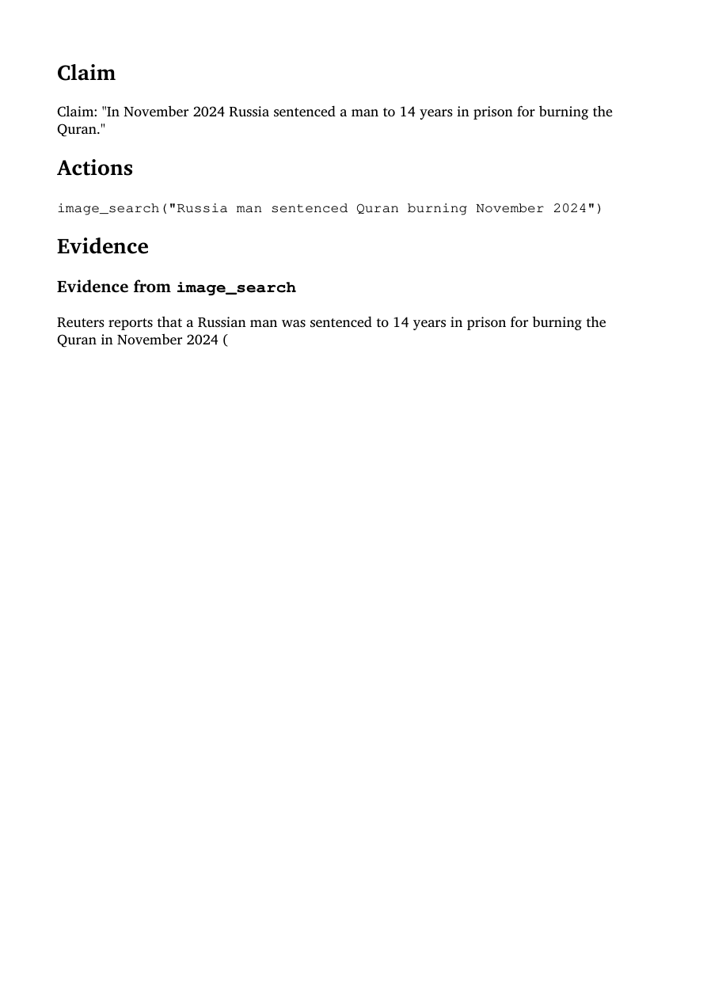

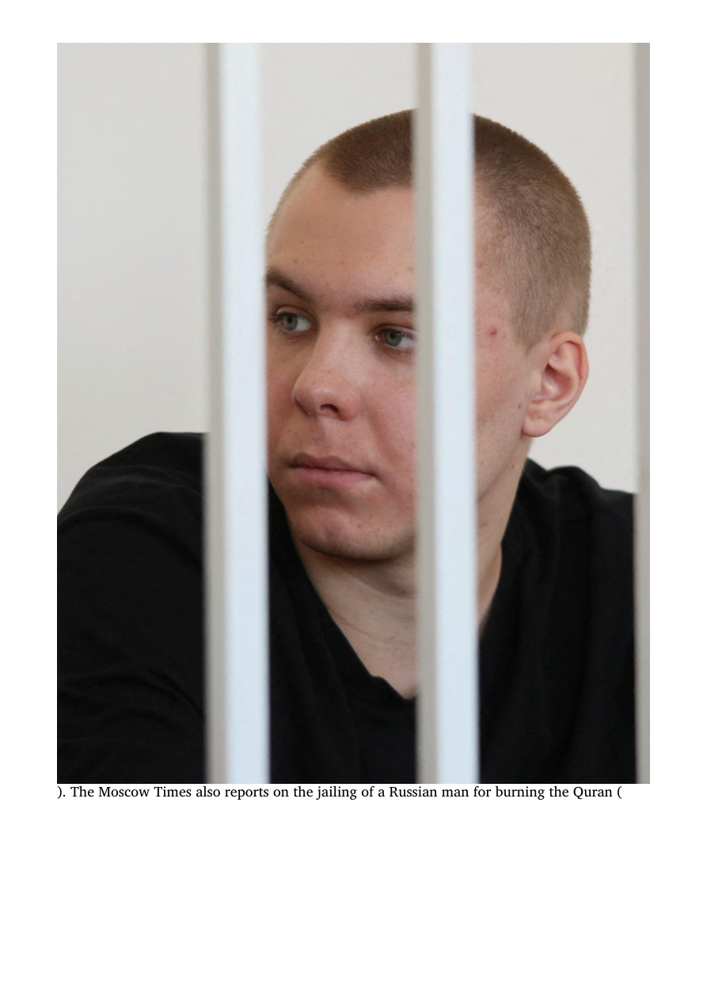

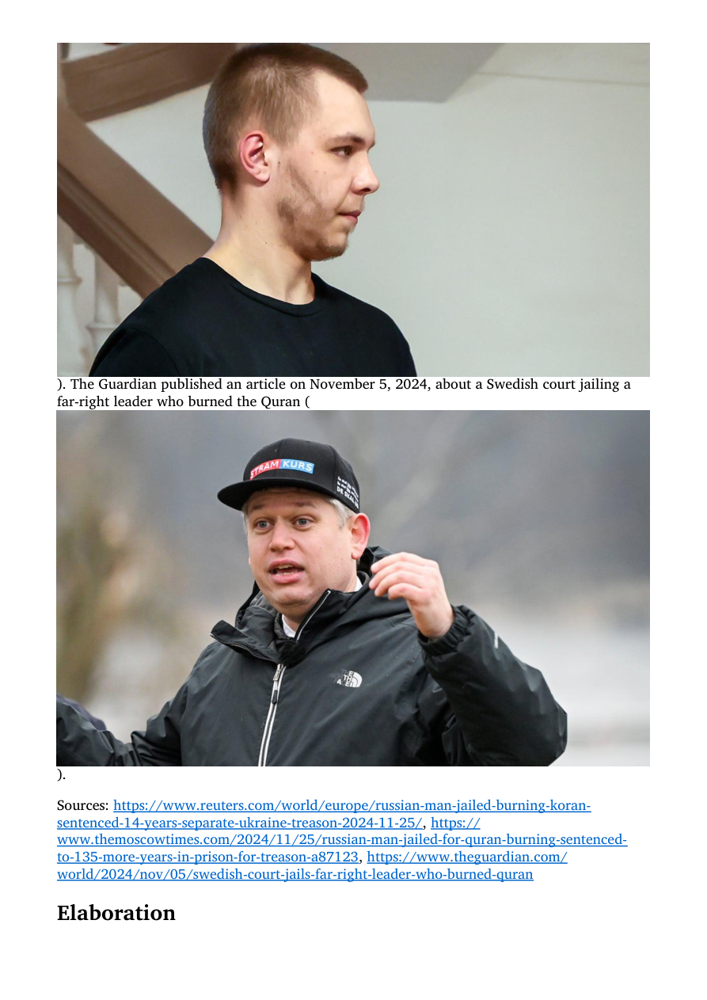

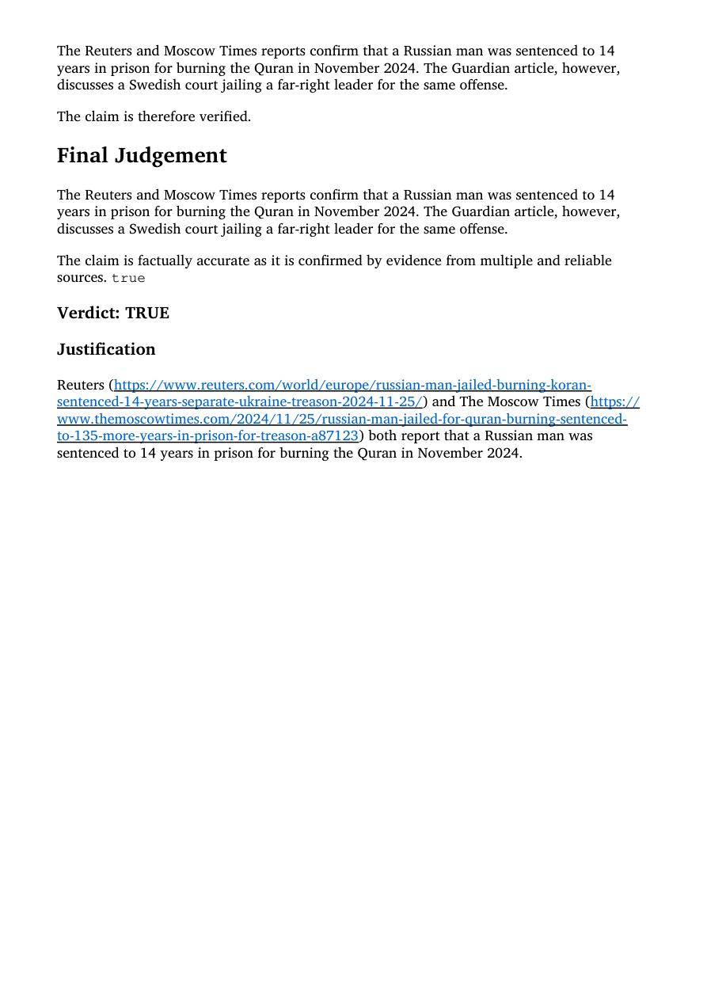

In [79]:
## 1) Qualitative analyze first claim (index = 8) in all three runs


pdf_path_run1 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run1/DEFAME_output/2025-08-29_22-35 no_web_search/fact-checks/18/report.pdf"
pdf_path_run2 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run2/DEFAME_output/2025-08-29_22-57 no_web_search/fact-checks/18/report.pdf"
pdf_path_run3 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run3/DEFAME_output/2025-08-29_23-19 no_web_search/fact-checks/18/report.pdf"

#display_pdf_all_pages(pdf_path_run1)
#display_pdf_all_pages(pdf_path_run2)
display_pdf_all_pages(pdf_path_run3)




- reasons for wrong predictions:
    - run 1: 
        - used tools: image search
        - Ambigious/misleading headlines or entire content of newspaper (Reuters, Moscow Times) about the sentence (Quran Burning vs Treason)

    - run 2: 
        - used tools: image search
        - same as run 1

    - run 3: 
        - used tools: image search
        - same as run 1&2


In [80]:
# Create dictionaries for each claim's reasons for wrong predictions -> will later be used to make a nice df for a better overview of most common error reasons

# Initialize empty dict
error_reasons_data = {}

error_reasons_data.update({
    # DEFAME w/o RIS
    18: {
        'variant': 'w/o_web_search',
        'claim_type': 'Text-Only',
        'primary_reason': 'News sources contain wrong/misleading/ambigious headlines and/or information: Quran Burning vs Treason.',
        'secondary_reason': '',
        'tool_limitation': '',
        'evidence_quality': 'Misleading'
    }})

#### 2) claim index: 25 

- is not among the top 10 most frequent error/wrong predictions across all DEFAME variants and runs

📄 Showing ALL 4 pages:


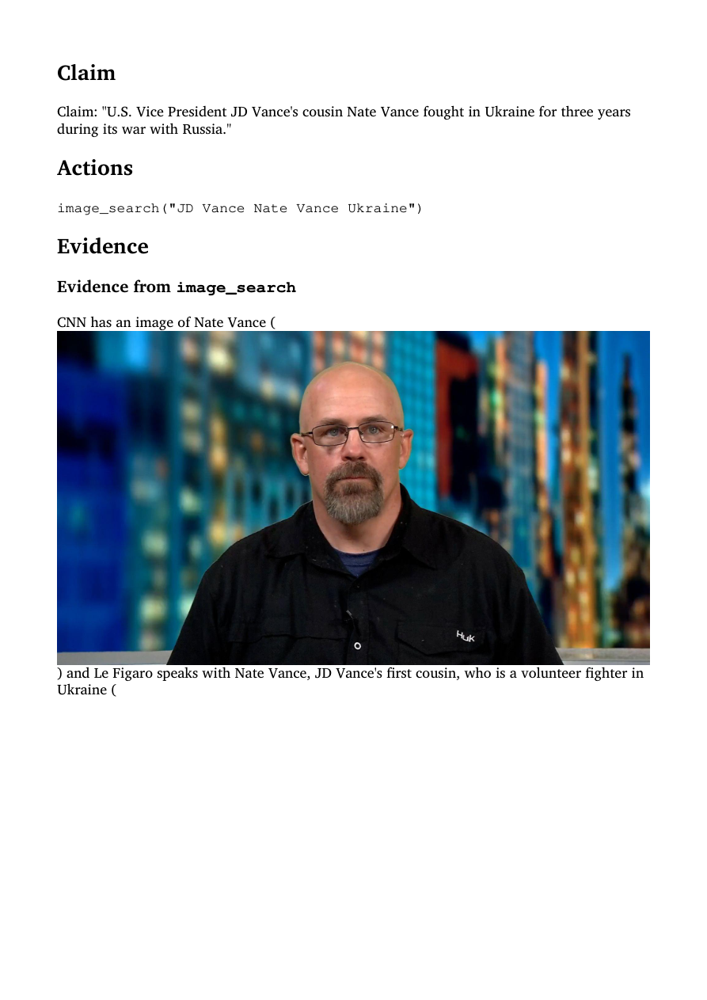

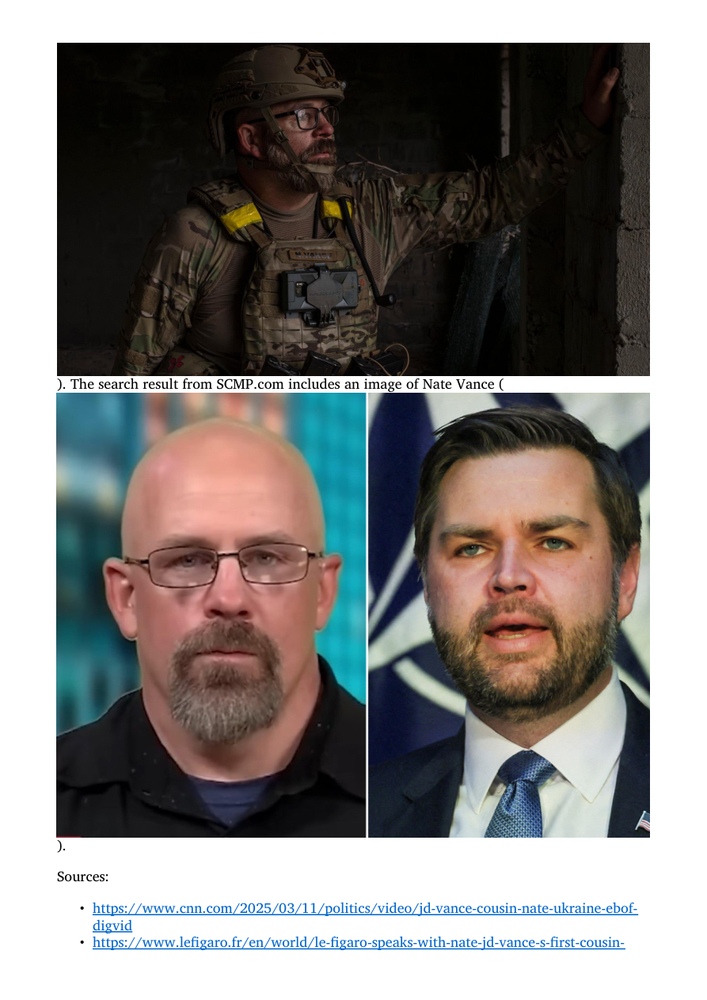

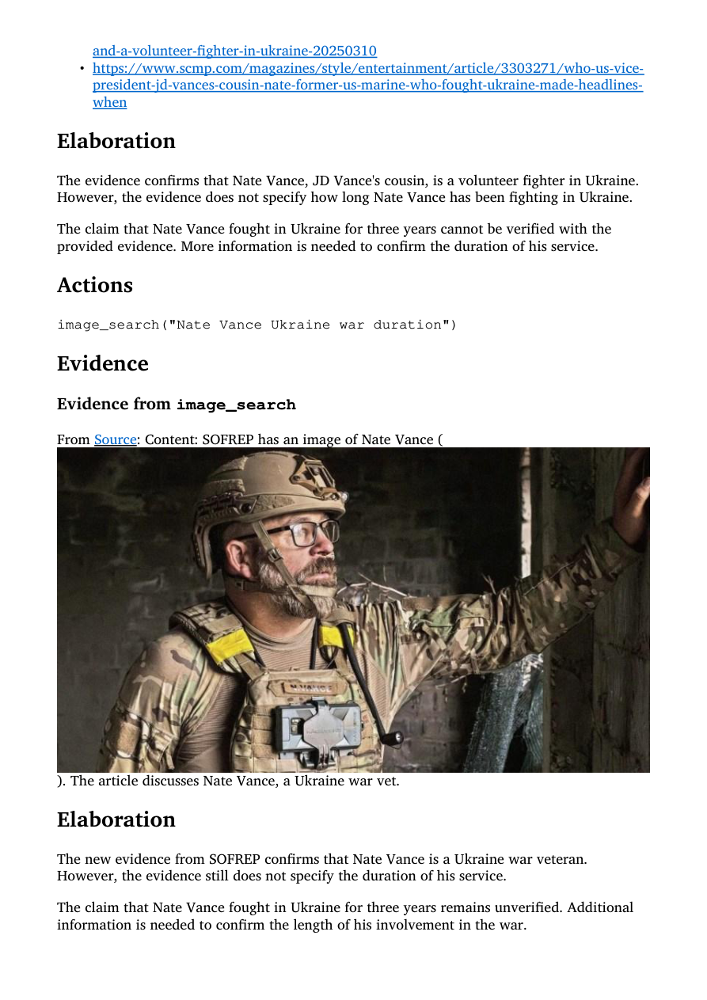

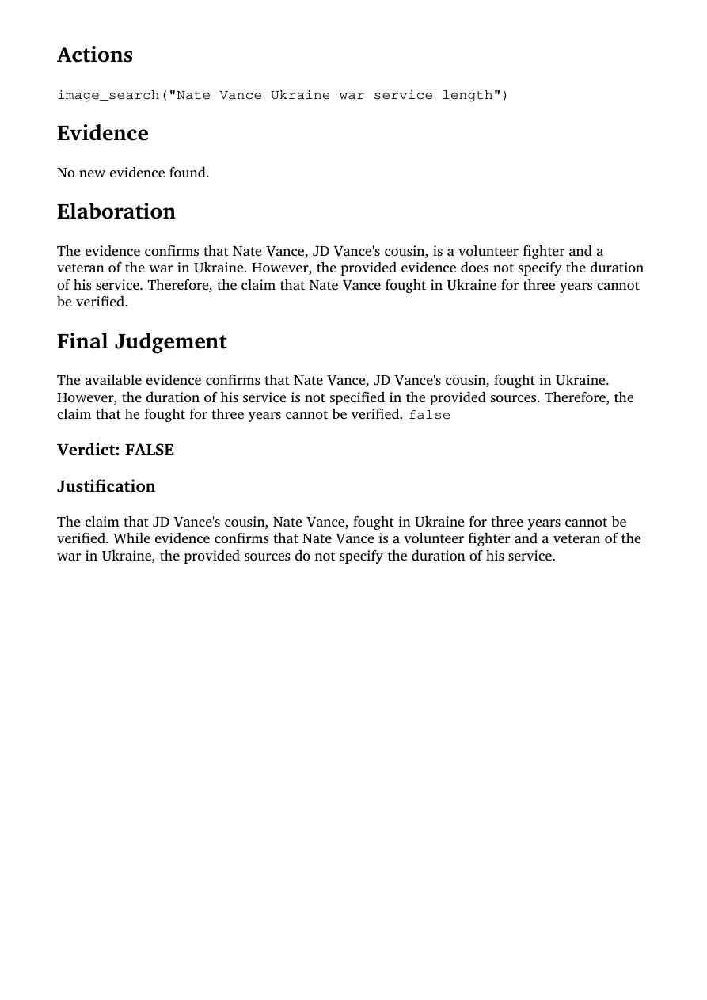

In [81]:
## 1) Qualitative analyze first claim (index = 8) in all three runs


pdf_path_run1 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run1/DEFAME_output/2025-08-29_22-35 no_web_search/fact-checks/25/report.pdf"
pdf_path_run2 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run2/DEFAME_output/2025-08-29_22-57 no_web_search/fact-checks/25/report.pdf"
pdf_path_run3 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run3/DEFAME_output/2025-08-29_23-19 no_web_search/fact-checks/25/report.pdf"

#display_pdf_all_pages(pdf_path_run1)
#display_pdf_all_pages(pdf_path_run2)
display_pdf_all_pages(pdf_path_run3)




- reasons for wrong predictions:
    - run 1: 
        - used tools: image search
        - Could not retrieve enough relevant evidence to make the correct prediciton (web search would have been necessary) -> could not figure out 

    - run 2: 
        - used tools: image search
        - same as run 1

    - run 3: 
        - used tools: image search
        - same as run 1&2


In [82]:
# Create dictionaries for each claim's reasons for wrong predictions -> will later be used to make a nice df for a better overview of most common error reasons


error_reasons_data.update({
    # DEFAME w/o RIS
    25: {
        'variant': 'w/o_web_search',
        'claim_type': 'Text-Only',
        'primary_reason': 'Tool limitation: Could not retrieve enough relevant evidence without web search to make the correct prediciton.',
        'secondary_reason': '',
        'tool_limitation': 'Could not retrieve enough relevant evidence without web search to make the correct prediciton.',
        'evidence_quality': ''
    }})

#### 3) claim index: 28 

- is also among the top 10 most frequent error/wrong predictions across all DEFAME variants and runs
    - is nr. 4 with n = 10

📄 Showing ALL 4 pages:


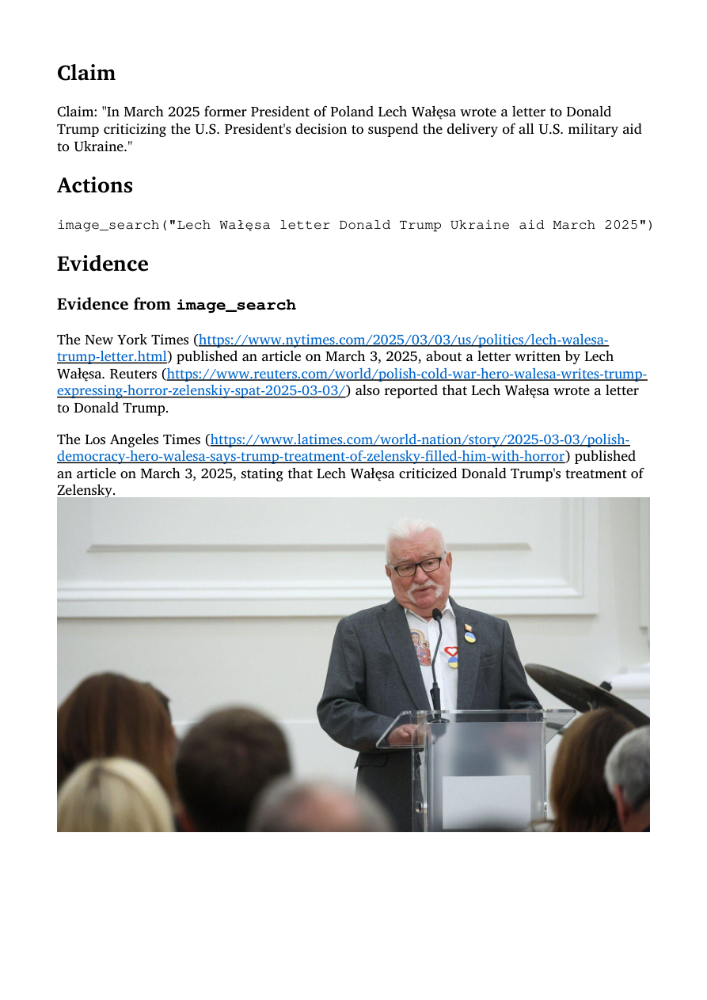

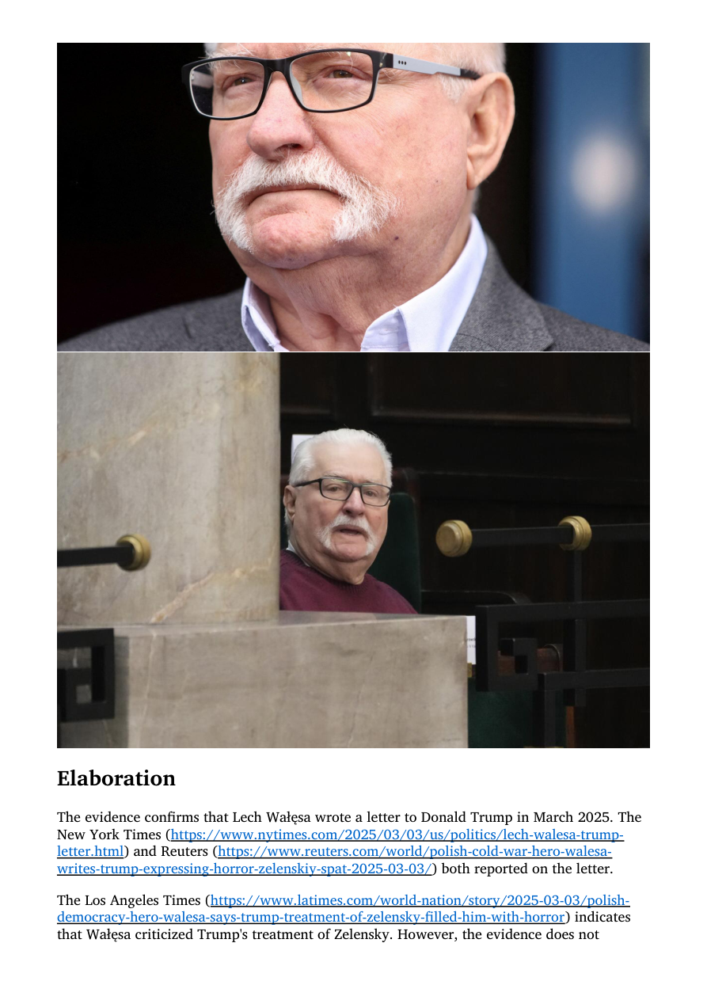

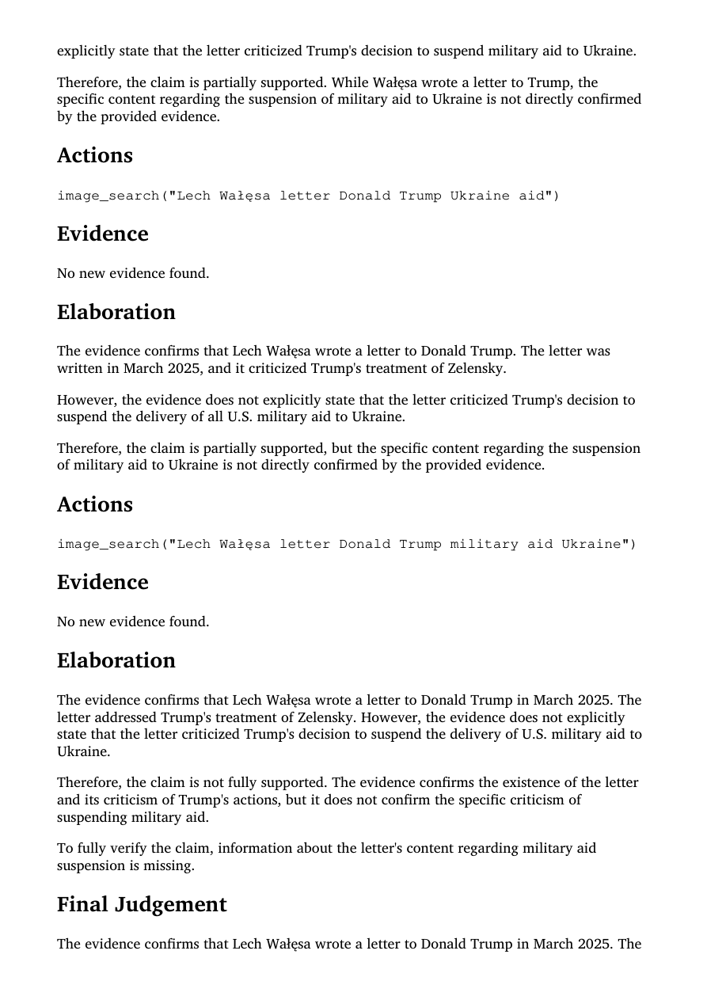

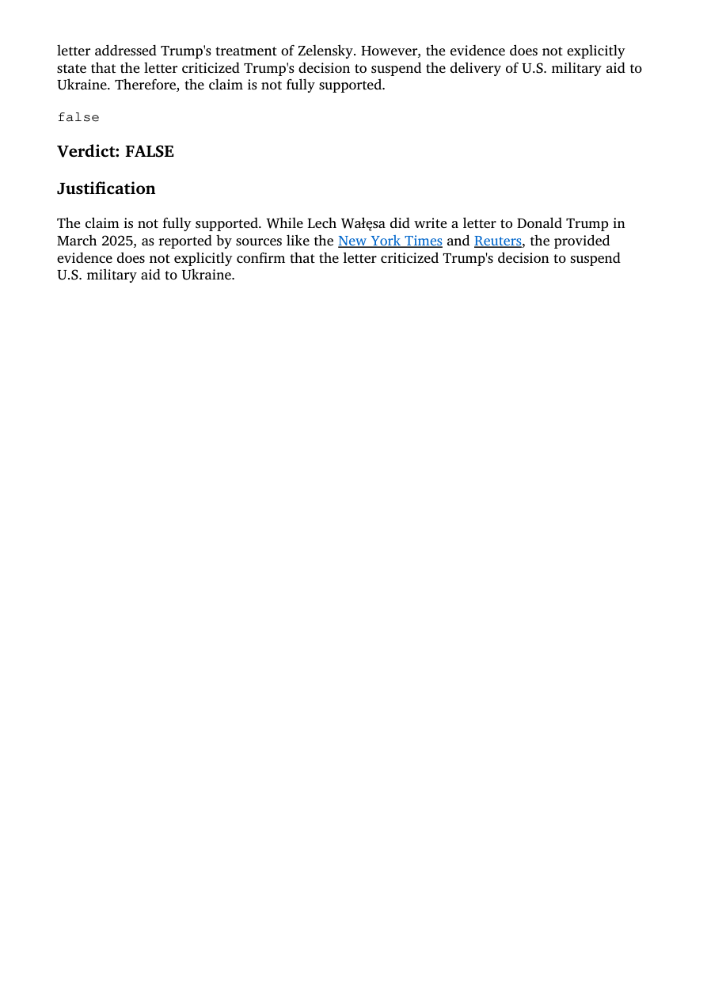

In [83]:
## 1) Qualitative analyze first claim (index = 8) in all three runs


pdf_path_run1 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run1/DEFAME_output/2025-08-29_22-35 no_web_search/fact-checks/28/report.pdf"
pdf_path_run2 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run2/DEFAME_output/2025-08-29_22-57 no_web_search/fact-checks/28/report.pdf"
pdf_path_run3 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run3/DEFAME_output/2025-08-29_23-19 no_web_search/fact-checks/28/report.pdf"

#display_pdf_all_pages(pdf_path_run1)
#display_pdf_all_pages(pdf_path_run2)
display_pdf_all_pages(pdf_path_run3)




- reasons for wrong predictions:
    - run 1: 
        - used tools: image search
        - Claim ambigiuity. Mismatch between fact-checking website evidence and retrieved newspaper evidence.

    - run 2: 
        - used tools: image search
        - same as run 1

    - run 3: 
        - used tools: image search
        - same as run 1&2


In [84]:
# Create dictionaries for each claim's reasons for wrong predictions -> will later be used to make a nice df for a better overview of most common error reasons


error_reasons_data.update({
    # DEFAME w/o web search
    28: {
        'variant': 'w/o_web_search',
        'claim_type': 'Text-Only',
        'primary_reason': 'Claim ambigiuity. Mismatch between fact-checking website evidence and retrieved newspaper evidence.  ',
        'secondary_reason': ' Snopes based its fact-check on criticisms around military aid, the retrieved newspapers confirm the criticism but not the military aid part.',
        'tool_limitation': '',
        'evidence_quality': ''
    }})

#### 4) claim index: 31 

- is among the top 10 most frequent error/wrong predictions across all DEFAME variants and runs
    - is the most frequent with n = 14

📄 Showing ALL 3 pages:


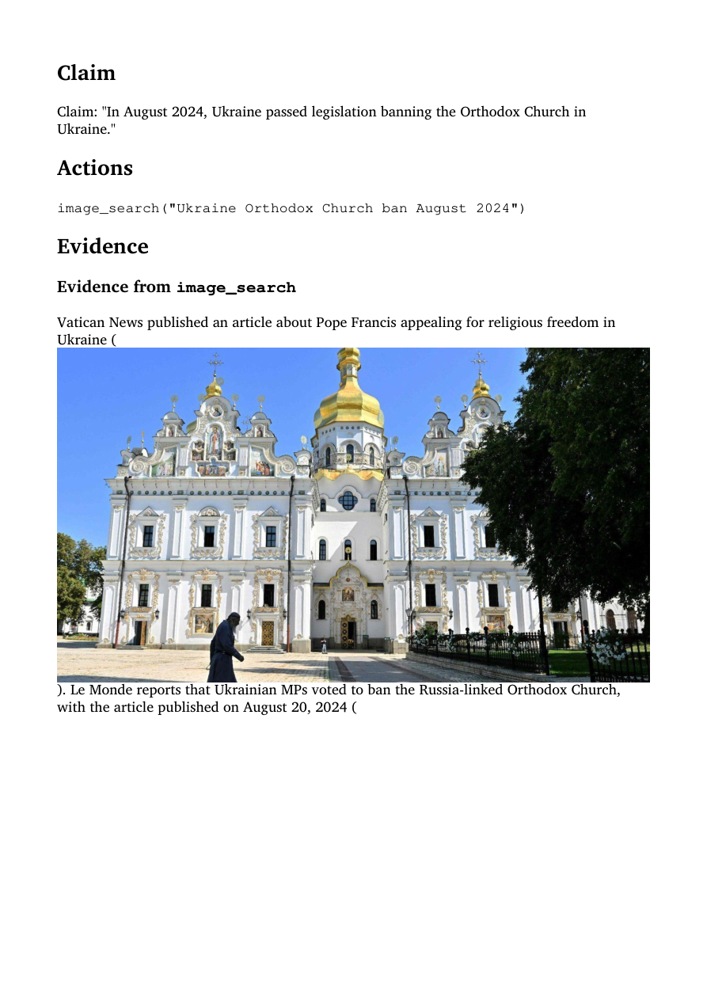

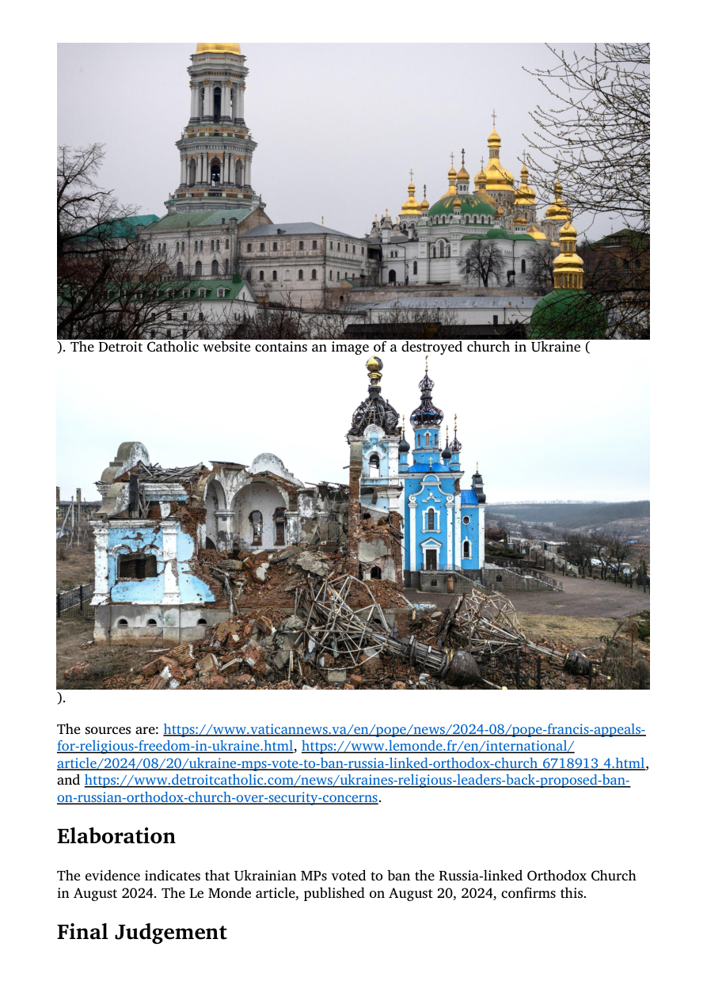

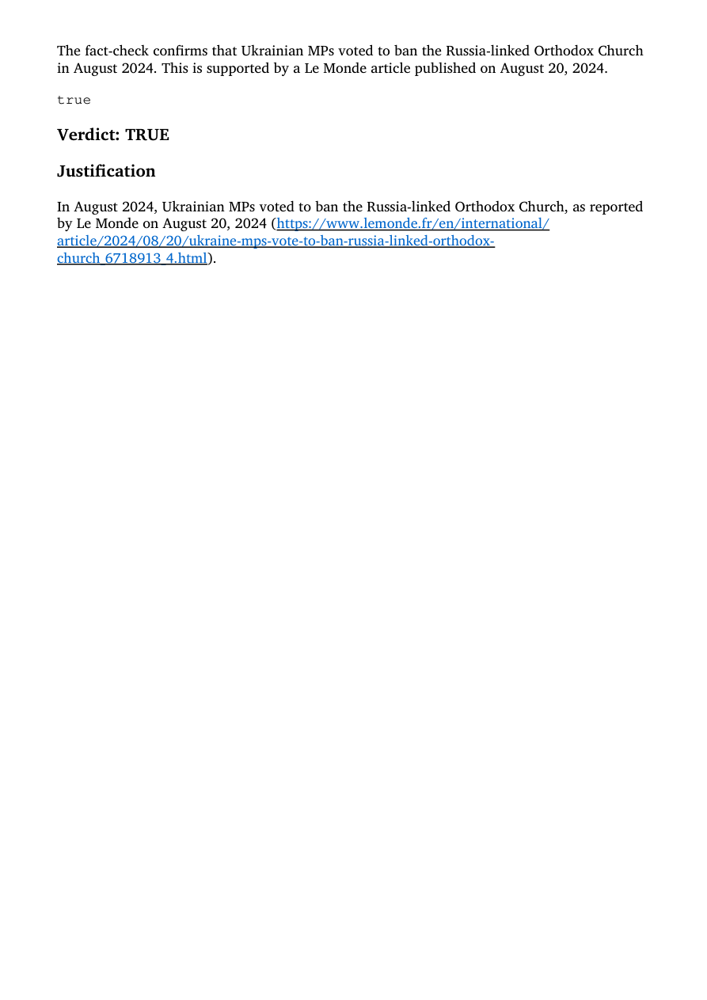

In [85]:
## 1) Qualitative analyze first claim (index = 8) in all three runs


pdf_path_run1 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run1/DEFAME_output/2025-08-29_22-35 no_web_search/fact-checks/31/report.pdf"
pdf_path_run2 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run2/DEFAME_output/2025-08-29_22-57 no_web_search/fact-checks/31/report.pdf"
pdf_path_run3 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run3/DEFAME_output/2025-08-29_23-19 no_web_search/fact-checks/31/report.pdf"

#display_pdf_all_pages(pdf_path_run1)
#display_pdf_all_pages(pdf_path_run2)
display_pdf_all_pages(pdf_path_run3)




- reasons for wrong predictions:
    - run 1: 
        - used tools: image search
        - Model/retrieved evidence did not understand the slight, but crucial linguistic difference between the Russian-linked Ukrainian Orthodox Church (which was banned) and the non Russian-linked Orthodox Chruch of Ukraine (which was not banned):
            - Misleading headline/content of the scraped newspapers: using both church names


    - run 2: 
        - used tools: image search
        - same as run 1

    - run 3: 
        - used tools: image search
        - same as run 1&2


In [86]:
# Create dictionaries for each claim's reasons for wrong predictions -> will later be used to make a nice df for a better overview of most common error reasons

error_reasons_data.update({
    # DEFAME w/o web search
    31: {
        'variant': 'w/o_web_search',
        'claim_type': 'Text-Only',
        'primary_reason': 'News sources contain misleading/wrong headlines and/or content: Orthodox Church of Ukriane vs Ukrainian Orthodox Church.  ',
        'secondary_reason': '',
        'tool_limitation': '',
        'evidence_quality': 'Misleading'
    }})

#### 5) claim index: 32 

- is also among the top 10 most frequent error/wrong predictions across all DEFAME variants and runs
    - is nr. 6 with n = 8

📄 Showing ALL 4 pages:


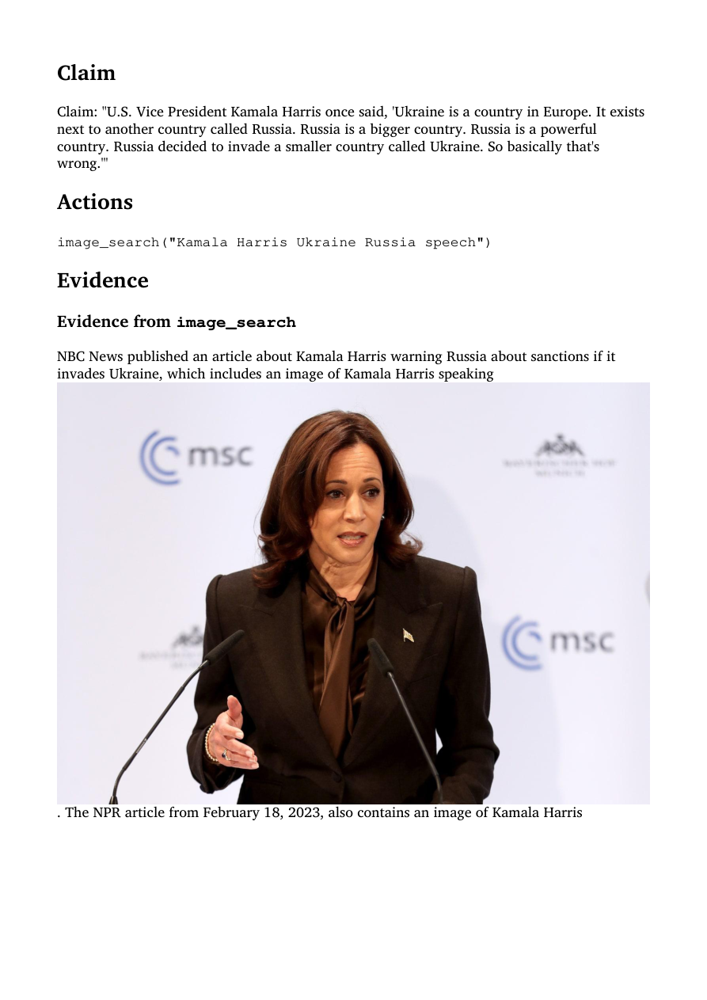

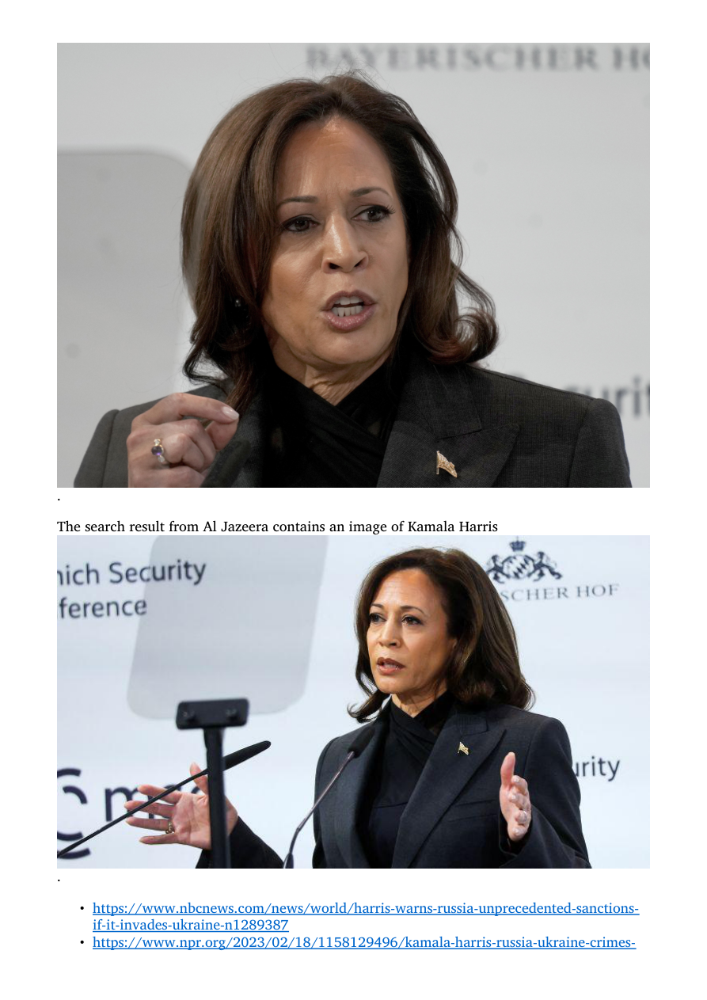

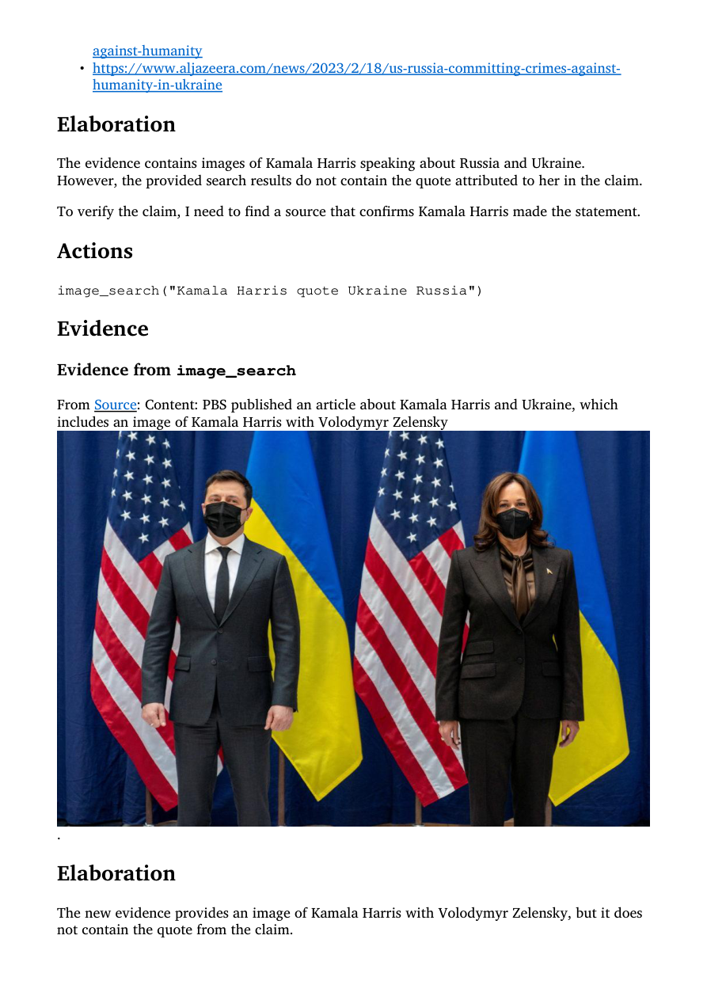

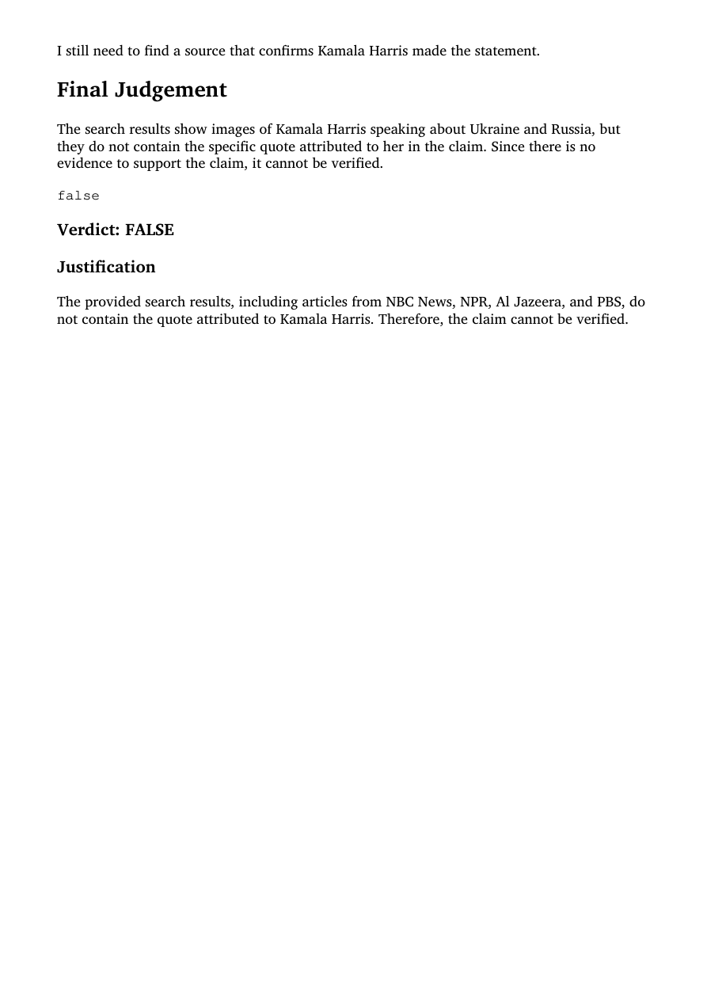

In [87]:
## 1) Qualitative analyze first claim (index = 8) in all three runs


pdf_path_run1 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run1/DEFAME_output/2025-08-29_22-35 no_web_search/fact-checks/32/report.pdf"
pdf_path_run2 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run2/DEFAME_output/2025-08-29_22-57 no_web_search/fact-checks/32/report.pdf"
pdf_path_run3 = "../../model_results/ukraine_russia/summary_dynamic_no_web_search/run3/DEFAME_output/2025-08-29_23-19 no_web_search/fact-checks/32/report.pdf"

#display_pdf_all_pages(pdf_path_run1)
#display_pdf_all_pages(pdf_path_run2)
display_pdf_all_pages(pdf_path_run3)




- reasons for wrong predictions:
    - run 1: 
        - used tools: image search
        - Could not retrieve enough relevant evidence to make the correct prediciton (web search would have been necessary) -> could not verify the exact quote of Kamala Harris

    - run 2: 
        - used tools: image search
        - same as run 1

    - run 3: 
        - used tools: image search
        - same as run 1&2


In [88]:
# Create dictionaries for each claim's reasons for wrong predictions -> will later be used to make a nice df for a better overview of most common error reasons


error_reasons_data.update({
    # DEFAME w/o RIS
    32: {
        'variant': 'w/o_web_search',
        'claim_type': 'Text-Only',
        'primary_reason': 'Tool limitation: Could not retrieve enough relevant evidence without web search to make the correct prediciton.',
        'secondary_reason': '',
        'tool_limitation': 'Could not retrieve enough relevant evidence without web search to make the correct prediciton.',
        'evidence_quality': ''
    }})

In [89]:
error_reasons_data

{18: {'variant': 'w/o_web_search',
  'claim_type': 'Text-Only',
  'primary_reason': 'News sources contain wrong/misleading/ambigious headlines and/or information: Quran Burning vs Treason.',
  'secondary_reason': '',
  'tool_limitation': '',
  'evidence_quality': 'Misleading'},
 25: {'variant': 'w/o_web_search',
  'claim_type': 'Text-Only',
  'primary_reason': 'Tool limitation: Could not retrieve enough relevant evidence without web search to make the correct prediciton.',
  'secondary_reason': '',
  'tool_limitation': 'Could not retrieve enough relevant evidence without web search to make the correct prediciton.',
  'evidence_quality': ''},
 28: {'variant': 'w/o_web_search',
  'claim_type': 'Text-Only',
  'primary_reason': 'Claim ambigiuity. Mismatch between fact-checking website evidence and retrieved newspaper evidence.  ',
  'secondary_reason': ' Snopes based its fact-check on criticisms around military aid, the retrieved newspapers confirm the criticism but not the military aid pa

#### 2.2.2) Qualitative Analyze the claims in DEFAME w/o RIS

#### 1) claim index: 31 



📄 Showing ALL 2 pages:


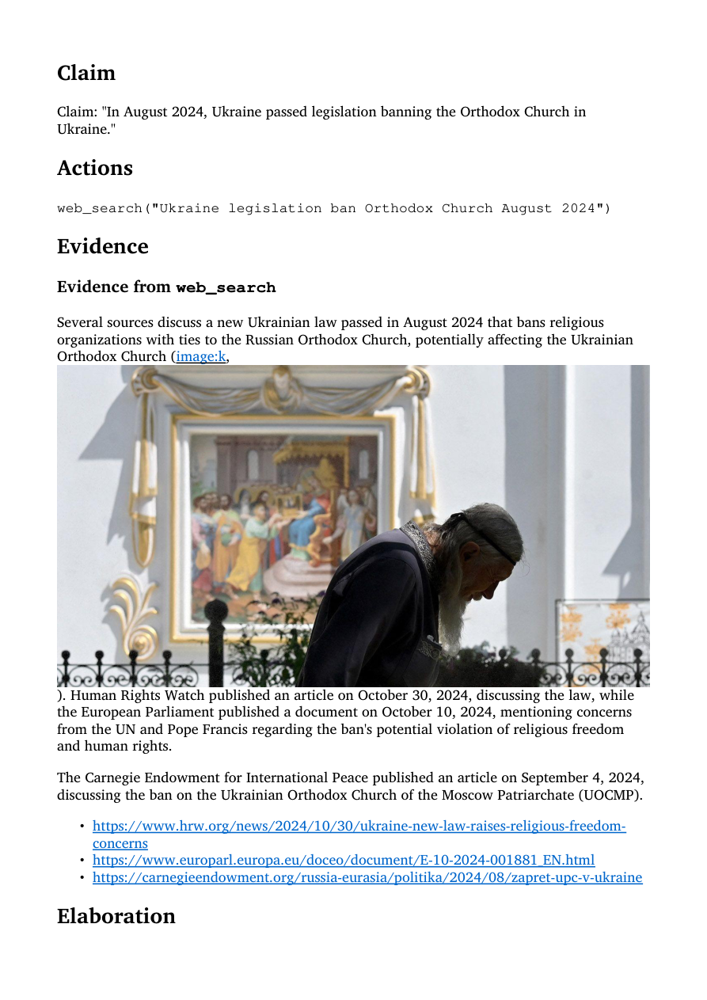

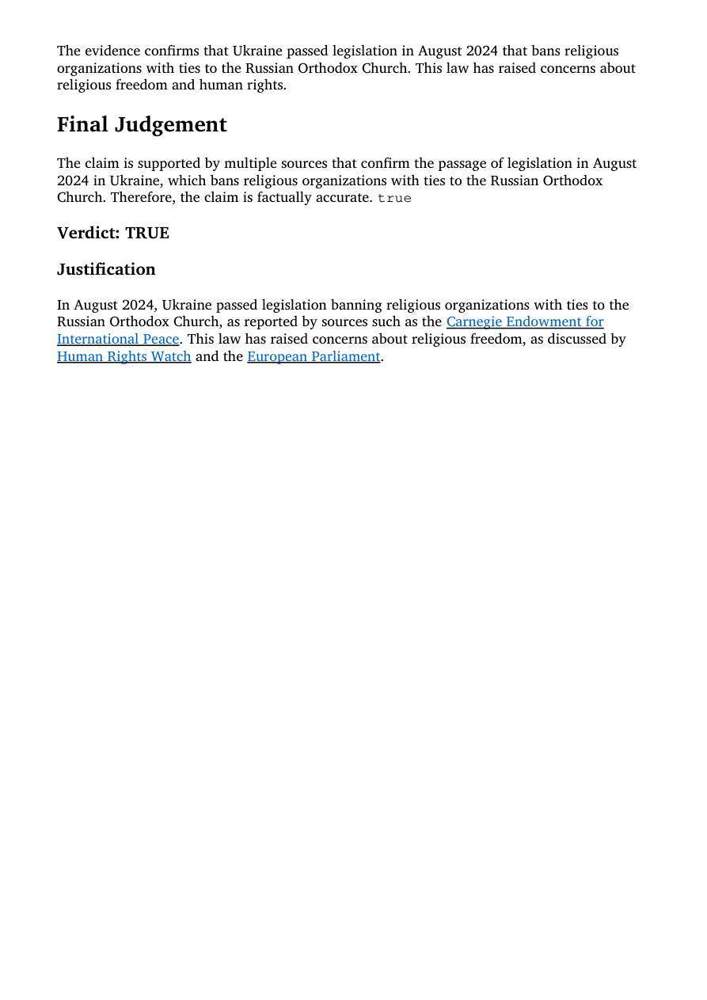

In [90]:
## 1) Qualitative analyze first claim (index = 8) in all three runs



pdf_path_run1 = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run1/DEFAME_output/2025-08-30_07-40 no_ris/fact-checks/31/report.pdf"
pdf_path_run2 = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run2/DEFAME_output/2025-08-30_08-08 no_ris/fact-checks/31/report.pdf"
pdf_path_run3 = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run3/DEFAME_output/2025-08-30_08-46 no_ris/fact-checks/31/report.pdf"

#display_pdf_all_pages(pdf_path_run1)
#display_pdf_all_pages(pdf_path_run2)
display_pdf_all_pages(pdf_path_run3)


- reasons for wrong predictions:
    - run 1: 
        - used tools: web search
        - Ambigious/misleading headlines or entire content of newspaper (Reuters, Moscow Times) about the sentence (Quran Burning vs Treason)

    - run 2: 
        - used tools: web search
        - same as run 1

    - run 3: 
        - used tools: web search
        - same as run 1&2


In [91]:
# Create dictionaries for each claim's reasons for wrong predictions -> will later be used to make a nice df for a better overview of most common error reasons


error_reasons_data.update({
    # DEFAME w/o RIS
    31: {
        'variant': 'w/o_web_search, w/o_RIS',
        'claim_type': 'Text-Only',
        'primary_reason': 'News sources contain misleading/wrong headlines and/or content: Orthodox Church of Ukriane vs Ukrainian Orthodox Church.',
        'secondary_reason': '',
        'tool_limitation': '',
        'evidence_quality': 'Misleading'
    }})

#### 2) claim index: 48 



📄 Showing ALL 7 pages:


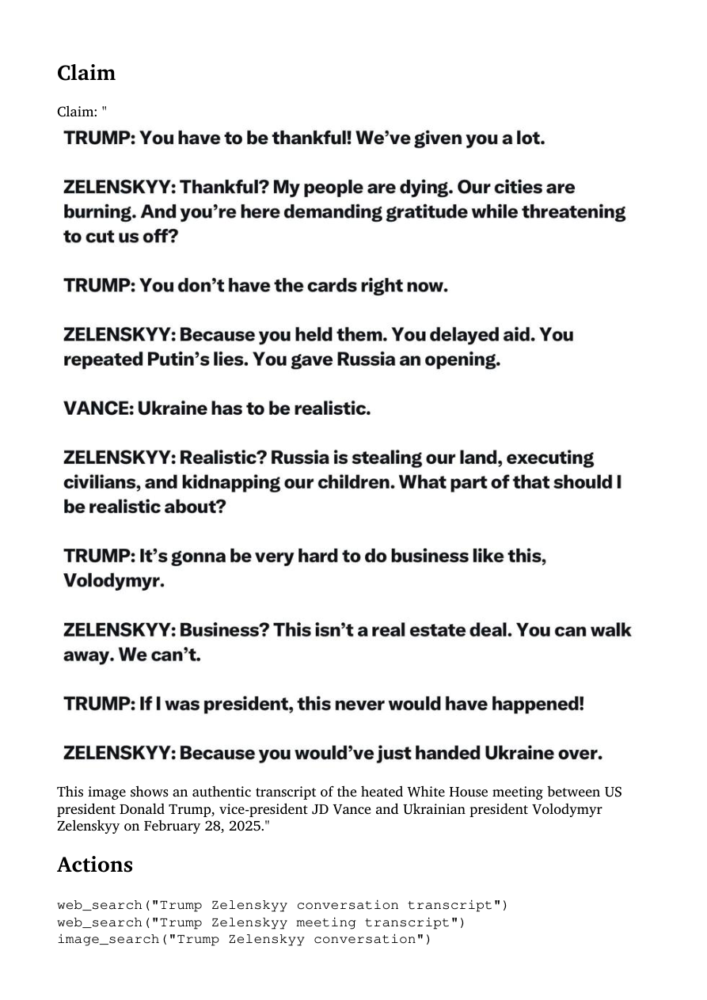

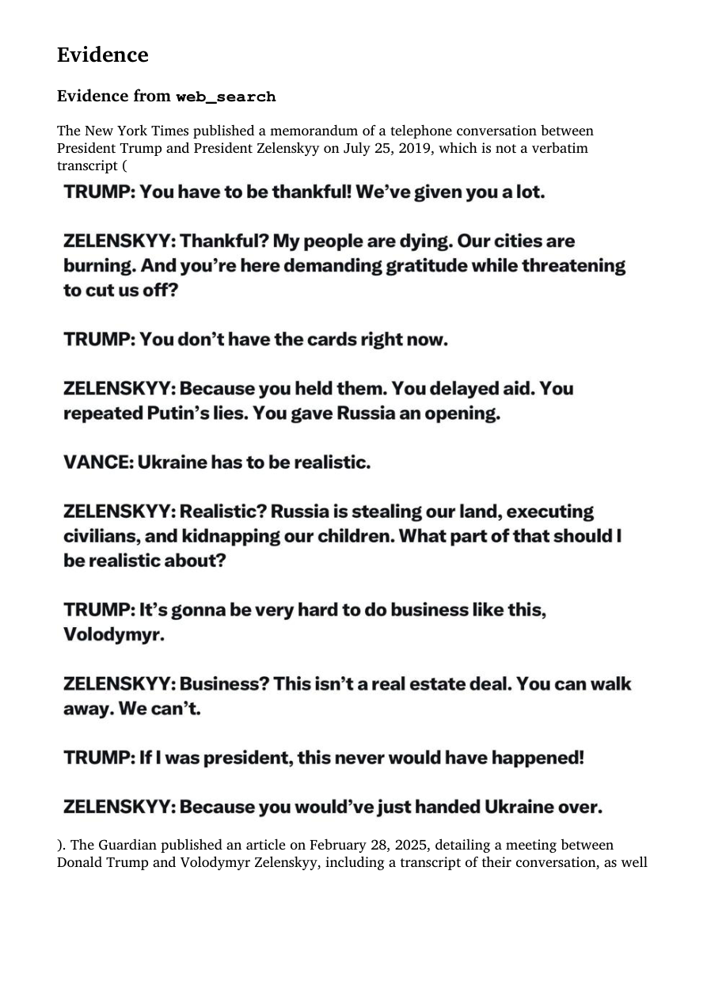

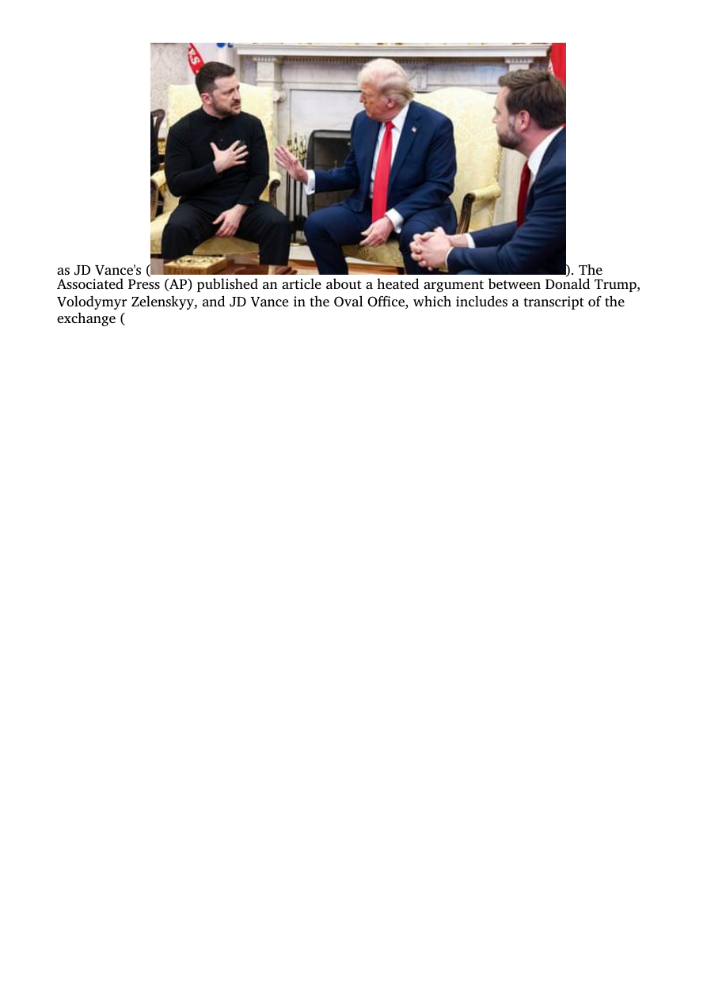

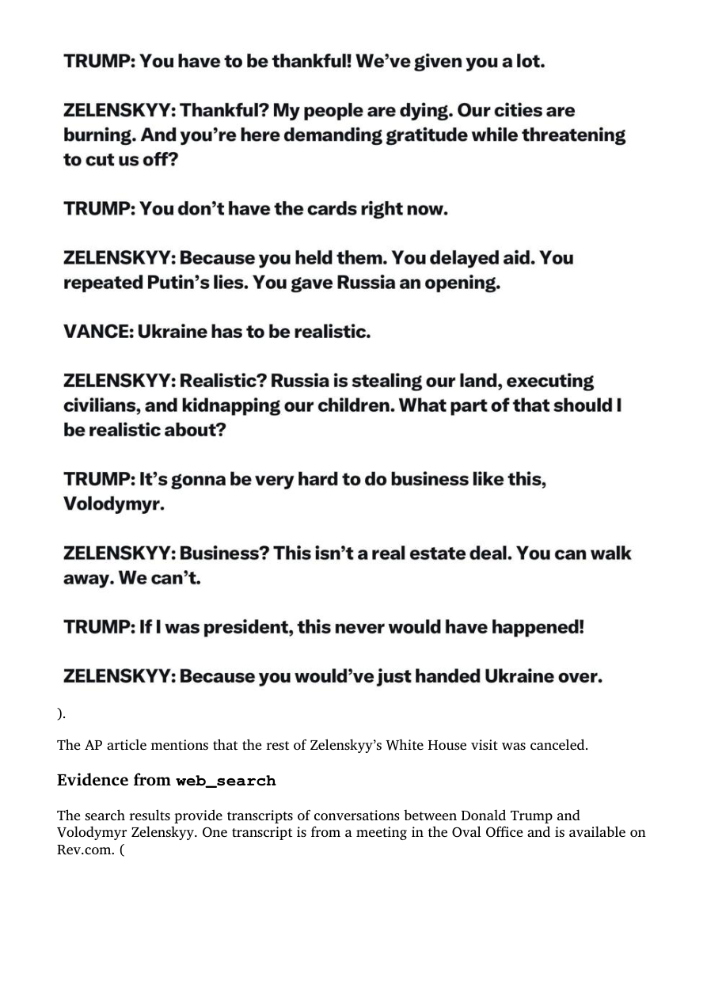

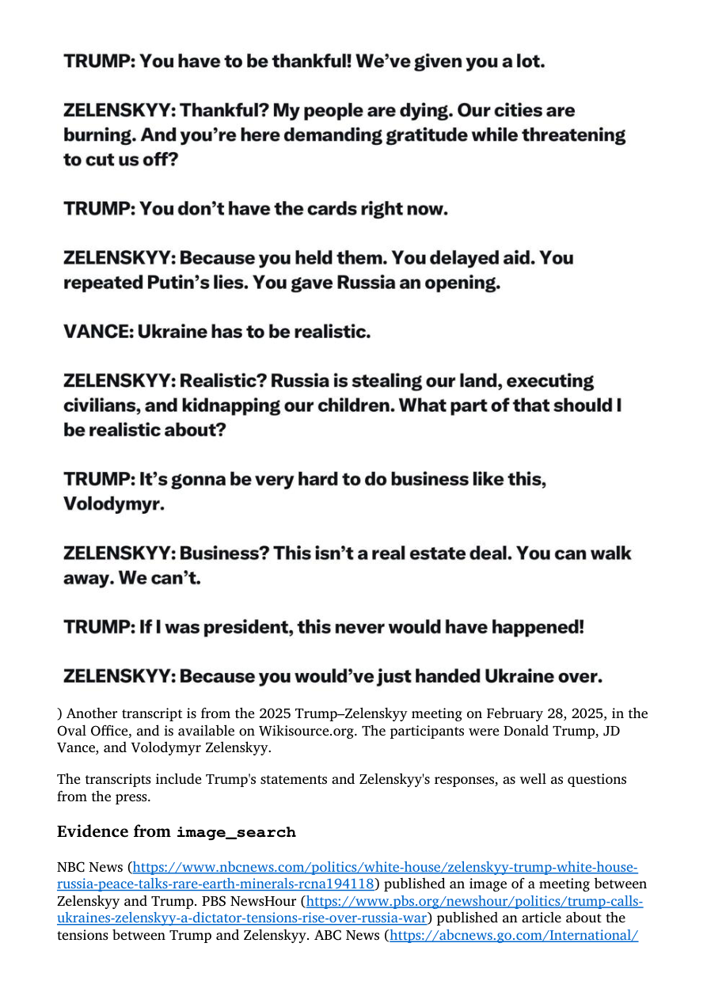

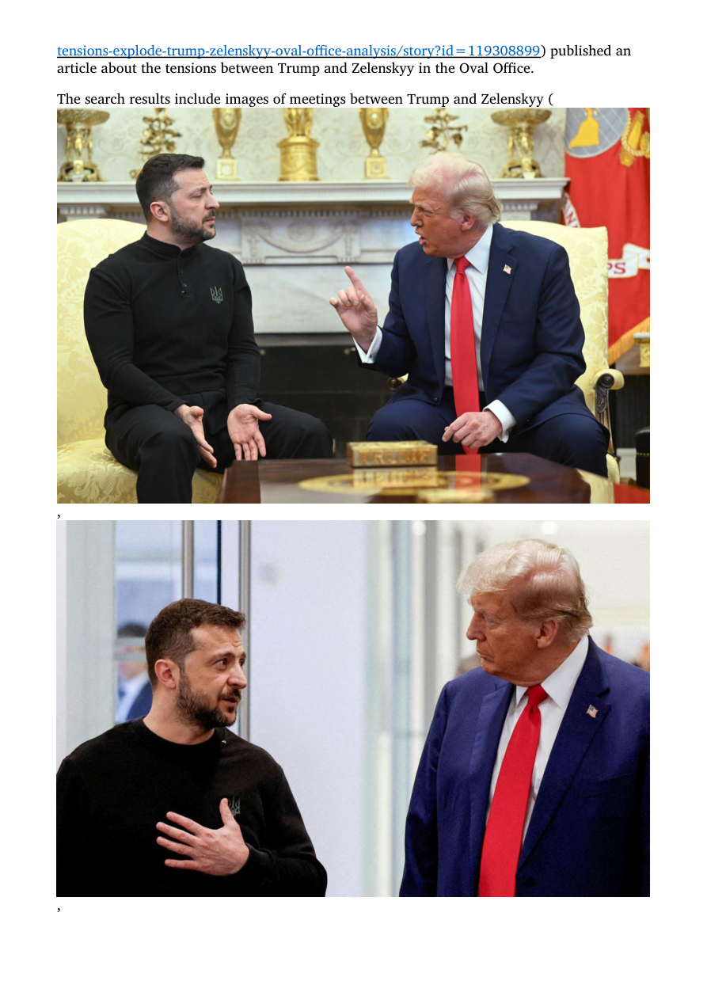

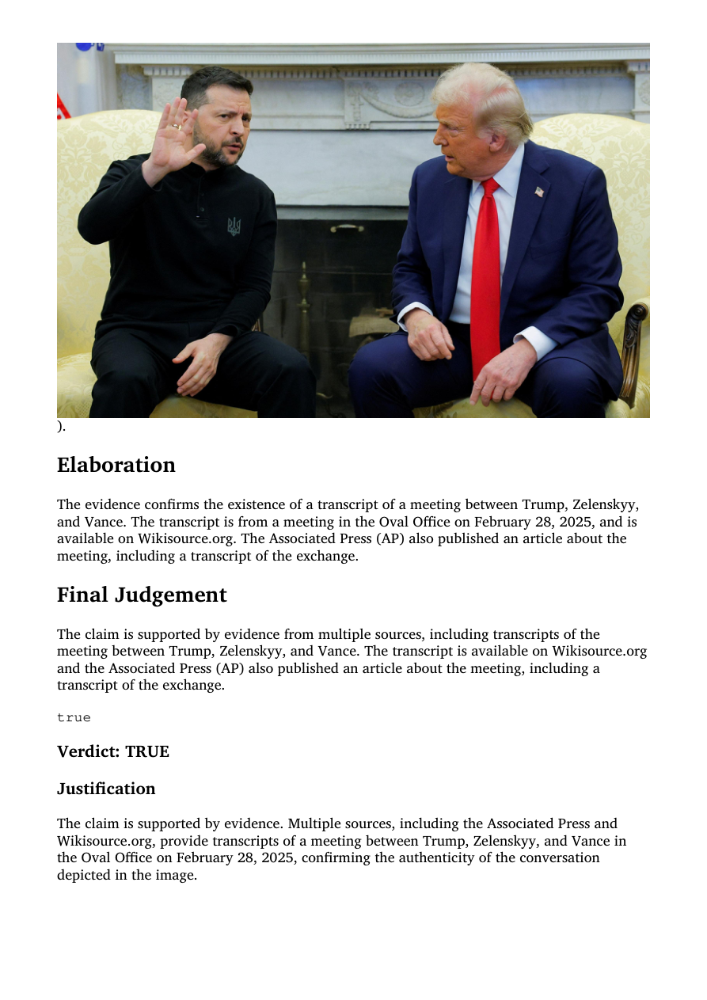

In [92]:
## 1) Qualitative analyze first claim (index = 8) in all three runs



pdf_path_run1 = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run1/DEFAME_output/2025-08-30_07-40 no_ris/fact-checks/48/report.pdf"
pdf_path_run2 = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run2/DEFAME_output/2025-08-30_08-08 no_ris/fact-checks/48/report.pdf"
pdf_path_run3 = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run3/DEFAME_output/2025-08-30_08-46 no_ris/fact-checks/48/report.pdf"

#display_pdf_all_pages(pdf_path_run1)
#display_pdf_all_pages(pdf_path_run2)
display_pdf_all_pages(pdf_path_run3)


- reasons for wrong predictions:
    - run 1: 
        - used tools: web search, image_search
        - The model did not check/verify the actual content of the (AI) image (transcript). Just checked for existence of transcipt
        - The context of the retrieved evidence makes the claim highly plausible

    - run 2: 
        - used tools: web search, image_search
        - same as run 1

    - run 3: 
        - used tools: web search, image_search
        - same as run 1&2


In [93]:
# Create dictionaries for each claim's reasons for wrong predictions -> will later be used to make a nice df for a better overview of most common error reasons


error_reasons_data.update({
    # DEFAME w/o RIS
    48: {
        'variant': 'w/o_RIS',
        'claim_type': 'Altered Image',
        'primary_reason': 'The model did not check or compare the actual content of the Altered image with the retrieved evidence.',
        'secondary_reason': 'The context of the retrieved evidence makes the claim highly plausible.',
        'tool_limitation': '',
        'evidence_quality': ''
    }})

#### 3) claim index: 63 



📄 Showing ALL 2 pages:


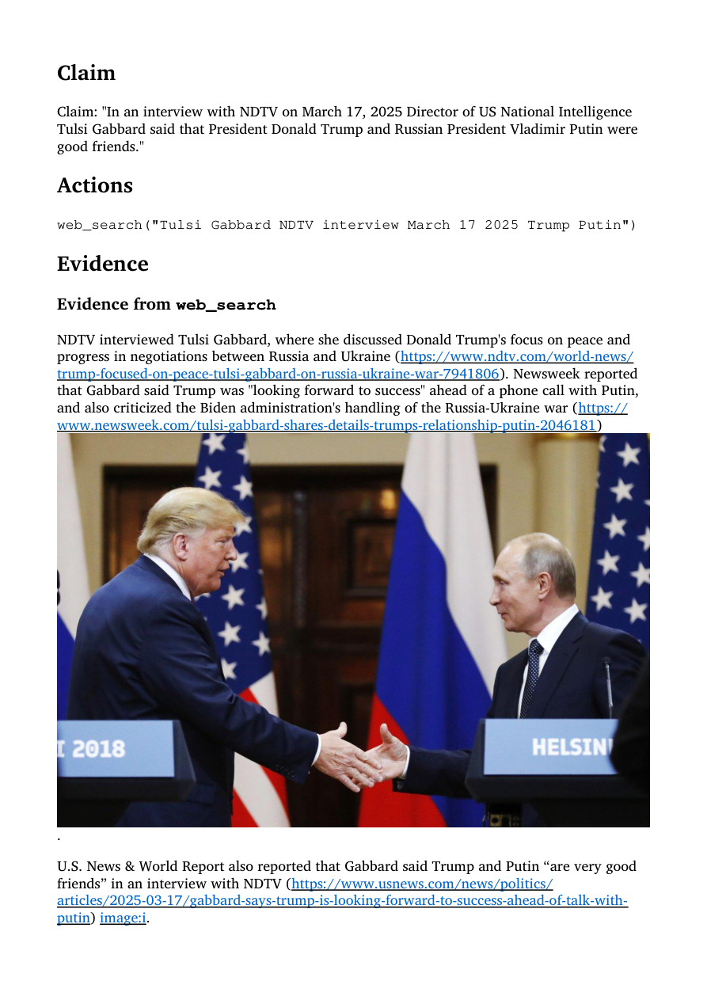

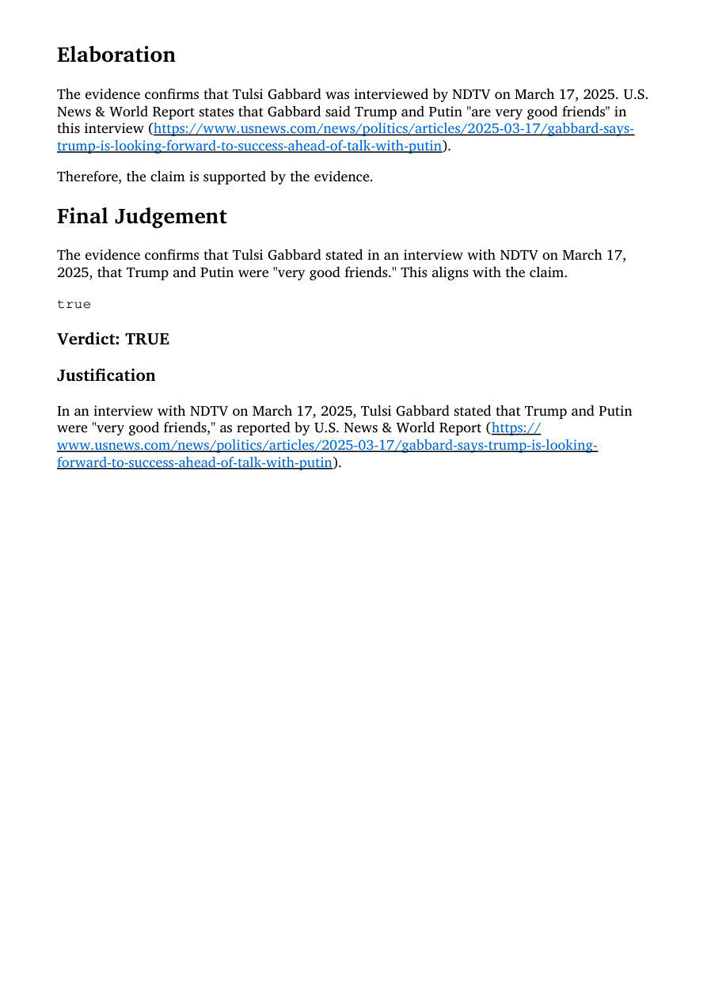

In [94]:
## 1) Qualitative analyze first claim (index = 8) in all three runs



pdf_path_run1 = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run1/DEFAME_output/2025-08-30_07-40 no_ris/fact-checks/63/report.pdf"
pdf_path_run2 = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run2/DEFAME_output/2025-08-30_08-08 no_ris/fact-checks/63/report.pdf"
pdf_path_run3 = "../../model_results/ukraine_russia/summary_dynamic_no_ris/run3/DEFAME_output/2025-08-30_08-46 no_ris/fact-checks/63/report.pdf"

#display_pdf_all_pages(pdf_path_run1)
#display_pdf_all_pages(pdf_path_run2)
display_pdf_all_pages(pdf_path_run3)


- reasons for wrong predictions:
    - run 1: 
        - used tools: web search

    - run 2: 
        - used tools: web search
        - same as run 1

    - run 3: 
        - used tools: web search
        - same as run 1&2


In [95]:
# Create dictionaries for each claim's reasons for wrong predictions -> will later be used to make a nice df for a better overview of most common error reasons
error_reasons_data.update({
    # DEFAME w/o RIS
    63: {
        'variant': 'w/o_RIS',
        'claim_type': 'Text-Only',
        'primary_reason': 'News sources contain factually wrong information',
        'secondary_reason': '',
        'tool_limitation': '',
        'evidence_quality': 'Low and limited: DEFAME only used one newspaper article as source.'
    }})

#### 2.2.3) Qualitative Analyze the claims in DEFAME w/o Geolocate

- same claims as without RIS (probably the same reasons as before, still check it)

#### 1) claim index: 31 



📄 Showing ALL 2 pages:


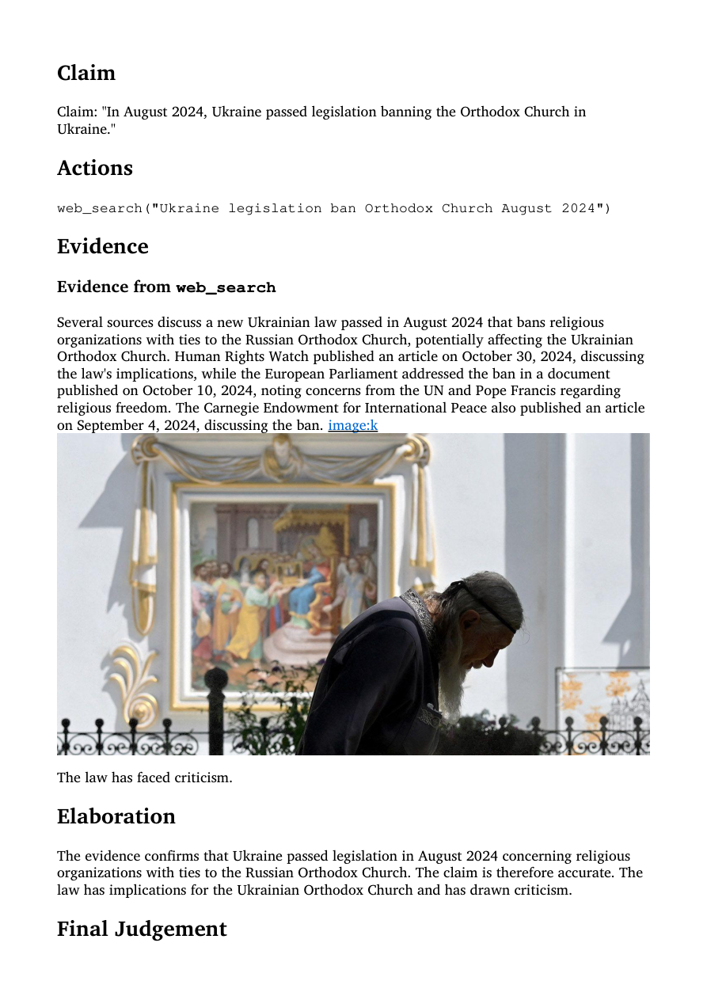

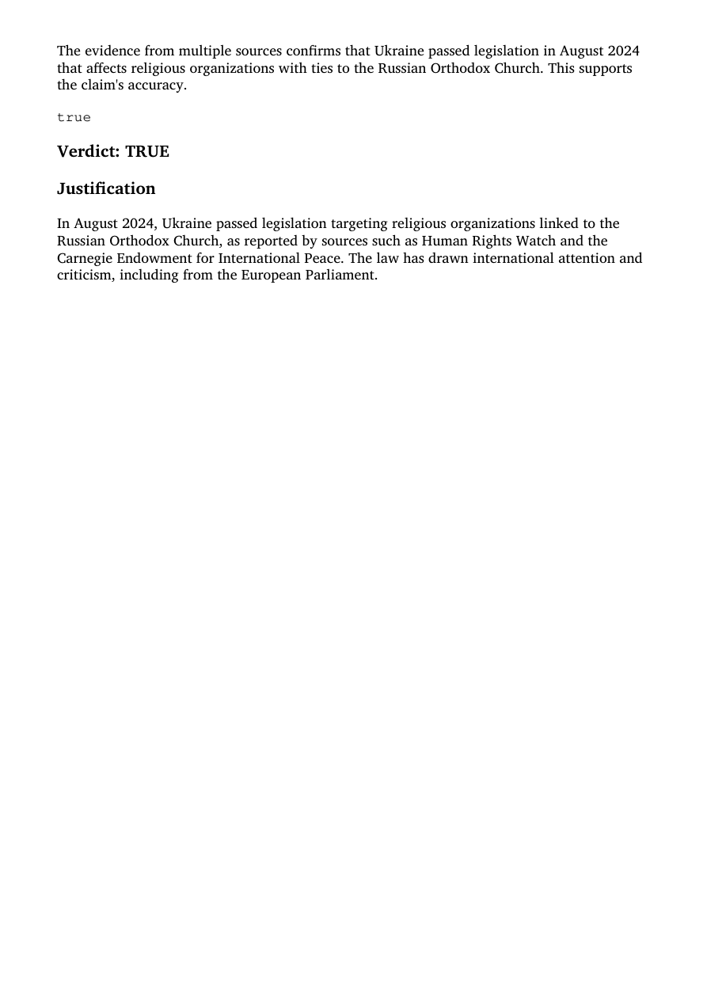

In [96]:
## 1) Qualitative analyze first claim (index = 8) in all three runs



pdf_path_run1 = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run1/DEFAME_output/2025-08-31_17-37 no_geolocate/fact-checks/31/report.pdf"
pdf_path_run2 = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run2/DEFAME_output/2025-08-31_18-27 no_geolocate/fact-checks/31/report.pdf"
pdf_path_run3 = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run3/DEFAME_output/2025-08-31_19-34 no_geolocate/fact-checks/31/report.pdf"


display_pdf_all_pages(pdf_path_run1)
#display_pdf_all_pages(pdf_path_run2)
#display_pdf_all_pages(pdf_path_run3)


- reasons for wrong predictions:
    - run 1: 
        - used tools: web search
        - Ambigious/misleading headlines or entire content of newspaper (Reuters, Moscow Times) about the sentence (Quran Burning vs Treason)

    - run 2: 
        - used tools: web search
        - same as run 1

    - run 3: 
        - used tools: web search
        - same as run 1&2


In [97]:
# Create dictionaries for each claim's reasons for wrong predictions -> will later be used to make a nice df for a better overview of most common error reasons



error_reasons_data.update({
    # DEFAME w/o RIS
    31: {
        'variant': 'w/o_web_search, w/o_RIS, w/o_geolocate',
        'claim_type': 'Text-Only',
        'primary_reason': 'News sources contain misleading/wrong headlines and/or content: Orthodox Church of Ukriane vs Ukrainian Orthodox Church.',
        'secondary_reason': '',
        'tool_limitation': '',
        'evidence_quality': 'Misleading'
    }})

#### 2) claim index: 48 



📄 Showing ALL 7 pages:


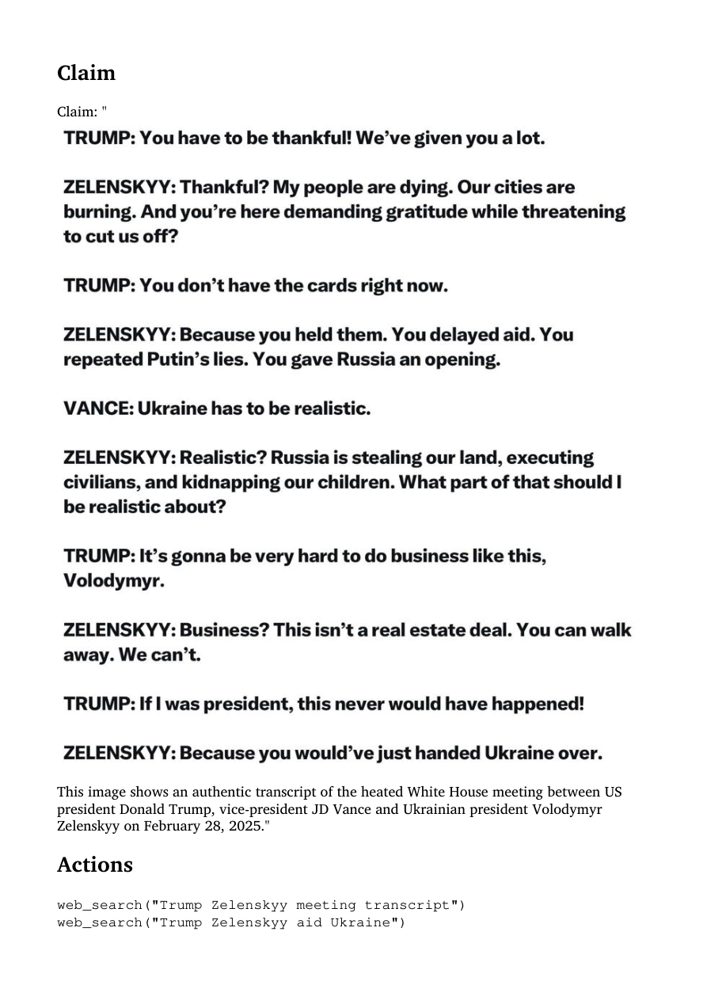

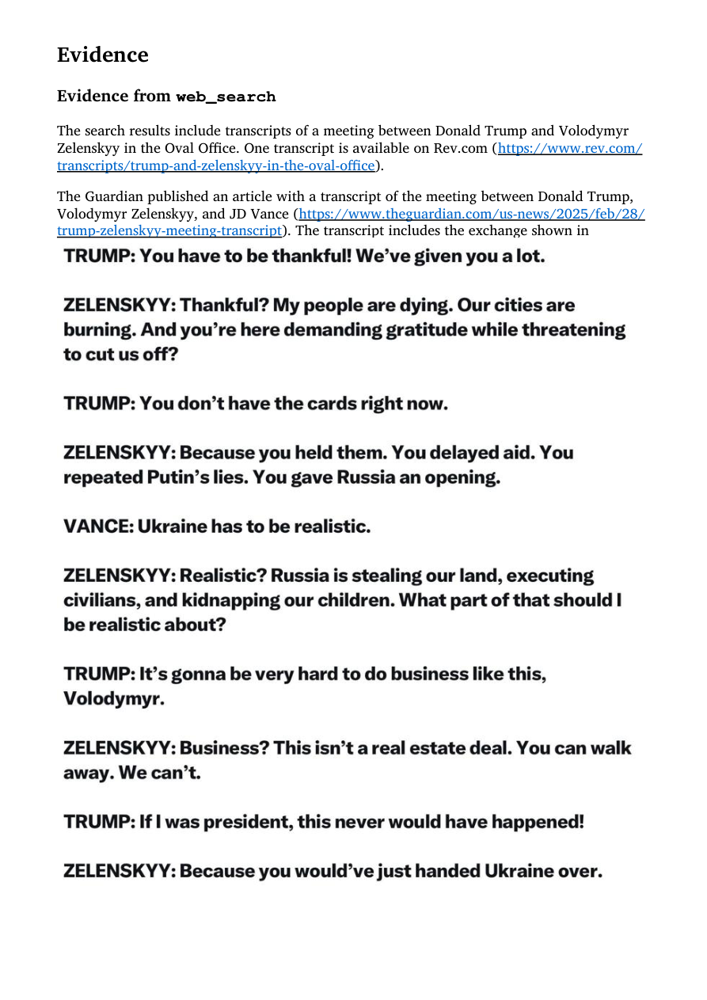

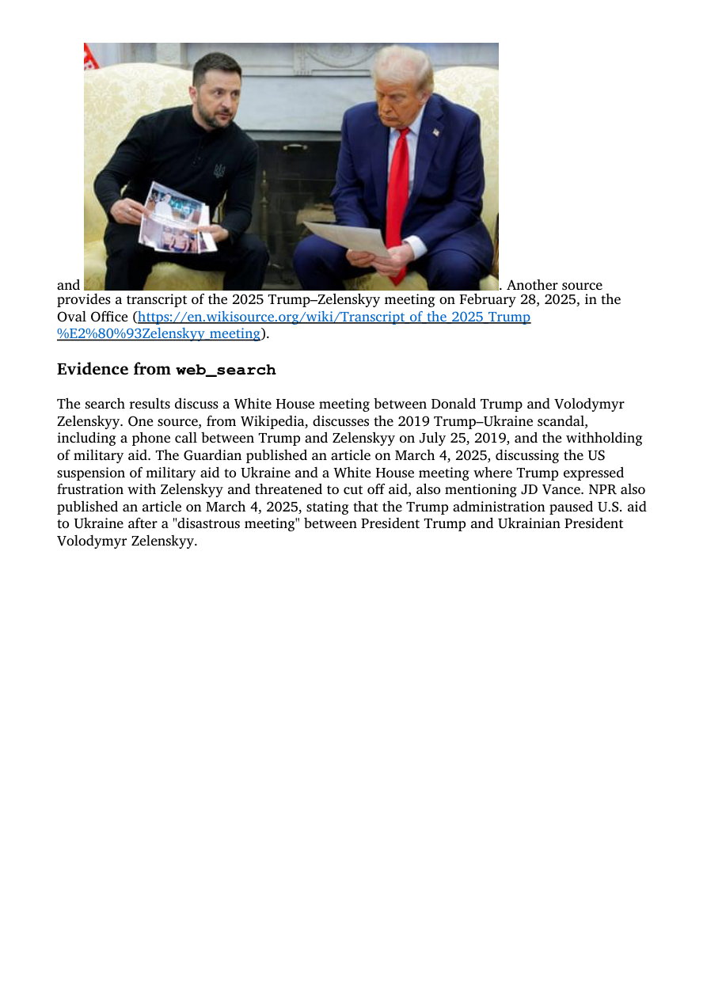

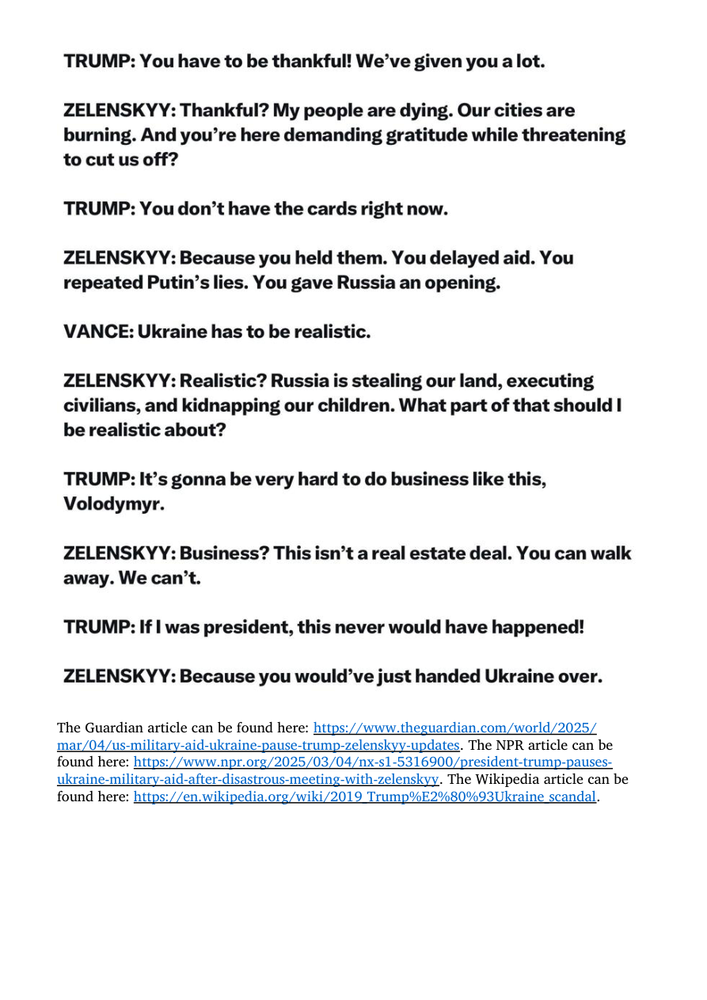

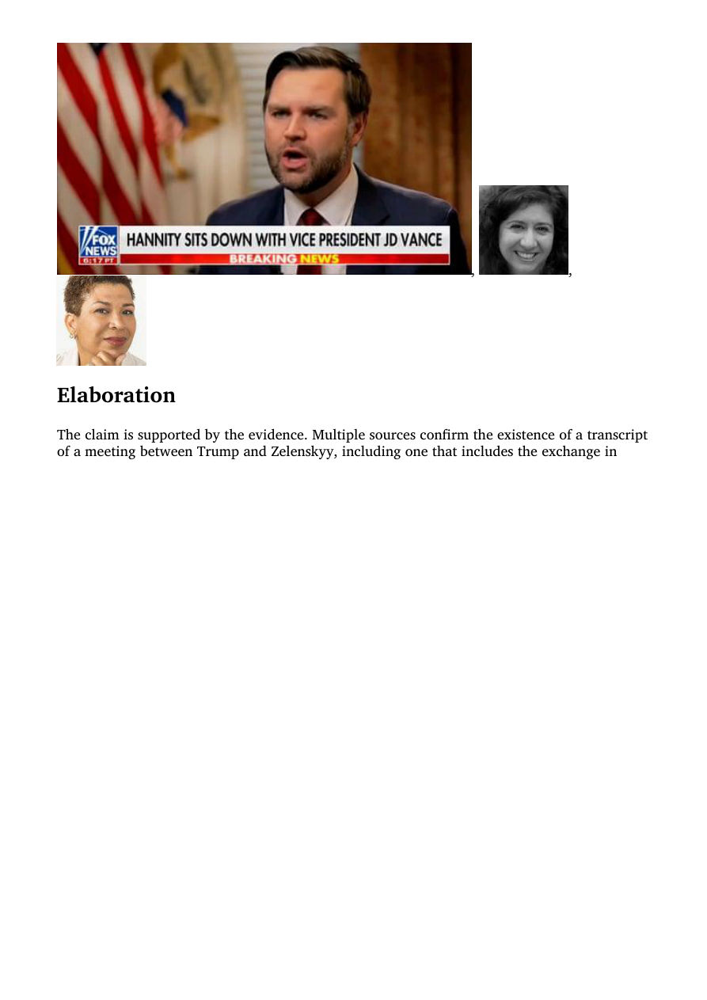

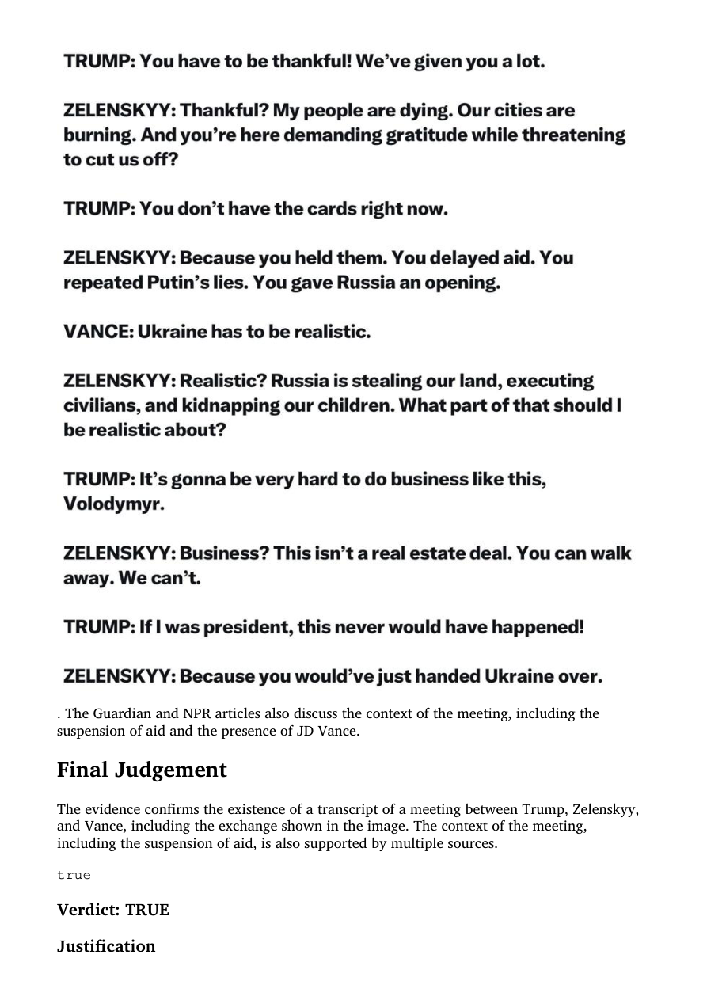

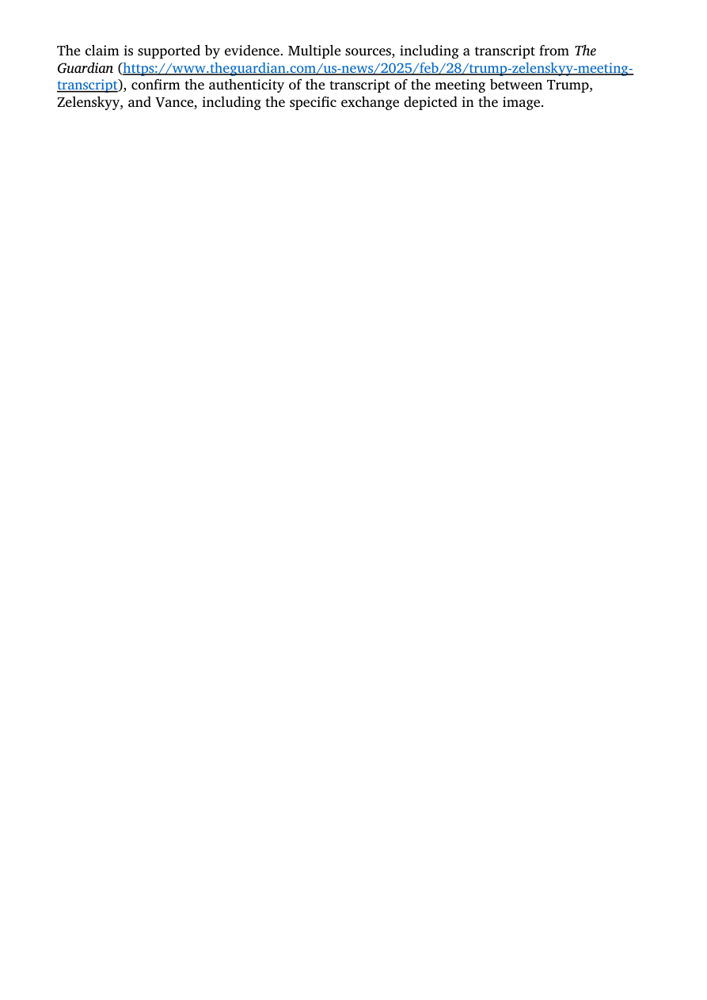

In [98]:
## 1) Qualitative analyze first claim (index = 8) in all three runs



pdf_path_run1 = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run1/DEFAME_output/2025-08-31_17-37 no_geolocate/fact-checks/48/report.pdf"
pdf_path_run2 = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run2/DEFAME_output/2025-08-31_18-27 no_geolocate/fact-checks/48/report.pdf"
pdf_path_run3 = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run3/DEFAME_output/2025-08-31_19-34 no_geolocate/fact-checks/48/report.pdf"

#display_pdf_all_pages(pdf_path_run1)
#display_pdf_all_pages(pdf_path_run2)
display_pdf_all_pages(pdf_path_run3)


- reasons for wrong predictions:
    - run 1: 
        - used tools: web search, image_search
        - The model did not check/verify the actual content of the (AI) image (transcript). Just checked for existence of transcipt
        - The context of the retrieved evidence makes the claim highly plausible

    - run 2: 
        - used tools: web search, image_search
        - same as run 1

    - run 3: 
        - used tools: web search, image_search
        - same as run 1&2


In [99]:
# Create dictionaries for each claim's reasons for wrong predictions -> will later be used to make a nice df for a better overview of most common error reasons


error_reasons_data.update({
    # DEFAME w/o RIS
    48: {
        'variant': 'w/o_RIS, w/o_geolocate',
        'claim_type': 'Altered Image',
        'primary_reason': 'The model did not check or compare the actual content of the AI image with the retrieved evidence.',
        'secondary_reason': 'The context of the retrieved evidence makes the claim highly plausible.',
        'tool_limitation': '',
        'evidence_quality': ''
    }})

#### 3) claim index: 63 



📄 Showing ALL 2 pages:


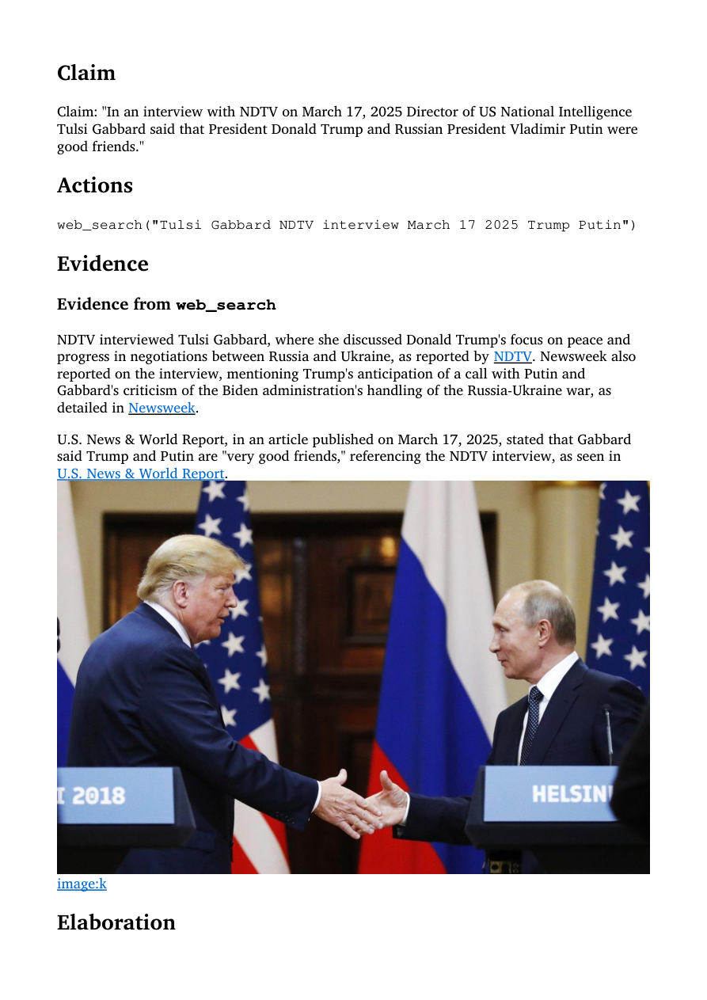

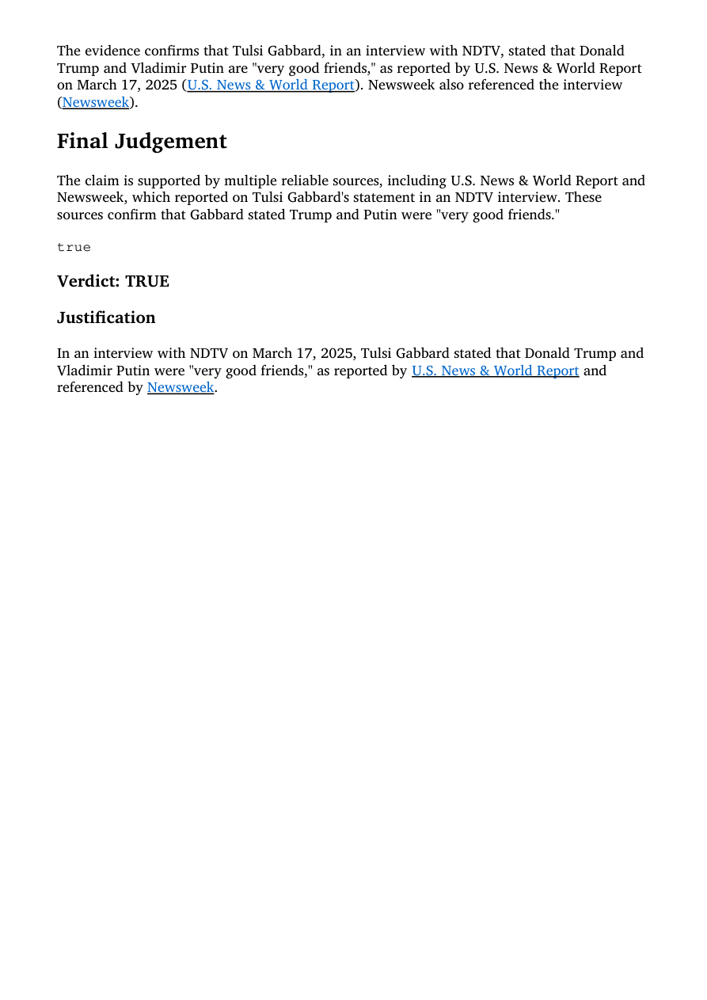

In [100]:
## 1) Qualitative analyze first claim (index = 8) in all three runs



pdf_path_run1 = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run1/DEFAME_output/2025-08-31_17-37 no_geolocate/fact-checks/63/report.pdf"
pdf_path_run2 = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run2/DEFAME_output/2025-08-31_18-27 no_geolocate/fact-checks/63/report.pdf"
pdf_path_run3 = "../../model_results/ukraine_russia/summary_dynamic_no_geolocate/run3/DEFAME_output/2025-08-31_19-34 no_geolocate/fact-checks/63/report.pdf"

#display_pdf_all_pages(pdf_path_run1)
#display_pdf_all_pages(pdf_path_run2)
display_pdf_all_pages(pdf_path_run3)


- reasons for wrong predictions:
    - run 1: 
        - used tools: web search
        - News sources contain factually wrong information

    - run 2: 
        - used tools: web search
        - same as run 1

    - run 3: 
        - used tools: web search
        - same as run 1&2


In [101]:
# Create dictionaries for each claim's reasons for wrong predictions -> will later be used to make a nice df for a better overview of most common error reasons
error_reasons_data.update({
    # DEFAME w/o RIS
    63: {
        'variant': 'w/o_RIS, w/o_geolocate',
        'claim_type': 'Text-Only',
        'primary_reason': 'News sources contain factually wrong information',
        'secondary_reason': '',
        'tool_limitation': '',
        'evidence_quality': 'Low and limited: DEFAME only used one newspaper article as source.'
    }})

#### 2.2.4) Qualitative Analyze the claims in DEFAME w/o Image Search



#### 1) claim index: 31 



📄 Showing ALL 2 pages:


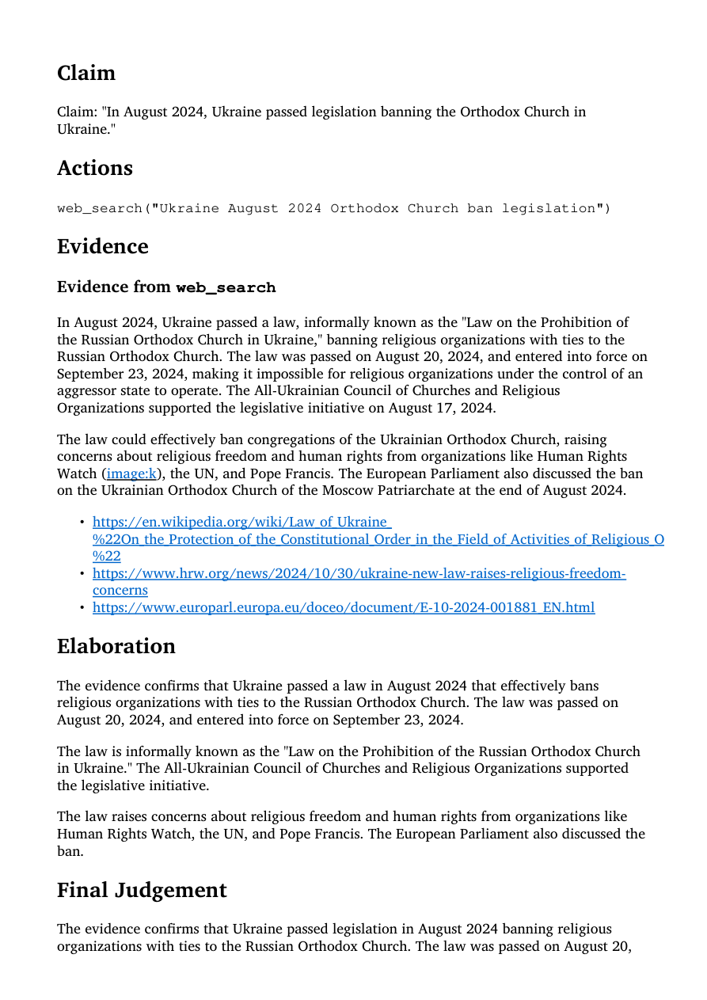

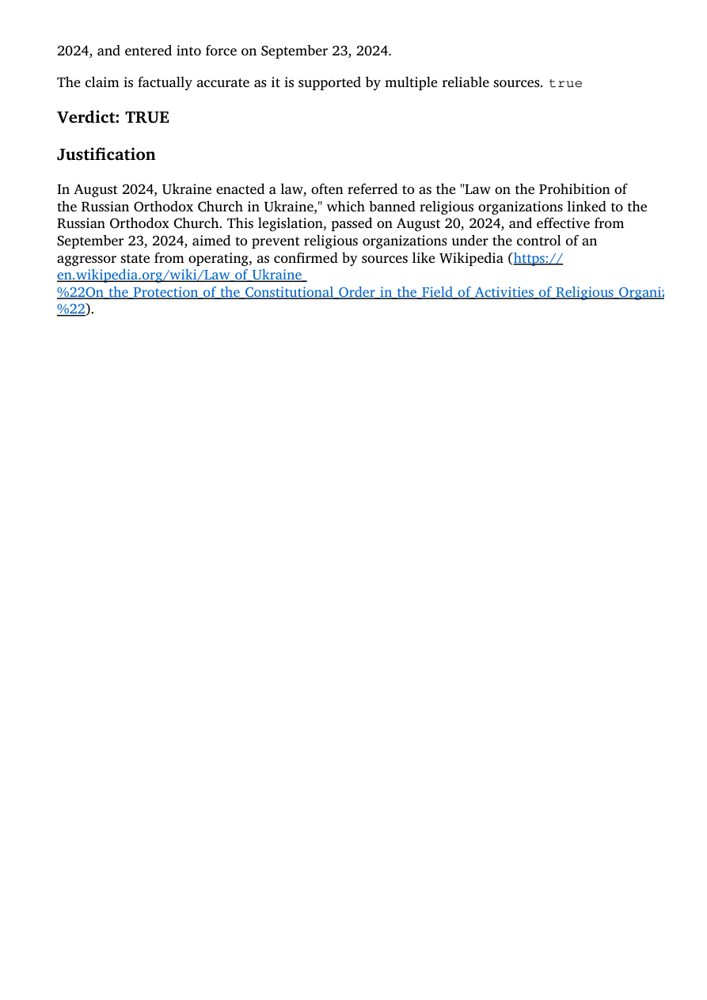

In [102]:
## 1) Qualitative analyze first claim (index = 8) in all three runs


pdf_path_run1 = "../../model_results/ukraine_russia/summary_dynamic_no_image_search/run1/DEFAME_output/2025-08-30_21-34 no_image_search/fact-checks/31/report.pdf"
pdf_path_run2 = "../../model_results/ukraine_russia/summary_dynamic_no_image_search/run2/DEFAME_output/2025-08-30_22-06 no_image_search/fact-checks/31/report.pdf"
pdf_path_run3 = "../../model_results/ukraine_russia/summary_dynamic_no_image_search/run3/DEFAME_output/2025-08-30_22-40 no_image_search/fact-checks/31/report.pdf"



#display_pdf_all_pages(pdf_path_run1)
#display_pdf_all_pages(pdf_path_run2)
display_pdf_all_pages(pdf_path_run3)


- reasons for wrong predictions:
    - run 1: 
        - used tools: web search
        - Ambigious/misleading headlines or entire content of newspaper (Reuters, Moscow Times) about the sentence (Quran Burning vs Treason)

    - run 2: 
        - used tools: web search
        - same as run 1

    - run 3: 
        - used tools: web search
        - same as run 1&2


In [103]:
# Create dictionaries for each claim's reasons for wrong predictions -> will later be used to make a nice df for a better overview of most common error reasons


error_reasons_data.update({
    # DEFAME w/o RIS
    31: {
        'variant': 'w/o_web_search, w/o_RIS, w/o_geolocate, w/o_image_search',
        'claim_type': 'Text-Only',
        'primary_reason': 'News sources contain misleading/wrong headlines and/or content: Orthodox Church of Ukriane vs Ukrainian Orthodox Church.',
        'secondary_reason': '',
        'tool_limitation': '',
        'evidence_quality': 'Misleading'
    }})

In [104]:
error_reasons_data

{18: {'variant': 'w/o_web_search',
  'claim_type': 'Text-Only',
  'primary_reason': 'News sources contain wrong/misleading/ambigious headlines and/or information: Quran Burning vs Treason.',
  'secondary_reason': '',
  'tool_limitation': '',
  'evidence_quality': 'Misleading'},
 25: {'variant': 'w/o_web_search',
  'claim_type': 'Text-Only',
  'primary_reason': 'Tool limitation: Could not retrieve enough relevant evidence without web search to make the correct prediciton.',
  'secondary_reason': '',
  'tool_limitation': 'Could not retrieve enough relevant evidence without web search to make the correct prediciton.',
  'evidence_quality': ''},
 28: {'variant': 'w/o_web_search',
  'claim_type': 'Text-Only',
  'primary_reason': 'Claim ambigiuity. Mismatch between fact-checking website evidence and retrieved newspaper evidence.  ',
  'secondary_reason': ' Snopes based its fact-check on criticisms around military aid, the retrieved newspapers confirm the criticism but not the military aid pa

In [105]:
# Create comprehensive dataframe with all unique claims and their errors across variants
all_claims_data = []

# Get all unique claims
all_claims = set()
for claims_list in defame_variants_claims.values():
    all_claims.update(claims_list)

# Process each unique claim
for claim_id in sorted(all_claims):
    # Find all variants where this claim appears
    variants_with_claim = []
    for variant, claims in defame_variants_claims.items():
        if claim_id in claims:
            variants_with_claim.append(variant)
    
    # Get the error analysis for this claim (use first variant's analysis)
    primary_variant = variants_with_claim[0]
    

    
    if claim_id in error_reasons_data:
        error_data = error_reasons_data[claim_id].copy()
        error_data['claim_index'] = claim_id
        error_data['variants_with_error'] = ', '.join(variants_with_claim)
        
        # Add frequency from top 10 table where available
        frequency_map = {31: 14, 63: 12, 48: 11, 28: 10, 18: 9, 32: 8, 25: 3}
        error_data['frequency_in_top10'] = frequency_map.get(claim_id, 0)
    else:
        # Shouldn't happen but handle gracefully
        continue
    
    all_claims_data.append(error_data)

# Create DataFrame
error_analysis_df = pd.DataFrame(all_claims_data)

# Reorder columns for better readability
column_order = [
    'claim_index', 'claim_type', 'variants_with_error', 'frequency_in_top10',
    'primary_reason', 'secondary_reason', 'tool_limitation', 'evidence_quality'
]

error_analysis_df = error_analysis_df[column_order]

# Sort by frequency in top 10 errors (descending)
error_analysis_df = error_analysis_df.sort_values('frequency_in_top10', ascending=False)

# Display the dataframe
print("Error Analysis DataFrame:")
print("=" * 80)
print(error_analysis_df.to_string(index=False))
print("\n" + "=" * 80)

# # Save to CSV 
error_analysis_df.to_csv('ukraine_russia_qualitative_analysis_consistently_wrong_predictions.csv')

# Summary statistics
print(f"\nSummary Statistics:")
print(f"Total unique claims with consistent errors: {len(error_analysis_df)}")
print(f"Claims by type:")
print(error_analysis_df['claim_type'].value_counts())
print(f"\nMost common primary reasons:")
print(error_analysis_df['primary_reason'].value_counts())

Error Analysis DataFrame:
 claim_index    claim_type                                      variants_with_error  frequency_in_top10                                                                                                           primary_reason                                                                                                                              secondary_reason                                                                                tool_limitation                                                   evidence_quality
          31     Text-Only w/o_RIS, w/o_web_search, w/o_geolocate, w/o_image_search                  14 News sources contain misleading/wrong headlines and/or content: Orthodox Church of Ukriane vs Ukrainian Orthodox Church.                                                                                                                                                                                                                             

### 2.3) Qualitative Analyze of increased False Negative Predictions w/o Web Search

In [106]:
## Load the predictions csv w/o web search


dict_defame_no_web_search_predictions_csv = load_all_predictions_csv_per_defame_variant(defame_variant="defame_no_web_search")
dict_defame_no_web_search_predictions_csv

dict_defame_no_web_search_predictions_csv_run1 = dict_defame_no_web_search_predictions_csv["defame_no_web_search_predictions_run1"]
dict_defame_no_web_search_predictions_csv_run2 = dict_defame_no_web_search_predictions_csv["defame_no_web_search_predictions_run2"]
dict_defame_no_web_search_predictions_csv_run3 = dict_defame_no_web_search_predictions_csv["defame_no_web_search_predictions_run3"]

Successfully loaded: defame_no_web_search_predictions_run1 with shape (78, 7)
Successfully loaded: defame_no_web_search_predictions_run2 with shape (79, 7)
Successfully loaded: defame_no_web_search_predictions_run3 with shape (79, 7)


In [107]:
# Get all False Negative Predictions for each run

pd.set_option('display.max_colwidth', 1000) 

print(len(dict_defame_no_web_search_predictions_csv_run1[(dict_defame_no_web_search_predictions_csv_run1["predicted"] == False) & (dict_defame_no_web_search_predictions_csv_run1["correct"] == False)]))
dict_defame_no_web_search_predictions_csv_run1[(dict_defame_no_web_search_predictions_csv_run1["predicted"] == False) & (dict_defame_no_web_search_predictions_csv_run1["correct"] == False)]

6


,sample_index,claim,predicted,target,correct,justification,gt_justification
25,25,U.S. Vice President JD Vance's cousin Nate Vance fought in Ukraine for three years during its war with Russia.,False,True,False,"The claim that U.S. Vice President J.D. Vance's cousin, Nate Vance, fought in Ukraine for three years cannot be verified. While evidence from sources like the [Kyiv Post](https://kyivpost.com/) and [SOFREP](https://sofrep.com/) confirms Nate Vance's involvement in the war in Ukraine, the provided information does not specify the duration of his service.\n","Snopes readers searched our site and submitted emails asking if the claim was true. While we could not independently confirm that the claim was true, several reputable news organizations from various countries, including CNN and French newspaper Le Figaro (archived), all reported that Vance volunteered to fight in Ukraine and served alongside Ukrainian forces for three years, and provided sufficient photographic evidence."
28,28,In March 2025 former President of Poland Lech Wałęsa wrote a letter to Donald Trump criticizing the U.S. President's decision to suspend the delivery of all U.S. military aid to Ukraine.,False,True,False,"The claim is not fully supported by the evidence. While Lech Wałęsa did write a letter to Donald Trump in March 2025, criticizing his actions related to Ukraine, the provided sources, such as the [New York Times](https://www.nytimes.com/2025/03/03/us/politics/lech-walesa-trump-letter.html), [Reuters](https://www.reuters.com/world/polish-cold-war-hero-walesa-writes-trump-expressing-horror-zelenskiy-spat-2025-03-03/), and the [Los Angeles Times](https://www.latimes.com/world-nation/story/2025-03-03/polish-democracy-hero-walesa-says-trump-treatment-of-zelensky-filled-him-with-horror), do not explicitly state that the letter criticized the suspension of U.S. military aid to Ukraine.\n","Wałęsa did post such a letter on his Facebook page. However, it is not clear whether he wrote the letter alone or in conjunction with any of its signatories. It is also not clear whether he sent the letter directly to Trump or just posted it on social media."
32,32,"U.S. Vice President Kamala Harris once said, 'Ukraine is a country in Europe. It exists next to another country called Russia. Russia is a bigger country. Russia is a powerful country. Russia decided to invade a smaller country called Ukraine. So basically that's wrong.'",False,True,False,"The claim cannot be verified. While Kamala Harris has spoken about Ukraine and Russia, the provided evidence, including articles from NBC News, NPR, Al Jazeera, Politico, The New York Times, CNN, and The Guardian, does not contain the specific quote attributed to her in the claim.\n","Harris made the statement in March 2022, responding to a journalist's request to explain the situation in Ukraine in layman's terms. She continued, ""And it goes against everything that we stand for. There are terms that we use, we say, 'We respect the sovereignty, the territorial integrity of countries,' right? Their independence. Russia has gone into Ukraine militarily, unprovoked, with no justification other than to exercise its power to take over another country."""
34,34,"In March 2025 podcaster and UFC commentator Joe Rogan said, 'I don't go to Canada anymore,' then added, 'I'd rather go to Russia.'",False,True,False,"Joe Rogan did state he would rather go to Russia than Canada, as reported by multiple news outlets, including [Newsweek](https://www.newsweek.com/joe-rogan-canada-ufc-russia-2049964), [Global News](https://globalnews.ca/news/11098769/joe-rogan-rather-go-to-russia-than-canada-ufc/), and the [Toronto Sun](https://torontosun.com/sports/mma/joe-rogan-would-rather-go-to-russia-than-ufc-event-in-canada-i-wont-be-there). However, the exact context and date of the statement are not entirely accurate.\n","Rogan laughed after making the remark but provided no direct indication that he was joking. The comment occurred during a

In [108]:
# Get all False Negative Predictions for each run

print(len(dict_defame_no_web_search_predictions_csv_run2[(dict_defame_no_web_search_predictions_csv_run2["predicted"] == False) & (dict_defame_no_web_search_predictions_csv_run2["correct"] == False)]))
dict_defame_no_web_search_predictions_csv_run2[(dict_defame_no_web_search_predictions_csv_run2["predicted"] == False) & (dict_defame_no_web_search_predictions_csv_run2["correct"] == False)]

6


,sample_index,claim,predicted,target,correct,justification,gt_justification
25,25,U.S. Vice President JD Vance's cousin Nate Vance fought in Ukraine for three years during its war with Russia.,False,True,False,"The claim that Nate Vance fought in Ukraine for three years cannot be verified. While evidence confirms that Nate Vance, the cousin of U.S. Vice President J.D. Vance, is fighting in Ukraine, none of the provided sources specify the duration of his service.\n","Snopes readers searched our site and submitted emails asking if the claim was true. While we could not independently confirm that the claim was true, several reputable news organizations from various countries, including CNN and French newspaper Le Figaro (archived), all reported that Vance volunteered to fight in Ukraine and served alongside Ukrainian forces for three years, and provided sufficient photographic evidence."
28,28,In March 2025 former President of Poland Lech Wałęsa wrote a letter to Donald Trump criticizing the U.S. President's decision to suspend the delivery of all U.S. military aid to Ukraine.,False,True,False,"The available evidence confirms that Lech Wałęsa wrote a letter to Donald Trump in March 2025, and that Trump was in a position to suspend military aid to Ukraine. However, the content of the letter is not explicitly stated in the provided evidence. Therefore, the claim cannot be fully verified.\n","Wałęsa did post such a letter on his Facebook page. However, it is not clear whether he wrote the letter alone or in conjunction with any of its signatories. It is also not clear whether he sent the letter directly to Trump or just posted it on social media."
29,29,"On Feb. 28, 2025, before a meeting with U.S. President Donald Trump, Ukraine President Volodymyr Zelenskyy met with Democrats.",False,True,False,"The evidence confirms that Volodymyr Zelenskyy met with Donald Trump and with Democrats, but the dates of these meetings are not provided. Therefore, the claim that Zelenskyy met with Democrats before meeting with Trump on February 28, 2025, cannot be verified.\n","What's True\nZelenskyy did meet with Democratic U.S. senators ...\nWhat's False\n... but that meeting also included at least three Republican senators. Sen. Chris Murphy, a Democrat from Connecticut, emphatically rejected claims that the Democrats of the U.S. Senate delegation had dissuaded Zelenskyy from taking the minerals deal. Further, Zelenskyy confirmed to reporters two days after the meeting that his country was ready to accept the deal."
32,32,"U.S. Vice President Kamala Harris once said, 'Ukraine is a country in Europe. It exists next to another country called Russia. Russia is a bigger country. Russia is a powerful country. Russia decided to invade a smaller country called Ukraine. So basically that's wrong.'",False,True,False,"The provided evidence, including images and articles from various news sources, confirms that Kamala Harris has discussed Ukraine and Russia in her speeches. However, the search results do not contain the specific quote attributed to her in the claim. Therefore, the claim cannot be verified.\n","Harris made the statement in March 2022, responding to a journalist's request to explain the situation in Ukraine in layman's terms. She continued, ""And it goes against everything that we stand for. There are terms that we use, we say, 'We respect the sovereignty, the territorial integrity of countries,' right? Their independence. Russia has gone into Ukraine militarily, unprovoked, with no justification other than to exercise its power to take over another country."""
36,36,Russian state TV aired nude photos of Melania Trump shortly after the 2024 U.S. presidential election.,False,True,False,"Russian state TV did air a photo of a woman resembling Melania Trump, as reported by sources like La Voce di New York and Livemint.com ([https://www.livemint.com/news/world/russian-media-air-nude-pics-of-melania-trump-after-donald-trump-wins-in-us-polls-netizens-

In [109]:
# Get all False Negative Predictions for each run

print(len(dict_defame_no_web_search_predictions_csv_run3[(dict_defame_no_web_search_predictions_csv_run3["predicted"] == False) & (dict_defame_no_web_search_predictions_csv_run3["correct"] == False)]))
dict_defame_no_web_search_predictions_csv_run3[(dict_defame_no_web_search_predictions_csv_run3["predicted"] == False) & (dict_defame_no_web_search_predictions_csv_run3["correct"] == False)]

6


,sample_index,claim,predicted,target,correct,justification,gt_justification
25,25,U.S. Vice President JD Vance's cousin Nate Vance fought in Ukraine for three years during its war with Russia.,False,True,False,"The claim that JD Vance's cousin, Nate Vance, fought in Ukraine for three years cannot be verified. While evidence confirms that Nate Vance is a volunteer fighter and a veteran of the war in Ukraine, the provided sources do not specify the duration of his service.\n","Snopes readers searched our site and submitted emails asking if the claim was true. While we could not independently confirm that the claim was true, several reputable news organizations from various countries, including CNN and French newspaper Le Figaro (archived), all reported that Vance volunteered to fight in Ukraine and served alongside Ukrainian forces for three years, and provided sufficient photographic evidence."
28,28,In March 2025 former President of Poland Lech Wałęsa wrote a letter to Donald Trump criticizing the U.S. President's decision to suspend the delivery of all U.S. military aid to Ukraine.,False,True,False,"The claim is not fully supported. While Lech Wałęsa did write a letter to Donald Trump in March 2025, as reported by sources like the [New York Times](https://www.nytimes.com/2025/03/03/us/politics/lech-walesa-trump-letter.html) and [Reuters](https://www.reuters.com/world/polish-cold-war-hero-walesa-writes-trump-expressing-horror-zelenskiy-spat-2025-03-03/), the provided evidence does not explicitly confirm that the letter criticized Trump's decision to suspend U.S. military aid to Ukraine.\n","Wałęsa did post such a letter on his Facebook page. However, it is not clear whether he wrote the letter alone or in conjunction with any of its signatories. It is also not clear whether he sent the letter directly to Trump or just posted it on social media."
32,32,"U.S. Vice President Kamala Harris once said, 'Ukraine is a country in Europe. It exists next to another country called Russia. Russia is a bigger country. Russia is a powerful country. Russia decided to invade a smaller country called Ukraine. So basically that's wrong.'",False,True,False,"The provided search results, including articles from NBC News, NPR, Al Jazeera, and PBS, do not contain the quote attributed to Kamala Harris. Therefore, the claim cannot be verified.\n","Harris made the statement in March 2022, responding to a journalist's request to explain the situation in Ukraine in layman's terms. She continued, ""And it goes against everything that we stand for. There are terms that we use, we say, 'We respect the sovereignty, the territorial integrity of countries,' right? Their independence. Russia has gone into Ukraine militarily, unprovoked, with no justification other than to exercise its power to take over another country."""
34,34,"In March 2025 podcaster and UFC commentator Joe Rogan said, 'I don't go to Canada anymore,' then added, 'I'd rather go to Russia.'",False,True,False,"Joe Rogan did express a preference for Russia over Canada, as reported by multiple news outlets, including [Newsweek](https://www.newsweek.com/joe-rogan-canada-ufc-russia-2049964) and [Global News](https://globalnews.ca/news/11098769/joe-rogan-rather-go-to-russia-than-canada-ufc/). However, the exact quote and the specific date mentioned in the claim are not fully supported by the provided evidence.\n","Rogan laughed after making the remark but provided no direct indication that he was joking. The comment occurred during a podcast episode of ""The Joe Rogan Experience"" on March 22. Earlier in the same episode, he said of Canada, ""They have a terrible government but Canadian people are awesome."""
36,36,Russian state TV aired nude photos of Melania Trump shortly after the 2024 U.S. presidential election.,False,True,False,"Multiple sources, including [La Voce di New York](https://lavocedinewyork.com/en/news/2024/11/12/melania-trump-risque-photos-aired-on-russian-tv-prime-time/), [Livemint.

Observations:

- lower variability in False Negative Predictions across the three runs than the Gaza-Israel dataset

- Run 1:

    - claim 25: duration of service cannot be verified
    - claim 32, 64: specific quote cannot be verified
    - claim 34: the exact context and date cannot be verified

- Run 2: 

    - claim 29: date cannot be verified
    - claim 36: date cannot be verified

- Same patterns as in the Gaza-Israel dataset: specific locations, dates or quotes cannot be verified due to lack of web search tool